In [1]:
# Data manipulation and visualization
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats

# ML libraries
from sklearn.datasets import fetch_california_housing, make_regression, make_classification, make_moons, make_circles, make_blobs, load_iris
from sklearn.model_selection import train_test_split, cross_val_score, learning_curve, validation_curve, KFold, StratifiedKFold, ShuffleSplit, TimeSeriesSplit, GridSearchCV, RandomizedSearchCV
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet, LogisticRegression
from sklearn.tree import DecisionTreeRegressor, DecisionTreeClassifier, plot_tree
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier, GradientBoostingRegressor, GradientBoostingClassifier
from sklearn.svm import SVR, SVC
from sklearn.neighbors import KNeighborsRegressor, KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB, MultinomialNB
from sklearn.linear_model import SGDRegressor, SGDClassifier
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, accuracy_score, confusion_matrix, classification_report, roc_auc_score, precision_recall_curve, f1_score, log_loss, recall_score, precision_score, roc_curve, auc
from sklearn.feature_selection import SelectKBest, f_regression, f_classif, mutual_info_regression, mutual_info_classif, RFE, RFECV
from sklearn.decomposition import PCA, TruncatedSVD, FastICA
from sklearn.preprocessing import PolynomialFeatures, StandardScaler, MinMaxScaler, RobustScaler, OneHotEncoder, LabelEncoder, OrdinalEncoder, label_binarize
from sklearn.pipeline import Pipeline
from sklearn.exceptions import ConvergenceWarning
from sklearn.multiclass import OneVsRestClassifier, OneVsOneClassifier, OutputCodeClassifier
from sklearn.base import clone
from matplotlib.colors import ListedColormap, BoundaryNorm
# Suppress warnings
import warnings
warnings.filterwarnings("ignore", category=ConvergenceWarning)

# Configuration
plt.rcParams['figure.figsize'] = (10, 6)
plt.rcParams['figure.dpi'] = 300
sns.set_style("whitegrid")
np.random.seed(42)

print("Libraries imported successfully!")
print("Ready for Session 2: Regression and Fundamentals")

Libraries imported successfully!
Ready for Session 2: Regression and Fundamentals


# Regression - Linear Regression

## Overview
Regression is a supervised learning task for predicting continuous values (e.g., house prices, stock values, temperatures). We start with simple linear regression (one feature) and extend to multiple linear regression (multiple features).

## Key Concepts
- **Linear Regression Model**: Assumes a linear relationship: ŷ = w₀ + w₁x₁ + ... + wₙxₙ
- **Goal**: Find weights that minimize the difference between predictions and actual labels
- **Cost Function**: Mean Squared Error (MSE): (1/m) Σ (ŷᵢ - yᵢ)²
- **Optimization**: Ordinary Least Squares (OLS) for closed-form solution or Gradient Descent

,MODELYEAR,MAKE,MODEL,VEHICLECLASS,ENGINESIZE,CYLINDERS,TRANSMISSION,FUELTYPE,FUELCONSUMPTION_CITY,FUELCONSUMPTION_HWY,FUELCONSUMPTION_COMB,FUELCONSUMPTION_COMB_MPG,CO2EMISSIONS
0,2014,ACURA,ILX,COMPACT,2.0,4,AS5,Z,9.9,6.7,8.5,33,196
1,2014,ACURA,ILX,COMPACT,2.4,4,M6,Z,11.2,7.7,9.6,29,221
2,2014,ACURA,ILX HYBRID,COMPACT,1.5,4,AV7,Z,6.0,5.8,5.9,48,136
3,2014,ACURA,MDX 4WD,SUV - SMALL,3.5,6,AS6,Z,12.7,9.1,11.1,25,255
4,2014,ACURA,RDX AWD,SUV - SMALL,3.5,6,AS6,Z,12.1,8.7,10.6,27,244


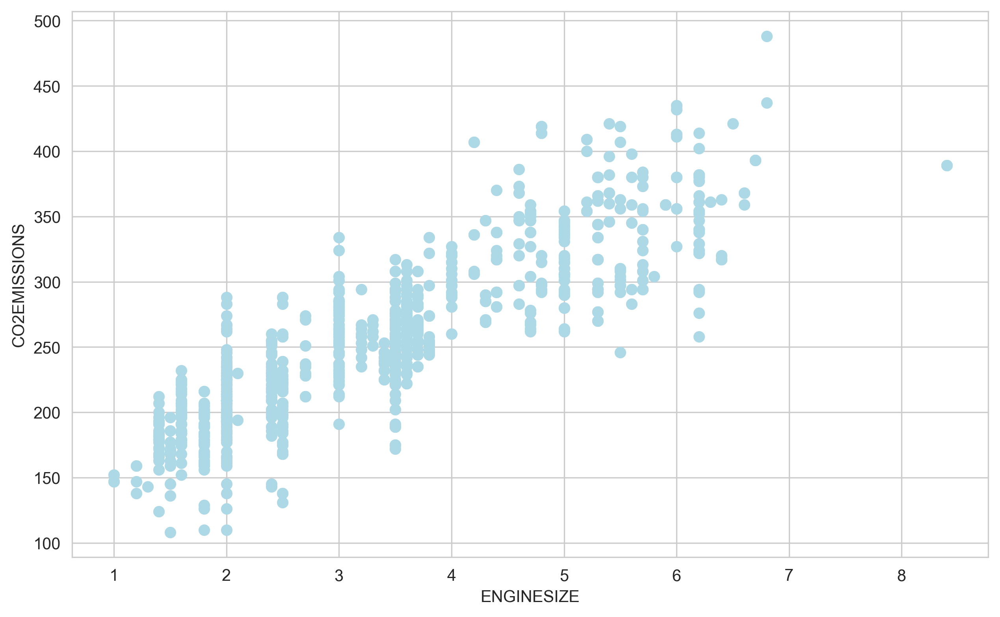

Coefficient: 38.992978724434074
Intercept: 126.28970217408721
Mean Squared Error: 985.9381692274999
Mean Absolute Error: 24.09725741170784
R^2 Score: 0.7615595731934373


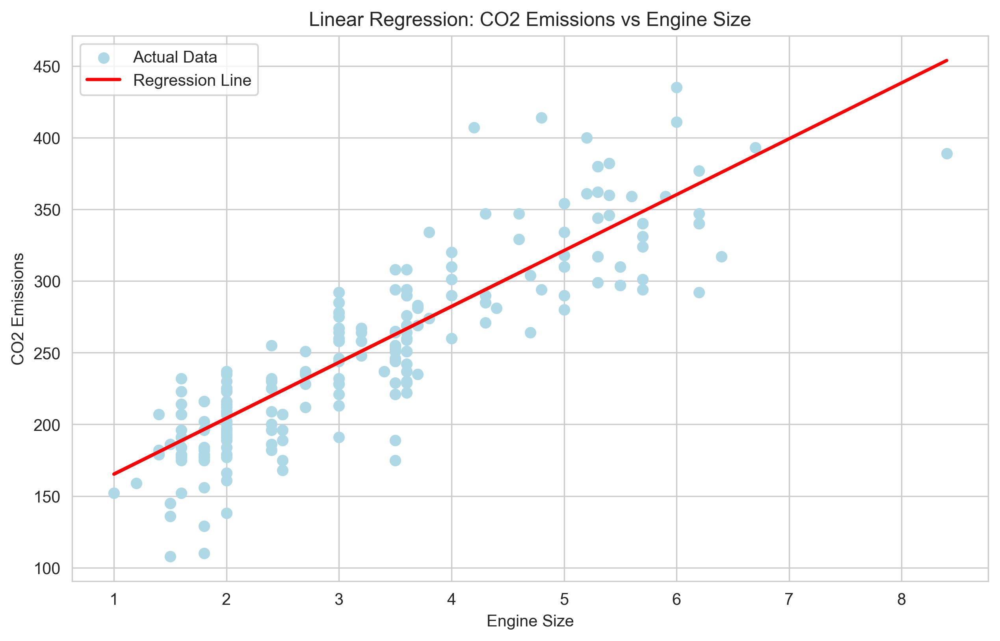

Predictions for new data: [223.77214899 243.26863835 262.76512771]


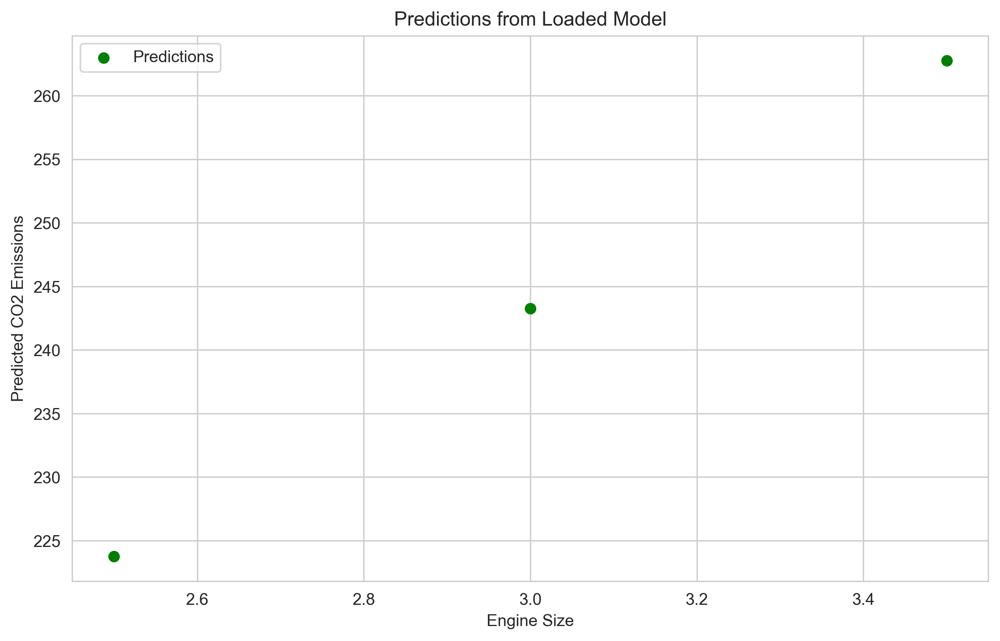

In [3]:
# Import the necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn import linear_model
import joblib


# Read the “FuelConsumptionCo2.CSV” file.
data = pd.read_csv('Datasets/FuelConsumptionCo2.csv')
display(data.head())

# Plot the data. The goal is to predict the value of “co2 emissions” from the value of “engine size” in the dataset.
plt.scatter(data['ENGINESIZE'] , data['CO2EMISSIONS'] , color='lightblue')
plt.xlabel('ENGINESIZE')
plt.ylabel('CO2EMISSIONS')
plt.show()

#Splitting the data into training and testing sets:
train_set, test_set = train_test_split(data, test_size=0.2, random_state=42)

#Training the linear regression model:
linear_regression_model = linear_model.LinearRegression()
X_train = train_set[['ENGINESIZE']]
y_train = train_set['CO2EMISSIONS']
linear_regression_model.fit(X_train, y_train)

#Printing the coefficient and intercept
print("Coefficient:", linear_regression_model.coef_[0])
print("Intercept:", linear_regression_model.intercept_)

# Making predictions on the test set
X_test = test_set[['ENGINESIZE']]
y_test = test_set['CO2EMISSIONS']
y_pred = linear_regression_model.predict(X_test)

# Evaluating the model
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
print("Mean Squared Error:", mse)
print("Mean Absolute Error:", mae)
print("R^2 Score:", r2)

# Visualizing the regression line
plt.scatter(X_test, y_test, color='lightblue', label='Actual Data')
plt.plot(X_test, y_pred, color='red', linewidth=2, label='Regression Line')
plt.xlabel('Engine Size')
plt.ylabel('CO2 Emissions')
plt.title('Linear Regression: CO2 Emissions vs Engine Size')
plt.legend()
plt.show()

# Saving the model for future use
joblib.dump(linear_regression_model, 'linear_regression_model.pkl')
""
# Loading the model for future use
loaded_model = joblib.load('linear_regression_model.pkl')

# Making predictions with the loaded model
new_data = pd.DataFrame({'ENGINESIZE': [2.5, 3.0, 3.5]})
predictions = loaded_model.predict(new_data)
print("Predictions for new data:", predictions)

# Visualizing the predictions
plt.scatter(new_data['ENGINESIZE'], predictions, color='green', label='Predictions')
plt.xlabel('Engine Size')
plt.ylabel('Predicted CO2 Emissions')
plt.title('Predictions from Loaded Model')
plt.legend()
plt.show()


## Multivariable linear regression model to predict the cars’ CO2 emission

Dataset shape: (1067, 13)

Features used for prediction:
1. ENGINESIZE
2. CYLINDERS
3. FUELCONSUMPTION_CITY
4. FUELCONSUMPTION_HWY
5. FUELCONSUMPTION_COMB
6. FUELCONSUMPTION_COMB_MPG

Missing values in features:
ENGINESIZE                  0
CYLINDERS                   0
FUELCONSUMPTION_CITY        0
FUELCONSUMPTION_HWY         0
FUELCONSUMPTION_COMB        0
FUELCONSUMPTION_COMB_MPG    0
CO2EMISSIONS                0
dtype: int64

Basic statistics of features:


,ENGINESIZE,CYLINDERS,FUELCONSUMPTION_CITY,FUELCONSUMPTION_HWY,FUELCONSUMPTION_COMB,FUELCONSUMPTION_COMB_MPG,CO2EMISSIONS
count,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000
mean,3.346298,5.794752,13.296532,9.474602,11.580881,26.441425,256.228679
std,1.415895,1.797447,4.101253,2.794510,3.485595,7.468702,63.372304
min,1.000000,3.000000,4.600000,4.900000,4.700000,11.000000,108.000000
25%,2.000000,4.000000,10.250000,7.500000,9.000000,21.000000,207.000000
50%,3.400000,6.000000,12.600000,8.800000,10.900000,26.000000,251.000000
75%,4.300000,8.000000,15.550000,10.850000,13.350000,31.000000,294.000000
max,8.400000,12.000000,30.200000,20.500000,25.800000,60.000000,488.000000


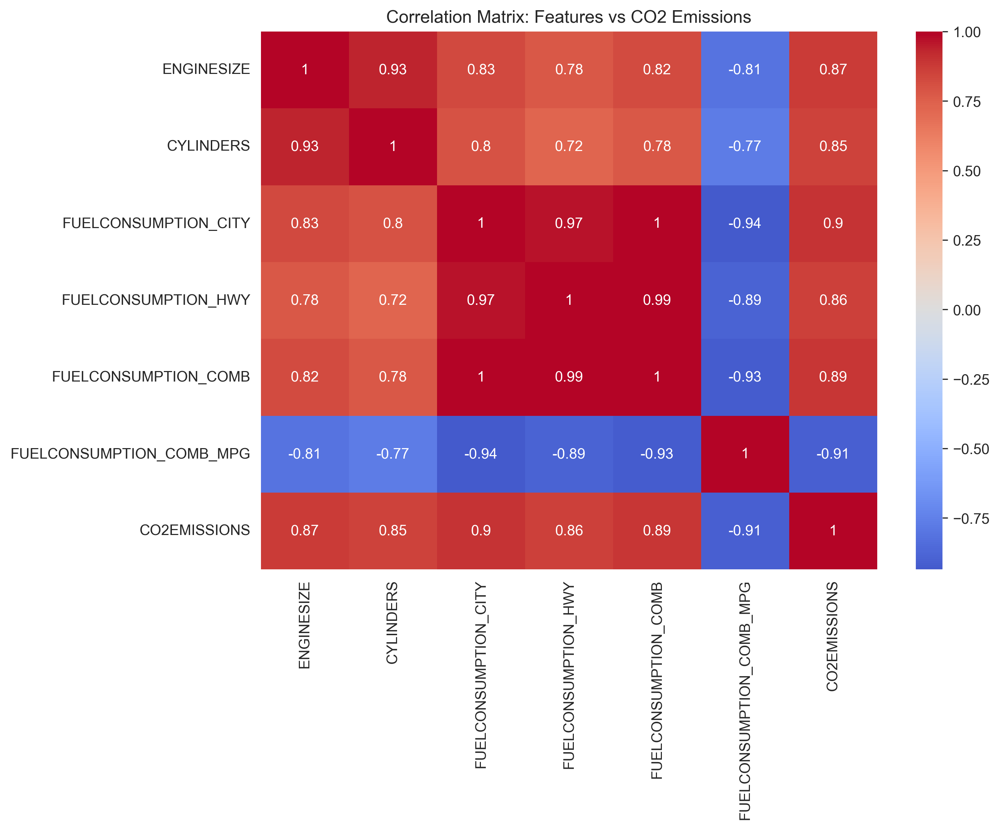


Training set size: 853 samples
Test set size: 214 samples

MULTIVARIABLE LINEAR REGRESSION MODEL RESULTS
Intercept: 262.5722

Coefficients:
  ENGINESIZE: 8.9612
  CYLINDERS: 7.2402
  FUELCONSUMPTION_CITY: -13.0016
  FUELCONSUMPTION_HWY: -5.4722
  FUELCONSUMPTION_COMB: 21.8670
  FUELCONSUMPTION_COMB_MPG: -4.0345

Model Performance Metrics:
Mean Squared Error: 399.4187
Mean Absolute Error: 12.9014
R² Score: 0.9034
Explained Variance: 90.34%

COMPARISON WITH SINGLE VARIABLE MODEL
Single Variable R² Score: 0.7616 (76.16%)
Multi Variable R² Score: 0.9034 (90.34%)
Improvement: 14.18 percentage points


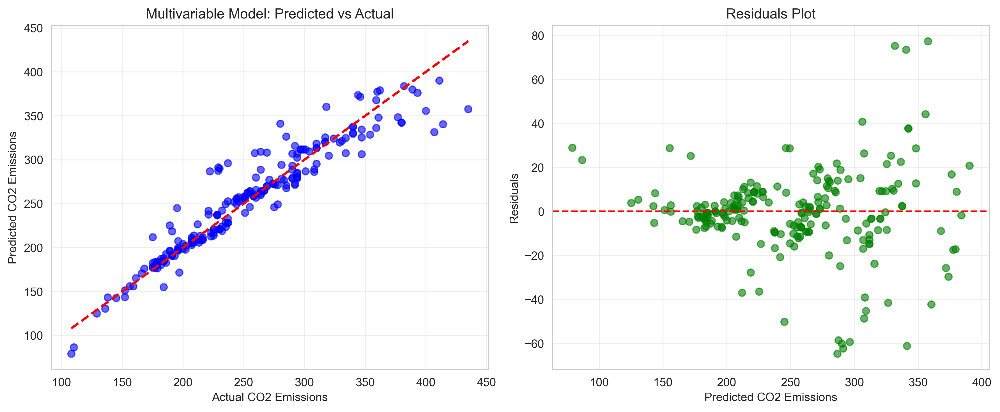

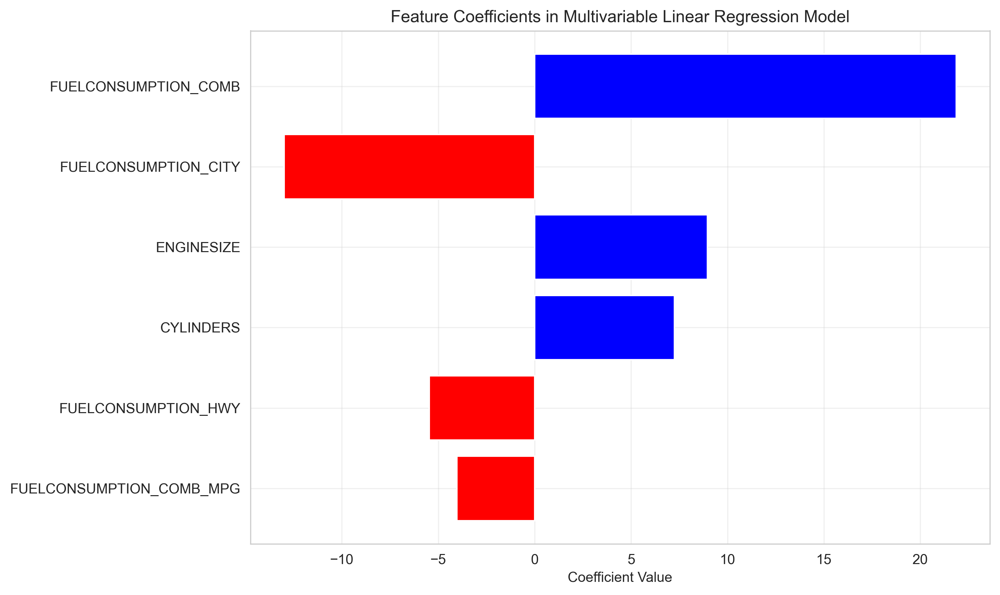


Model saved as 'multivariable_linear_regression_model.pkl'

EXAMPLE PREDICTIONS WITH NEW DATA
Sample car configurations and predicted CO2 emissions:

Car 1:
  Engine Size: 2.0 L
  Cylinders: 4.0
  Fuel Consumption (City/Highway/Combined): 8.5/6.0/7.5 L/100km
  Combined MPG: 38.0
  Predicted CO2 Emissions: 176.80 g/km

Car 2:
  Engine Size: 3.5 L
  Cylinders: 6.0
  Fuel Consumption (City/Highway/Combined): 12.0/8.5/10.5 L/100km
  Combined MPG: 27.0
  Predicted CO2 Emissions: 255.52 g/km

Car 3:
  Engine Size: 5.0 L
  Cylinders: 8.0
  Fuel Consumption (City/Highway/Combined): 15.5/11.0/13.5 L/100km
  Combined MPG: 21.0
  Predicted CO2 Emissions: 314.06 g/km



In [4]:
# Multivariable Linear Regression Model for CO2 Emissions Prediction

# Define the features for multivariable regression
features = ['ENGINESIZE', 'CYLINDERS', 'FUELCONSUMPTION_CITY', 
           'FUELCONSUMPTION_HWY', 'FUELCONSUMPTION_COMB', 'FUELCONSUMPTION_COMB_MPG']

print("Dataset shape:", data.shape)
print("\nFeatures used for prediction:")
for i, feature in enumerate(features, 1):
    print(f"{i}. {feature}")

# Check for missing values in our features
print("\nMissing values in features:")
print(data[features + ['CO2EMISSIONS']].isnull().sum())

# Display basic statistics of the features
print("\nBasic statistics of features:")
display(data[features + ['CO2EMISSIONS']].describe())

# Create correlation matrix to understand relationships
correlation_matrix = data[features + ['CO2EMISSIONS']].corr()
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0)
plt.title('Correlation Matrix: Features vs CO2 Emissions')
plt.tight_layout()
plt.show()

# Split data into training and testing sets
X = data[features]
y = data['CO2EMISSIONS']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print(f"\nTraining set size: {X_train.shape[0]} samples")
print(f"Test set size: {X_test.shape[0]} samples")

# Create and train the multivariable linear regression model
multi_lr_model = LinearRegression()
multi_lr_model.fit(X_train, y_train)

# Display model coefficients and intercept
print("\n" + "="*50)
print("MULTIVARIABLE LINEAR REGRESSION MODEL RESULTS")
print("="*50)
print(f"Intercept: {multi_lr_model.intercept_:.4f}")
print("\nCoefficients:")
for feature, coef in zip(features, multi_lr_model.coef_):
    print(f"  {feature}: {coef:.4f}")

# Make predictions on test set
y_pred_multi = multi_lr_model.predict(X_test)

# Evaluate the multivariable model
mse_multi = mean_squared_error(y_test, y_pred_multi)
mae_multi = mean_absolute_error(y_test, y_pred_multi)
r2_multi = r2_score(y_test, y_pred_multi)

print(f"\nModel Performance Metrics:")
print(f"Mean Squared Error: {mse_multi:.4f}")
print(f"Mean Absolute Error: {mae_multi:.4f}")
print(f"R² Score: {r2_multi:.4f}")
print(f"Explained Variance: {r2_multi*100:.2f}%")

# Compare with single variable model (from previous cell)
print(f"\n" + "="*50)
print("COMPARISON WITH SINGLE VARIABLE MODEL")
print("="*50)
print(f"Single Variable R² Score: {r2:.4f} ({r2*100:.2f}%)")
print(f"Multi Variable R² Score: {r2_multi:.4f} ({r2_multi*100:.2f}%)")
print(f"Improvement: {(r2_multi-r2)*100:.2f} percentage points")

# Visualize predictions vs actual values
plt.figure(figsize=(12, 5))

# Subplot 1: Predicted vs Actual
plt.subplot(1, 2, 1)
plt.scatter(y_test, y_pred_multi, alpha=0.6, color='blue')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', linewidth=2)
plt.xlabel('Actual CO2 Emissions')
plt.ylabel('Predicted CO2 Emissions')
plt.title('Multivariable Model: Predicted vs Actual')
plt.grid(True, alpha=0.3)

# Subplot 2: Residuals plot
plt.subplot(1, 2, 2)
residuals = y_test - y_pred_multi
plt.scatter(y_pred_multi, residuals, alpha=0.6, color='green')
plt.axhline(y=0, color='red', linestyle='--')
plt.xlabel('Predicted CO2 Emissions')
plt.ylabel('Residuals')
plt.title('Residuals Plot')
plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# Feature importance visualization (absolute values of coefficients)
plt.figure(figsize=(10, 6))
feature_importance = pd.DataFrame({
    'Feature': features,
    'Coefficient': multi_lr_model.coef_,
    'Abs_Coefficient': np.abs(multi_lr_model.coef_)
}).sort_values('Abs_Coefficient', ascending=True)

plt.barh(feature_importance['Feature'], feature_importance['Coefficient'], 
         color=['red' if x < 0 else 'blue' for x in feature_importance['Coefficient']])
plt.xlabel('Coefficient Value')
plt.title('Feature Coefficients in Multivariable Linear Regression Model')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# Save the multivariable model
joblib.dump(multi_lr_model, 'multivariable_linear_regression_model.pkl')
print(f"\nModel saved as 'multivariable_linear_regression_model.pkl'")

# Example predictions with new data
print(f"\n" + "="*50)
print("EXAMPLE PREDICTIONS WITH NEW DATA")
print("="*50)

# Create sample data for prediction
sample_data = pd.DataFrame({
    'ENGINESIZE': [2.0, 3.5, 5.0],
    'CYLINDERS': [4, 6, 8],
    'FUELCONSUMPTION_CITY': [8.5, 12.0, 15.5],
    'FUELCONSUMPTION_HWY': [6.0, 8.5, 11.0],
    'FUELCONSUMPTION_COMB': [7.5, 10.5, 13.5],
    'FUELCONSUMPTION_COMB_MPG': [38, 27, 21]
})

sample_predictions = multi_lr_model.predict(sample_data)

print("Sample car configurations and predicted CO2 emissions:")
for i in range(len(sample_data)):
    print(f"\nCar {i+1}:")
    print(f"  Engine Size: {sample_data.iloc[i]['ENGINESIZE']} L")
    print(f"  Cylinders: {sample_data.iloc[i]['CYLINDERS']}")
    print(f"  Fuel Consumption (City/Highway/Combined): {sample_data.iloc[i]['FUELCONSUMPTION_CITY']}/{sample_data.iloc[i]['FUELCONSUMPTION_HWY']}/{sample_data.iloc[i]['FUELCONSUMPTION_COMB']} L/100km")
    print(f"  Combined MPG: {sample_data.iloc[i]['FUELCONSUMPTION_COMB_MPG']}")
    print(f"  Predicted CO2 Emissions: {sample_predictions[i]:.2f} g/km")

print(f"\n" + "="*50)

The notebook first builds a simple linear regression (engine size → CO2 emissions), then builds a multivariable linear regression using 6 features: engine size, cylinders, city/highway/combined fuel consumption, and combined MPG. The goal is predicting a car's CO2 emissions.
The data is split 80/20 into 853 training and 214 test samples, and a LinearRegression model is fit on the training set.

The model equation is essentially:

CO2 = 262.57 + 8.96×EngineSize + 7.24×Cylinders − 13.00×FuelCity − 5.47×FuelHwy + 21.87×FuelComb − 4.03×CombMPG

The intercept (262.57) is the baseline prediction when all features are zero. Each coefficient tells you how much CO2 changes per one-unit increase in that feature, holding others constant. Positive coefficients (engine size, cylinders, combined fuel consumption) push emissions up; negative ones (city fuel, highway fuel, MPG) push them down.

Some coefficients seem counterintuitive (e.g., city fuel consumption being negative). This is due to multicollinearity — the fuel consumption features are highly correlated with each other, so the model splits their effects in unexpected ways. The combined fuel consumption feature absorbs most of the positive effect, making the individual city/highway ones appear negative.

1. Correlation Heatmap — Shows pairwise Pearson correlations between all features and CO2 emissions. Values near +1 or −1 indicate strong linear relationships. You'd see that fuel consumption features are highly correlated with each other (the multicollinearity issue) and that most features are strongly correlated with CO2 emissions, justifying their use.

2. Predicted vs Actual scatter plot (left) — Each dot is a test sample. The x-axis is the true CO2 value, the y-axis is the predicted value. The red dashed line is the "perfect prediction" line (y = x). The closer the dots cluster around this line, the better the model. Here they're quite tight around the line, confirming the 90% R².

3. Residuals plot (right) — Residuals = actual − predicted. Each dot shows the error for a test sample, plotted against the predicted value. The red line at y=0 represents zero error. Ideally, residuals should be randomly scattered around zero with no pattern. If you see a funnel shape or curve, it suggests the model has systematic issues (heteroscedasticity or non-linearity). A roughly even spread here means the linear model is a reasonable fit.

4. Feature Coefficients bar chart — A horizontal bar chart showing each feature's coefficient. Blue bars are positive (increase CO2), red bars are negative (decrease CO2). The length shows the magnitude of influence. This helps you see at a glance which features the model relies on most — combined fuel consumption has the largest positive coefficient (21.87), meaning it's the dominant predictor.

### Linear Regression with Fake (Synthetic) Data

Linear Regression Demonstration
Dataset: 50 students
Feature: Hours studied (0-10)
Target: Exam score (with noise)
True relationship: Score = 50 + 5 × Hours + noise

Model Results:
Fitted equation: y = 50.48 + 4.89x
True equation:   y = 50.00 + 5.00x
MSE: 20.577
RMSE: 4.536
R²: 0.905


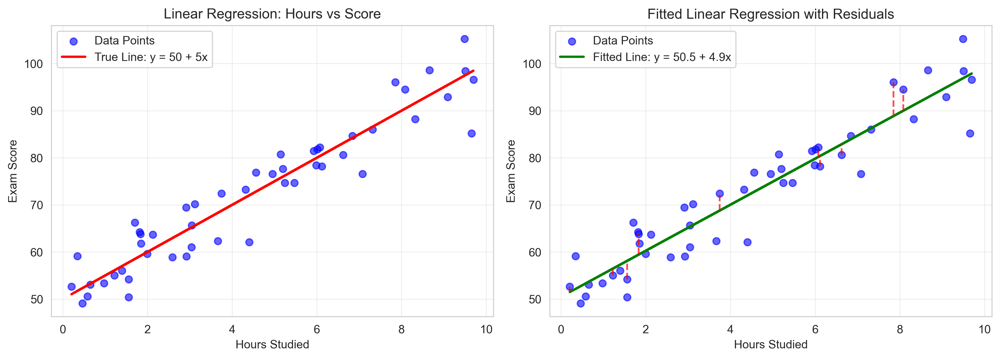

In [5]:
# Demonstrate linear regression with synthetic data
print("Linear Regression Demonstration")
print("=" * 40)

# Create simple synthetic dataset: Hours studied vs. Exam score
np.random.seed(42)
n_samples = 50
X_simple = np.random.rand(n_samples, 1) * 10  # Hours (0-10)
noise = np.random.randn(n_samples, 1) * 5
y_simple = 50 + 5 * X_simple + noise  # Score = 50 + 5*hours + noise

print(f"Dataset: {n_samples} students")
print(f"Feature: Hours studied (0-10)")
print(f"Target: Exam score (with noise)")
print(f"True relationship: Score = 50 + 5 × Hours + noise")

# Visualize the data
plt.figure(figsize=(12, 8))

# Plot 1: Raw data with true relationship
plt.subplot(2, 2, 1)
plt.scatter(X_simple, y_simple, color='blue', alpha=0.6, label='Data Points')
plt.plot(X_simple, 50 + 5 * X_simple, color='red', label='True Line: y = 50 + 5x', linewidth=2)
plt.xlabel('Hours Studied')
plt.ylabel('Exam Score')
plt.title('Linear Regression: Hours vs Score')
plt.legend()
plt.grid(True, alpha=0.3)

# Fit linear regression model
model_simple = LinearRegression()
model_simple.fit(X_simple, y_simple)
y_pred_simple = model_simple.predict(X_simple)

# Plot 2: Fitted line with residuals
plt.subplot(2, 2, 2)
plt.scatter(X_simple, y_simple, color='blue', alpha=0.6, label='Data Points')
plt.plot(X_simple, y_pred_simple, color='green', label=f'Fitted Line: y = {model_simple.intercept_[0]:.1f} + {model_simple.coef_[0][0]:.1f}x', linewidth=2)

# Show residuals
for i in range(0, n_samples, 5):  # Show every 5th residual for clarity
    plt.vlines(X_simple[i], min(y_simple[i], y_pred_simple[i]), max(y_simple[i], y_pred_simple[i]), 
              color='red', linestyle='--', alpha=0.7)

plt.xlabel('Hours Studied')
plt.ylabel('Exam Score')
plt.title('Fitted Linear Regression with Residuals')
plt.legend()
plt.grid(True, alpha=0.3)

# Calculate and display metrics
mse = mean_squared_error(y_simple, y_pred_simple)
rmse = np.sqrt(mse)
r2 = r2_score(y_simple, y_pred_simple)

print(f"\nModel Results:")
print(f"Fitted equation: y = {model_simple.intercept_[0]:.2f} + {model_simple.coef_[0][0]:.2f}x")
print(f"True equation:   y = 50.00 + 5.00x")
print(f"MSE: {mse:.3f}")
print(f"RMSE: {rmse:.3f}")
print(f"R²: {r2:.3f}")

# # Plot 3: Residual analysis
# residuals = y_simple.flatten() - y_pred_simple.flatten()
# plt.subplot(2, 2, 3)
# plt.scatter(y_pred_simple, residuals, color='orange', alpha=0.6)
# plt.axhline(y=0, color='black', linestyle='--', alpha=0.8)
# plt.xlabel('Predicted Values')
# plt.ylabel('Residuals')
# plt.title('Residual Plot')
# plt.grid(True, alpha=0.3)

# # Plot 4: Q-Q plot for residuals
# plt.subplot(2, 2, 4)
# stats.probplot(residuals, dist="norm", plot=plt)
# plt.title('Q-Q Plot of Residuals')
# plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()


## Linear Regression Assumptions

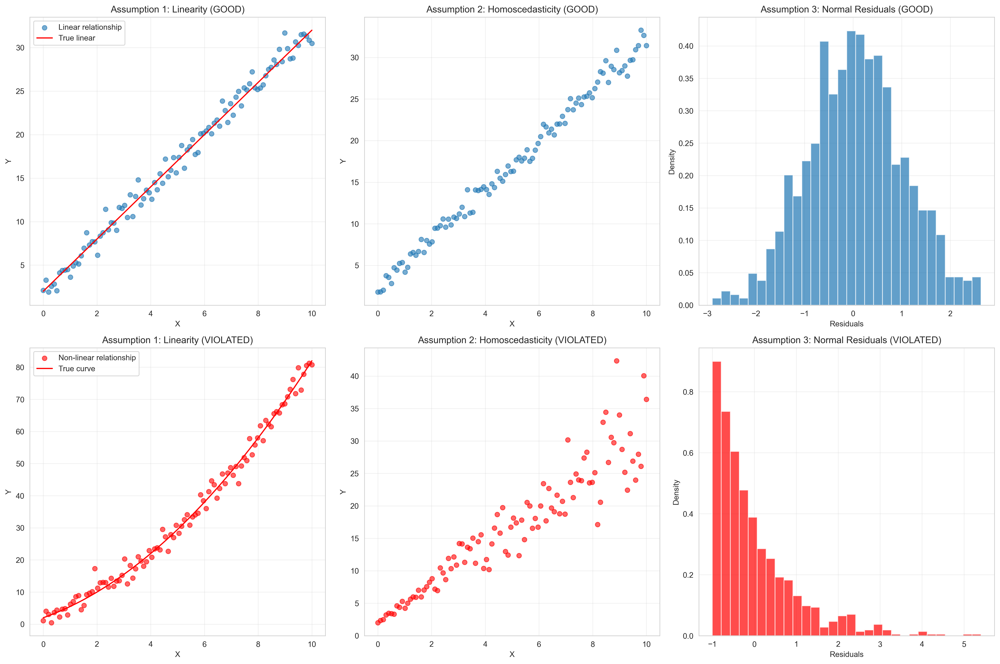


Linear Regression Assumptions:
            Assumption                                        Description                Violation Example                        Check Method
             Linearity Relationship between features and target is linear Curved data (exponential growth) Scatter plots of features vs target
          Independence                       Observations are independent Time-series with autocorrelation                  Durbin-Watson test
      Homoscedasticity                     Constant variance of residuals                Fanning residuals       Plot residuals vs predictions
Normality of Residuals                    Errors are normally distributed                    Skewed errors       Q-Q plot or Shapiro-Wilk test
  No Multicollinearity                 Features are not highly correlated          Height in cm and inches     Variance Inflation Factor (VIF)


In [6]:
# Create examples showing violations of linear regression assumptions
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

# Assumption 1: Linearity
x_lin = np.linspace(0, 10, 100)
y_linear = 2 + 3 * x_lin + np.random.normal(0, 1, 100)
y_nonlinear = 2 + 3 * x_lin + 0.5 * x_lin**2 + np.random.normal(0, 2, 100)

axes[0, 0].scatter(x_lin, y_linear, alpha=0.6, label='Linear relationship')
axes[0, 0].plot(x_lin, 2 + 3 * x_lin, 'r-', label='True linear')
axes[0, 0].set_title('Assumption 1: Linearity (GOOD)')
axes[0, 0].set_xlabel('X')
axes[0, 0].set_ylabel('Y')
axes[0, 0].legend()
axes[0, 0].grid(True, alpha=0.3)

axes[1, 0].scatter(x_lin, y_nonlinear, alpha=0.6, color='red', label='Non-linear relationship')
axes[1, 0].plot(x_lin, 2 + 3 * x_lin + 0.5 * x_lin**2, 'r-', label='True curve')
axes[1, 0].set_title('Assumption 1: Linearity (VIOLATED)')
axes[1, 0].set_xlabel('X')
axes[1, 0].set_ylabel('Y')
axes[1, 0].legend()
axes[1, 0].grid(True, alpha=0.3)

# Assumption 2: Homoscedasticity (constant variance)
x_homo = np.linspace(0, 10, 100)
y_homo = 2 + 3 * x_homo + np.random.normal(0, 1, 100)  # Constant variance
y_hetero = 2 + 3 * x_homo + np.random.normal(0, x_homo * 0.5, 100)  # Increasing variance

axes[0, 1].scatter(x_homo, y_homo, alpha=0.6)
axes[0, 1].set_title('Assumption 2: Homoscedasticity (GOOD)')
axes[0, 1].set_xlabel('X')
axes[0, 1].set_ylabel('Y')
axes[0, 1].grid(True, alpha=0.3)

axes[1, 1].scatter(x_homo, y_hetero, alpha=0.6, color='red')
axes[1, 1].set_title('Assumption 2: Homoscedasticity (VIOLATED)')
axes[1, 1].set_xlabel('X')
axes[1, 1].set_ylabel('Y')
axes[1, 1].grid(True, alpha=0.3)

# Assumption 3: Normality of residuals
normal_residuals = np.random.normal(0, 1, 1000)
skewed_residuals = np.random.exponential(1, 1000) - 1

axes[0, 2].hist(normal_residuals, bins=30, alpha=0.7, density=True)
axes[0, 2].set_title('Assumption 3: Normal Residuals (GOOD)')
axes[0, 2].set_xlabel('Residuals')
axes[0, 2].set_ylabel('Density')
axes[0, 2].grid(True, alpha=0.3)

axes[1, 2].hist(skewed_residuals, bins=30, alpha=0.7, color='red', density=True)
axes[1, 2].set_title('Assumption 3: Normal Residuals (VIOLATED)')
axes[1, 2].set_xlabel('Residuals')
axes[1, 2].set_ylabel('Density')
axes[1, 2].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# Display assumptions table
assumptions_data = {
    'Assumption': ['Linearity', 'Independence', 'Homoscedasticity', 'Normality of Residuals', 'No Multicollinearity'],
    'Description': [
        'Relationship between features and target is linear',
        'Observations are independent',
        'Constant variance of residuals',
        'Errors are normally distributed',
        'Features are not highly correlated'
    ],
    'Violation Example': [
        'Curved data (exponential growth)',
        'Time-series with autocorrelation',
        'Fanning residuals',
        'Skewed errors',
        'Height in cm and inches'
    ],
    'Check Method': [
        'Scatter plots of features vs target',
        'Durbin-Watson test',
        'Plot residuals vs predictions',
        'Q-Q plot or Shapiro-Wilk test',
        'Variance Inflation Factor (VIF)'
    ]
}

assumptions_df = pd.DataFrame(assumptions_data)
print("\nLinear Regression Assumptions:")
print(assumptions_df.to_string(index=False))

### Comprehensive Analysis

CO2 Emission Prediction Analysis
Dataset Shape: (1067, 13)

Column Names:
['MODELYEAR', 'MAKE', 'MODEL', 'VEHICLECLASS', 'ENGINESIZE', 'CYLINDERS', 'TRANSMISSION', 'FUELTYPE', 'FUELCONSUMPTION_CITY', 'FUELCONSUMPTION_HWY', 'FUELCONSUMPTION_COMB', 'FUELCONSUMPTION_COMB_MPG', 'CO2EMISSIONS']

EXPLORATORY DATA ANALYSIS

Dataset Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1067 entries, 0 to 1066
Data columns (total 13 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   MODELYEAR                 1067 non-null   int64  
 1   MAKE                      1067 non-null   object 
 2   MODEL                     1067 non-null   object 
 3   VEHICLECLASS              1067 non-null   object 
 4   ENGINESIZE                1067 non-null   float64
 5   CYLINDERS                 1067 non-null   int64  
 6   TRANSMISSION              1067 non-null   object 
 7   FUELTYPE                  1067 non-null   object 
 8   FUELC

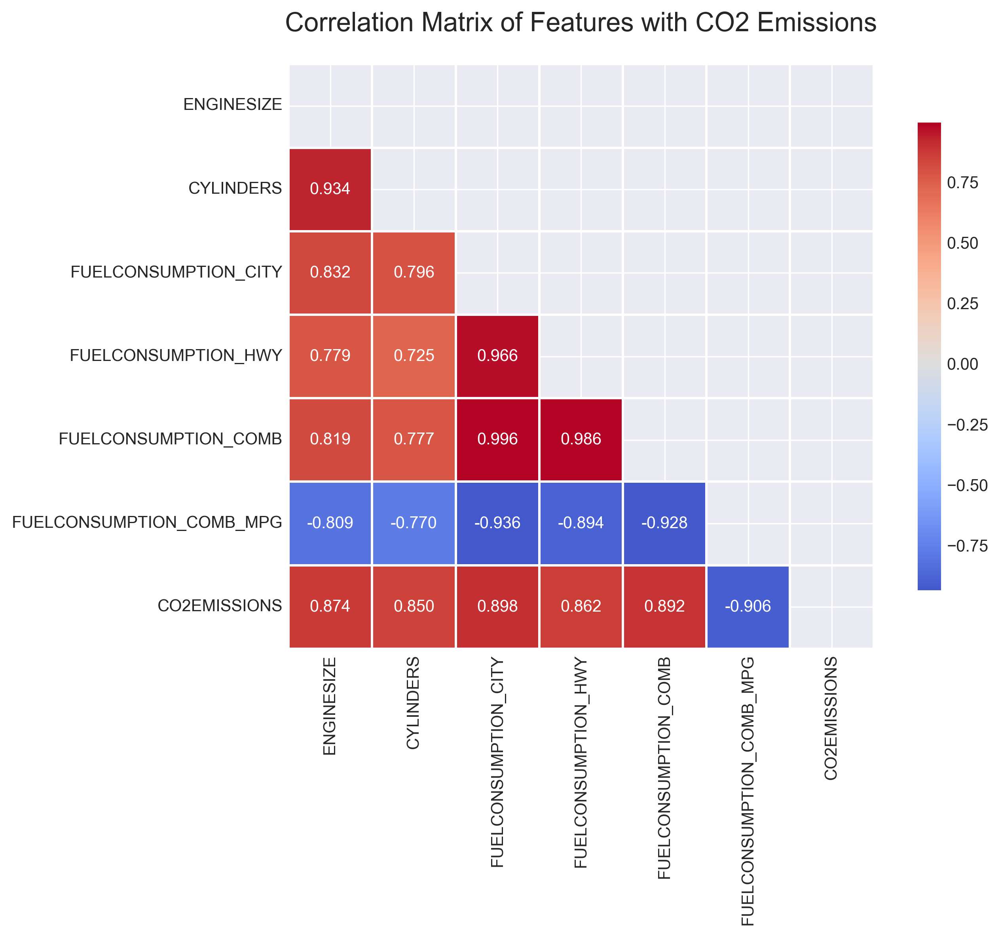

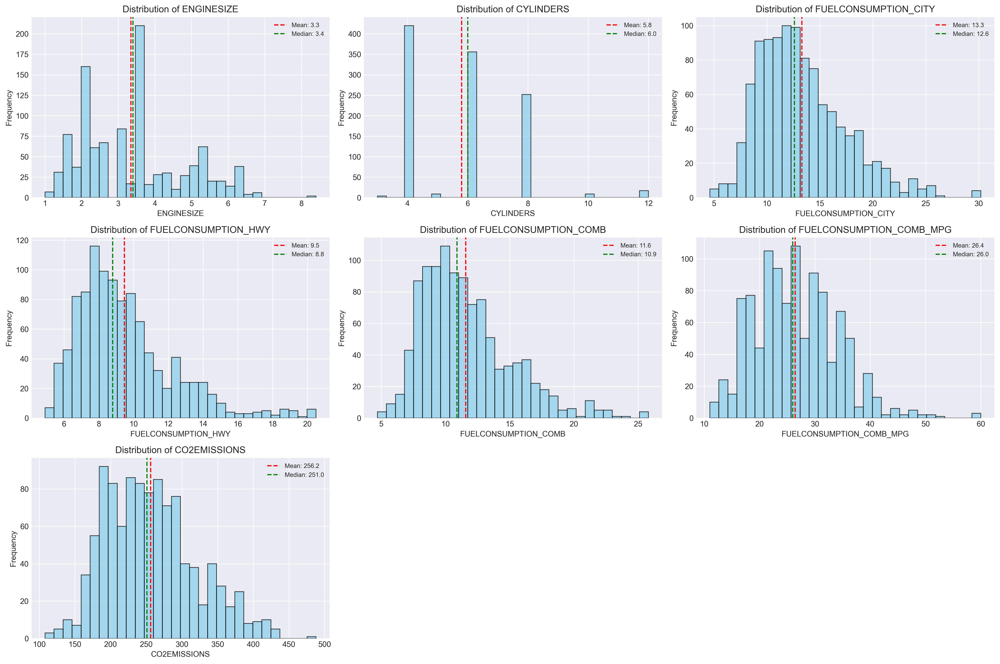

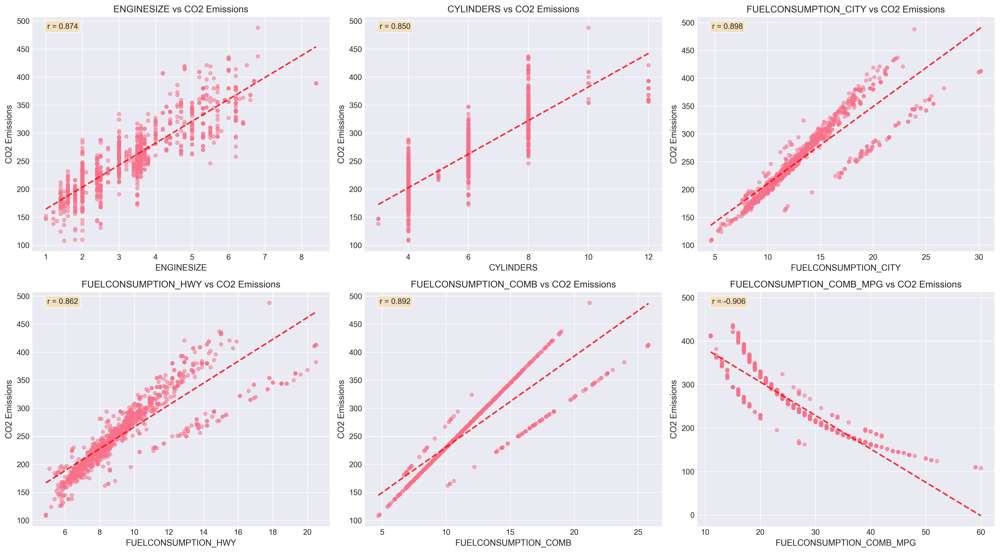

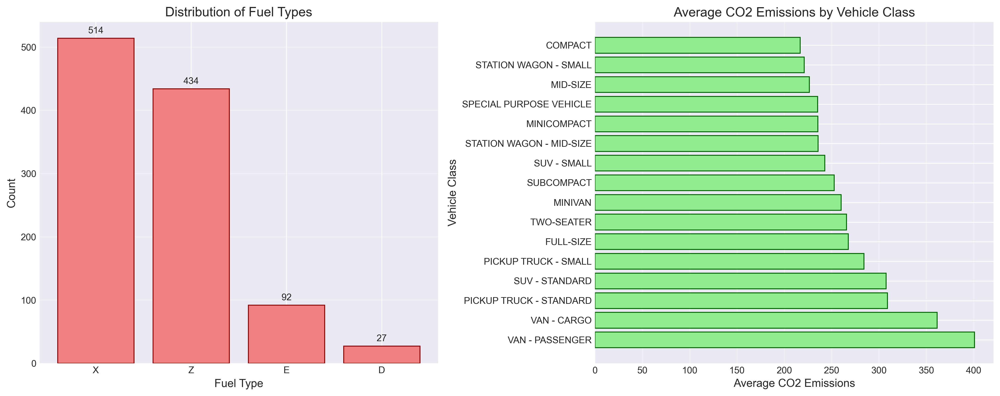


MULTICOLLINEARITY ANALYSIS

Variance Inflation Factor (VIF):
                    Feature            VIF
4      FUELCONSUMPTION_COMB  178454.763423
2      FUELCONSUMPTION_CITY   71486.642528
3       FUELCONSUMPTION_HWY   24474.594241
1                 CYLINDERS      94.733032
0                ENGINESIZE      63.279432
5  FUELCONSUMPTION_COMB_MPG       6.504910

Note: VIF > 10 indicates multicollinearity

DATA PREPARATION

Training set size: (853, 6)
Test set size: (214, 6)

MODEL IMPLEMENTATION AND COMPARISON

1. Ordinary Least Squares (OLS) Linear Regression
Test R² Score: 0.9034
Test RMSE: 19.99

2. Ridge Regression (L2 regularization)
Test R² Score: 0.9036
Test RMSE: 19.97

3. Lasso Regression (L1 regularization)
Test R² Score: 0.9035
Test RMSE: 19.97

4. ElasticNet (L1 + L2 regularization)
Test R² Score: 0.9032
Test RMSE: 20.01

RESULTS COMPARISON

Model Performance Summary:
                   Model  Train R²   Test R²  Test RMSE   Test MAE
0  OLS Linear Regression  0.885360  0.903

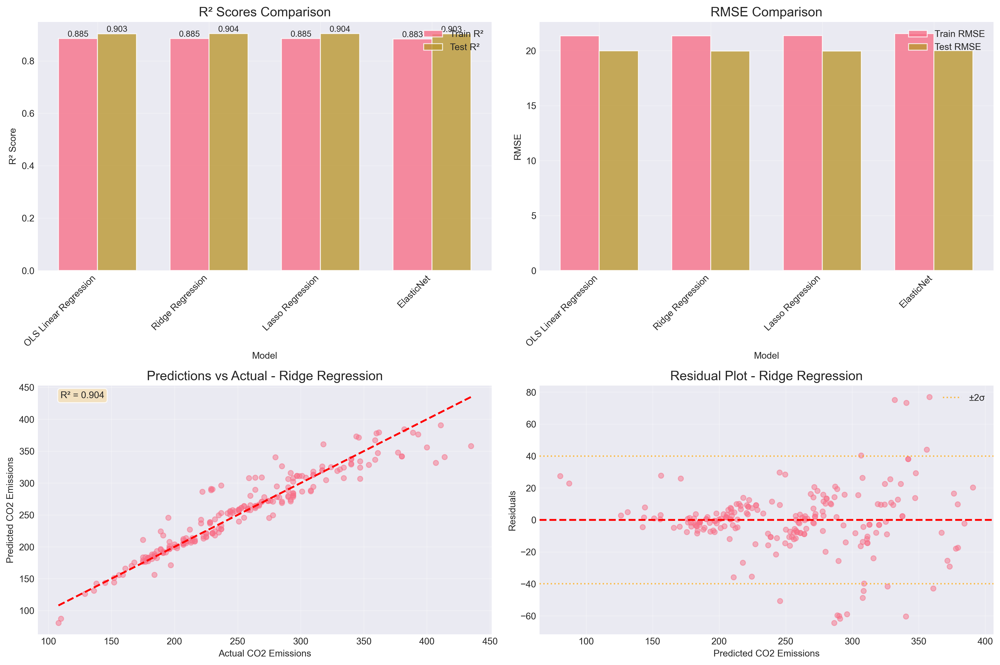


FEATURE IMPORTANCE ANALYSIS

OLS Linear Regression Coefficients:
                    Feature  Coefficient  Abs_Coefficient
4      FUELCONSUMPTION_COMB    75.869225        75.869225
2      FUELCONSUMPTION_CITY   -53.040093        53.040093
5  FUELCONSUMPTION_COMB_MPG   -29.448438        29.448438
3       FUELCONSUMPTION_HWY   -15.249028        15.249028
1                 CYLINDERS    13.129589        13.129589
0                ENGINESIZE    12.669963        12.669963

Lasso Feature Selection:
                    Feature  Coefficient  Selected
5  FUELCONSUMPTION_COMB_MPG   -28.311920      True
0                ENGINESIZE    12.646395      True
1                 CYLINDERS    12.524233      True
3       FUELCONSUMPTION_HWY     9.707594      True
2      FUELCONSUMPTION_CITY    -0.000000     False
4      FUELCONSUMPTION_COMB     0.000000     False


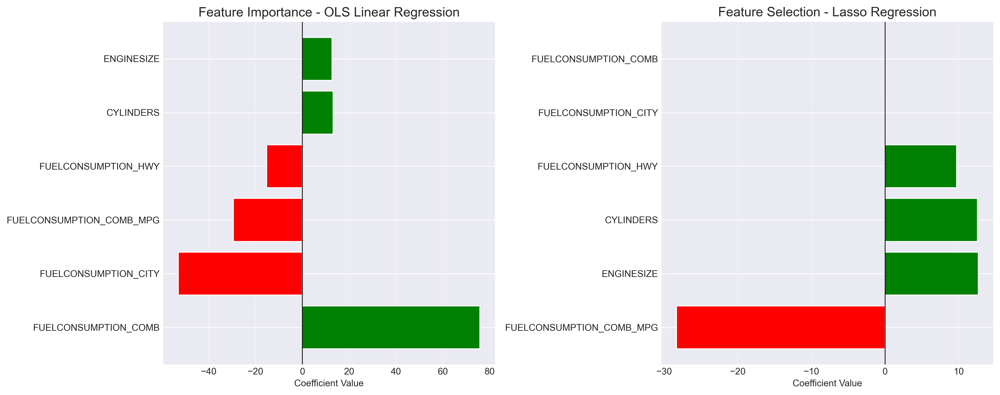


STATISTICAL ANALYSIS

Normality Test (D'Agostino-Pearson):
p-value: 0.0000
Residuals are not normally distributed


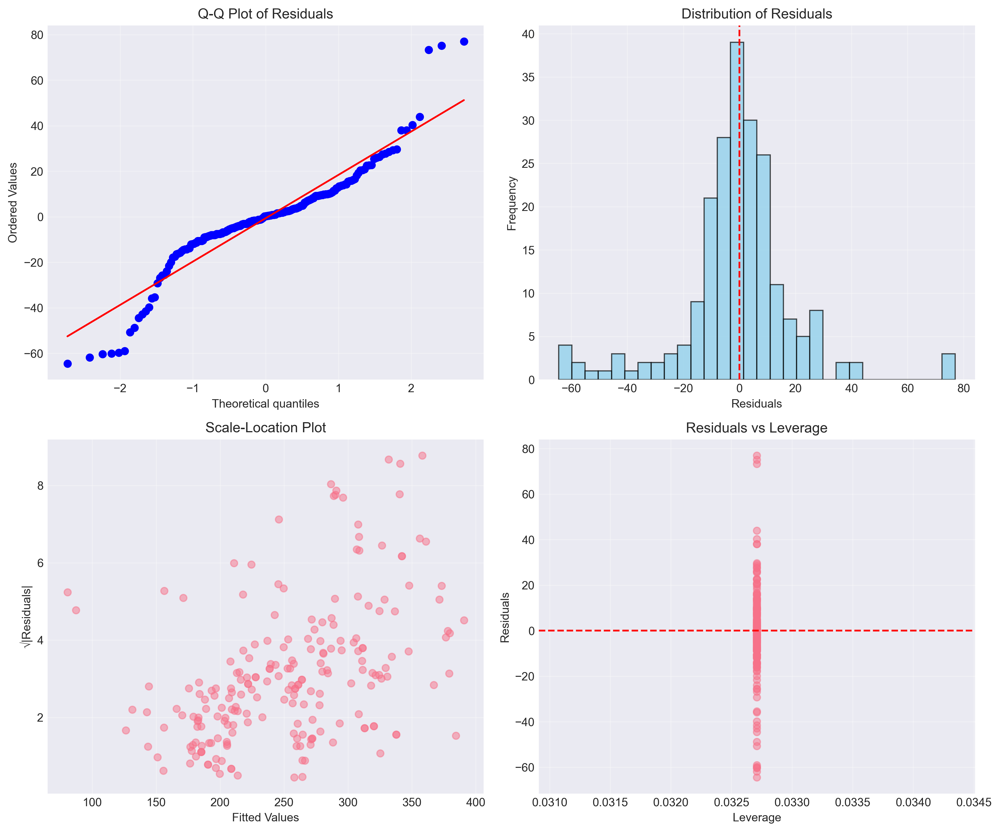


PREDICTION ANALYSIS

Prediction Error Statistics:
Mean Absolute Error: 12.92
Standard Deviation of Errors: 15.23
95% of predictions are within ±29.84 of actual values

Sample Predictions:
   Actual   Predicted      Error
0     317  326.009186   9.009186
1     209  205.736832   3.263168
2     244  256.091515  12.091515
3     290  288.179186   1.820814
4     310  312.954194   2.954194
5     191  190.388572   0.611428
6     209  208.554660   0.445340
7     294  307.788833  13.788833
8     202  201.231280   0.768720
9     212  209.417855   2.582145

ALTERNATIVE ANALYSIS - REDUCED FEATURES

Reduced Features Model Performance:
Features used: ['ENGINESIZE', 'CYLINDERS', 'FUELCONSUMPTION_COMB']
Test R² Score: 0.8760
Test RMSE: 22.65

COMPREHENSIVE ANALYSIS SUMMARY

CO2 EMISSION PREDICTION ANALYSIS SUMMARY

1. DATASET OVERVIEW:
   - Total samples: 1067
   - Features used: 6 (ENGINESIZE, CYLINDERS, FUELCONSUMPTION_CITY, FUELCONSUMPTION_HWY, FUELCONSUMPTION_COMB, FUELCONSUMPTION_COMB_MPG)
   - T

In [9]:
# Set style for better visualizations
plt.style.use('seaborn-v0_8-darkgrid')
sns.set_palette("husl")

# Load the dataset
df = pd.read_csv('Datasets/FuelConsumptionCo2.csv')
print("CO2 Emission Prediction Analysis")
print("="*60)
print(f"Dataset Shape: {df.shape}")
print(f"\nColumn Names:\n{df.columns.tolist()}")

# 1. EXPLORATORY DATA ANALYSIS
print("\n" + "="*60)
print("EXPLORATORY DATA ANALYSIS")
print("="*60)

# Basic information
print("\nDataset Info:")
print(df.info())

print("\nFirst 5 rows:")
print(df.head())

# Descriptive statistics
print("\nDescriptive Statistics:")
print(df.describe())

# Check for missing values
print("\nMissing Values:")
print(df.isnull().sum())

# Define features for prediction as specified
feature_cols = ['ENGINESIZE', 'CYLINDERS', 'FUELCONSUMPTION_CITY', 
                'FUELCONSUMPTION_HWY', 'FUELCONSUMPTION_COMB', 'FUELCONSUMPTION_COMB_MPG']
target_col = 'CO2EMISSIONS'

# Correlation analysis
plt.figure(figsize=(10, 8))
correlation_matrix = df[feature_cols + [target_col]].corr()
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))
sns.heatmap(correlation_matrix, mask=mask, annot=True, cmap='coolwarm', center=0, 
            square=True, linewidths=1, cbar_kws={"shrink": .8}, fmt='.3f')
plt.title('Correlation Matrix of Features with CO2 Emissions', fontsize=16, pad=20)
plt.tight_layout()
plt.show()

# Distribution plots for numerical features
fig, axes = plt.subplots(3, 3, figsize=(18, 12))
axes = axes.ravel()

for idx, col in enumerate(feature_cols + [target_col]):
    axes[idx].hist(df[col], bins=30, alpha=0.7, edgecolor='black', color='skyblue')
    axes[idx].set_title(f'Distribution of {col}', fontsize=12)
    axes[idx].set_xlabel(col)
    axes[idx].set_ylabel('Frequency')
    
    # Add mean and median lines
    mean_val = df[col].mean()
    median_val = df[col].median()
    axes[idx].axvline(mean_val, color='red', linestyle='--', label=f'Mean: {mean_val:.1f}')
    axes[idx].axvline(median_val, color='green', linestyle='--', label=f'Median: {median_val:.1f}')
    axes[idx].legend(fontsize=8)

# Remove extra subplots
for i in range(len(feature_cols) + 1, len(axes)):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()

# Scatter plots: Features vs CO2 Emissions
fig, axes = plt.subplots(2, 3, figsize=(18, 10))
axes = axes.ravel()

for idx, feature in enumerate(feature_cols):
    axes[idx].scatter(df[feature], df[target_col], alpha=0.5, s=20)
    axes[idx].set_xlabel(feature, fontsize=11)
    axes[idx].set_ylabel('CO2 Emissions', fontsize=11)
    axes[idx].set_title(f'{feature} vs CO2 Emissions', fontsize=12)
    
    # Add trend line
    z = np.polyfit(df[feature], df[target_col], 1)
    p = np.poly1d(z)
    axes[idx].plot(df[feature].sort_values(), p(df[feature].sort_values()), 
                   "r--", alpha=0.8, linewidth=2)
    
    # Add correlation coefficient
    corr = df[feature].corr(df[target_col])
    axes[idx].text(0.05, 0.95, f'r = {corr:.3f}', transform=axes[idx].transAxes,
                   bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.8))

plt.tight_layout()
plt.show()

# Analyze fuel type and vehicle class
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))

# Fuel type distribution
fuel_counts = df['FUELTYPE'].value_counts()
ax1.bar(fuel_counts.index, fuel_counts.values, color='lightcoral', edgecolor='darkred')
ax1.set_xlabel('Fuel Type', fontsize=12)
ax1.set_ylabel('Count', fontsize=12)
ax1.set_title('Distribution of Fuel Types', fontsize=14)
ax1.grid(axis='y', alpha=0.3)

# Add value labels
for i, v in enumerate(fuel_counts.values):
    ax1.text(i, v + 5, str(v), ha='center', va='bottom')

# Vehicle class vs CO2 emissions
vehicle_class_co2 = df.groupby('VEHICLECLASS')['CO2EMISSIONS'].mean().sort_values(ascending=False)
ax2.barh(vehicle_class_co2.index, vehicle_class_co2.values, color='lightgreen', edgecolor='darkgreen')
ax2.set_xlabel('Average CO2 Emissions', fontsize=12)
ax2.set_ylabel('Vehicle Class', fontsize=12)
ax2.set_title('Average CO2 Emissions by Vehicle Class', fontsize=14)
ax2.grid(axis='x', alpha=0.3)

plt.tight_layout()
plt.show()

# 2. MULTICOLLINEARITY CHECK
print("\n" + "="*60)
print("MULTICOLLINEARITY ANALYSIS")
print("="*60)

# Check for multicollinearity using VIF
from statsmodels.stats.outliers_influence import variance_inflation_factor

X_features = df[feature_cols]
vif_data = pd.DataFrame()
vif_data["Feature"] = X_features.columns
vif_data["VIF"] = [variance_inflation_factor(X_features.values, i) for i in range(len(X_features.columns))]
print("\nVariance Inflation Factor (VIF):")
print(vif_data.sort_values('VIF', ascending=False))
print("\nNote: VIF > 10 indicates multicollinearity")

# 3. DATA PREPARATION
print("\n" + "="*60)
print("DATA PREPARATION")
print("="*60)

# Prepare features and target
X = df[feature_cols]
y = df[target_col]

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
print(f"\nTraining set size: {X_train.shape}")
print(f"Test set size: {X_test.shape}")

# Scale the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# 4. MODEL IMPLEMENTATION
print("\n" + "="*60)
print("MODEL IMPLEMENTATION AND COMPARISON")
print("="*60)

# Function to evaluate models
def evaluate_model(model, X_train, X_test, y_train, y_test, model_name):
    # Fit the model
    model.fit(X_train, y_train)
    
    # Make predictions
    y_train_pred = model.predict(X_train)
    y_test_pred = model.predict(X_test)
    
    # Calculate metrics
    train_mse = mean_squared_error(y_train, y_train_pred)
    test_mse = mean_squared_error(y_test, y_test_pred)
    train_rmse = np.sqrt(train_mse)
    test_rmse = np.sqrt(test_mse)
    train_mae = mean_absolute_error(y_train, y_train_pred)
    test_mae = mean_absolute_error(y_test, y_test_pred)
    train_r2 = r2_score(y_train, y_train_pred)
    test_r2 = r2_score(y_test, y_test_pred)
    
    # Cross-validation
    cv_scores = cross_val_score(model, X_train, y_train, cv=5, scoring='r2')
    
    results = {
        'Model': model_name,
        'Train MSE': train_mse,
        'Test MSE': test_mse,
        'Train RMSE': train_rmse,
        'Test RMSE': test_rmse,
        'Train MAE': train_mae,
        'Test MAE': test_mae,
        'Train R²': train_r2,
        'Test R²': test_r2,
        'CV R² Mean': cv_scores.mean(),
        'CV R² Std': cv_scores.std()
    }
    
    return results, y_test_pred, model

# Store results
results_list = []
models_dict = {}

# 1. Ordinary Least Squares (OLS) Linear Regression
print("\n1. Ordinary Least Squares (OLS) Linear Regression")
ols_model = LinearRegression()
ols_results, ols_pred, ols_trained = evaluate_model(ols_model, X_train_scaled, X_test_scaled, 
                                                    y_train, y_test, 'OLS Linear Regression')
results_list.append(ols_results)
models_dict['OLS'] = (ols_trained, ols_pred)
print(f"Test R² Score: {ols_results['Test R²']:.4f}")
print(f"Test RMSE: {ols_results['Test RMSE']:.2f}")

# 2. Ridge Regression (L2 regularization)
print("\n2. Ridge Regression (L2 regularization)")
ridge_model = Ridge(alpha=1.0)
ridge_results, ridge_pred, ridge_trained = evaluate_model(ridge_model, X_train_scaled, X_test_scaled,
                                                         y_train, y_test, 'Ridge Regression')
results_list.append(ridge_results)
models_dict['Ridge'] = (ridge_trained, ridge_pred)
print(f"Test R² Score: {ridge_results['Test R²']:.4f}")
print(f"Test RMSE: {ridge_results['Test RMSE']:.2f}")

# 3. Lasso Regression (L1 regularization)
print("\n3. Lasso Regression (L1 regularization)")
lasso_model = Lasso(alpha=0.1)
lasso_results, lasso_pred, lasso_trained = evaluate_model(lasso_model, X_train_scaled, X_test_scaled,
                                                         y_train, y_test, 'Lasso Regression')
results_list.append(lasso_results)
models_dict['Lasso'] = (lasso_trained, lasso_pred)
print(f"Test R² Score: {lasso_results['Test R²']:.4f}")
print(f"Test RMSE: {lasso_results['Test RMSE']:.2f}")

# 4. ElasticNet (L1 + L2 regularization)
print("\n4. ElasticNet (L1 + L2 regularization)")
elastic_model = ElasticNet(alpha=0.1, l1_ratio=0.5)
elastic_results, elastic_pred, elastic_trained = evaluate_model(elastic_model, X_train_scaled, X_test_scaled,
                                                               y_train, y_test, 'ElasticNet')
results_list.append(elastic_results)
models_dict['ElasticNet'] = (elastic_trained, elastic_pred)
print(f"Test R² Score: {elastic_results['Test R²']:.4f}")
print(f"Test RMSE: {elastic_results['Test RMSE']:.2f}")

# 5. RESULTS COMPARISON
print("\n" + "="*60)
print("RESULTS COMPARISON")
print("="*60)

# Create results dataframe
results_df = pd.DataFrame(results_list)
print("\nModel Performance Summary:")
print(results_df[['Model', 'Train R²', 'Test R²', 'Test RMSE', 'Test MAE']])

# Visualization of results
fig, axes = plt.subplots(2, 2, figsize=(15, 10))

# R² Scores Comparison
ax1 = axes[0, 0]
x = np.arange(len(results_df))
width = 0.35
bars1 = ax1.bar(x - width/2, results_df['Train R²'], width, label='Train R²', alpha=0.8)
bars2 = ax1.bar(x + width/2, results_df['Test R²'], width, label='Test R²', alpha=0.8)
ax1.set_xlabel('Model')
ax1.set_ylabel('R² Score')
ax1.set_title('R² Scores Comparison', fontsize=14)
ax1.set_xticks(x)
ax1.set_xticklabels(results_df['Model'], rotation=45, ha='right')
ax1.legend()
ax1.grid(True, alpha=0.3)

# Add value labels
for bars in [bars1, bars2]:
    for bar in bars:
        height = bar.get_height()
        ax1.text(bar.get_x() + bar.get_width()/2., height + 0.001,
                f'{height:.3f}', ha='center', va='bottom', fontsize=9)

# RMSE Comparison
ax2 = axes[0, 1]
bars1 = ax2.bar(x - width/2, results_df['Train RMSE'], width, label='Train RMSE', alpha=0.8)
bars2 = ax2.bar(x + width/2, results_df['Test RMSE'], width, label='Test RMSE', alpha=0.8)
ax2.set_xlabel('Model')
ax2.set_ylabel('RMSE')
ax2.set_title('RMSE Comparison', fontsize=14)
ax2.set_xticks(x)
ax2.set_xticklabels(results_df['Model'], rotation=45, ha='right')
ax2.legend()
ax2.grid(True, alpha=0.3)

# Predictions vs Actual (Best Model)
best_model_idx = results_df['Test R²'].idxmax()
best_model_name = results_df.loc[best_model_idx, 'Model'].split()[0]
best_model, best_predictions = models_dict[best_model_name]

ax3 = axes[1, 0]
ax3.scatter(y_test, best_predictions, alpha=0.5, s=30)
ax3.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)
ax3.set_xlabel('Actual CO2 Emissions')
ax3.set_ylabel('Predicted CO2 Emissions')
ax3.set_title(f'Predictions vs Actual - {results_df.loc[best_model_idx, "Model"]}', fontsize=14)
ax3.grid(True, alpha=0.3)

# Add R² annotation
ax3.text(0.05, 0.95, f'R² = {results_df.loc[best_model_idx, "Test R²"]:.3f}', 
         transform=ax3.transAxes, bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.8))

# Residuals Plot
ax4 = axes[1, 1]
residuals = y_test.values - best_predictions
ax4.scatter(best_predictions, residuals, alpha=0.5, s=30)
ax4.axhline(y=0, color='r', linestyle='--', linewidth=2)
ax4.set_xlabel('Predicted CO2 Emissions')
ax4.set_ylabel('Residuals')
ax4.set_title(f'Residual Plot - {results_df.loc[best_model_idx, "Model"]}', fontsize=14)
ax4.grid(True, alpha=0.3)

# Add residual statistics
residual_std = np.std(residuals)
ax4.axhline(y=2*residual_std, color='orange', linestyle=':', alpha=0.7, label='±2σ')
ax4.axhline(y=-2*residual_std, color='orange', linestyle=':', alpha=0.7)
ax4.legend()

plt.tight_layout()
plt.show()

# 6. FEATURE IMPORTANCE ANALYSIS
print("\n" + "="*60)
print("FEATURE IMPORTANCE ANALYSIS")
print("="*60)

# OLS Coefficients
feature_importance_ols = pd.DataFrame({
    'Feature': feature_cols,
    'Coefficient': ols_trained.coef_,
    'Abs_Coefficient': np.abs(ols_trained.coef_)
}).sort_values('Abs_Coefficient', ascending=False)

print("\nOLS Linear Regression Coefficients:")
print(feature_importance_ols)

# Lasso Coefficients (Feature Selection)
feature_importance_lasso = pd.DataFrame({
    'Feature': feature_cols,
    'Coefficient': lasso_trained.coef_,
    'Selected': lasso_trained.coef_ != 0
}).sort_values('Coefficient', key=abs, ascending=False)

print("\nLasso Feature Selection:")
print(feature_importance_lasso)

# Visualize feature importance
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))

# OLS coefficients
ax1.barh(feature_importance_ols['Feature'], feature_importance_ols['Coefficient'], 
         color=['red' if x < 0 else 'green' for x in feature_importance_ols['Coefficient']])
ax1.set_xlabel('Coefficient Value')
ax1.set_title('Feature Importance - OLS Linear Regression', fontsize=14)
ax1.grid(axis='x', alpha=0.3)
ax1.axvline(x=0, color='black', linestyle='-', linewidth=0.8)

# Lasso coefficients
colors = ['gray' if not selected else ('red' if coef < 0 else 'green') 
          for coef, selected in zip(feature_importance_lasso['Coefficient'], 
                                   feature_importance_lasso['Selected'])]
ax2.barh(feature_importance_lasso['Feature'], feature_importance_lasso['Coefficient'], 
         color=colors)
ax2.set_xlabel('Coefficient Value')
ax2.set_title('Feature Selection - Lasso Regression', fontsize=14)
ax2.grid(axis='x', alpha=0.3)
ax2.axvline(x=0, color='black', linestyle='-', linewidth=0.8)

plt.tight_layout()
plt.show()

# 7. STATISTICAL ANALYSIS
print("\n" + "="*60)
print("STATISTICAL ANALYSIS")
print("="*60)

# Residual analysis for best model
residuals = y_test.values - best_predictions

# Normality test
_, p_value = stats.normaltest(residuals)
print(f"\nNormality Test (D'Agostino-Pearson):")
print(f"p-value: {p_value:.4f}")
print(f"Residuals are {'normally' if p_value > 0.05 else 'not normally'} distributed")

# Homoscedasticity check
fig, axes = plt.subplots(2, 2, figsize=(12, 10))

# Q-Q plot
stats.probplot(residuals, dist="norm", plot=axes[0, 0])
axes[0, 0].set_title('Q-Q Plot of Residuals')
axes[0, 0].grid(True, alpha=0.3)

# Residual distribution
axes[0, 1].hist(residuals, bins=30, alpha=0.7, color='skyblue', edgecolor='black')
axes[0, 1].set_xlabel('Residuals')
axes[0, 1].set_ylabel('Frequency')
axes[0, 1].set_title('Distribution of Residuals')
axes[0, 1].axvline(x=0, color='red', linestyle='--')
axes[0, 1].grid(True, alpha=0.3)

# Scale-Location plot
axes[1, 0].scatter(best_predictions, np.sqrt(np.abs(residuals)), alpha=0.5)
axes[1, 0].set_xlabel('Fitted Values')
axes[1, 0].set_ylabel('√|Residuals|')
axes[1, 0].set_title('Scale-Location Plot')
axes[1, 0].grid(True, alpha=0.3)

# Residuals vs Leverage
from statsmodels.stats.outliers_influence import OLSInfluence
# Calculate leverage (simplified version)
n = len(y_test)
p = X_test.shape[1]
leverage = np.ones(n) * (p + 1) / n  # Simplified leverage calculation

axes[1, 1].scatter(leverage, residuals, alpha=0.5)
axes[1, 1].set_xlabel('Leverage')
axes[1, 1].set_ylabel('Residuals')
axes[1, 1].set_title('Residuals vs Leverage')
axes[1, 1].axhline(y=0, color='red', linestyle='--')
axes[1, 1].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# 8. PREDICTION INTERVALS
print("\n" + "="*60)
print("PREDICTION ANALYSIS")
print("="*60)

# Calculate prediction statistics
prediction_errors = np.abs(y_test.values - best_predictions)
mean_error = np.mean(prediction_errors)
std_error = np.std(prediction_errors)

print(f"\nPrediction Error Statistics:")
print(f"Mean Absolute Error: {mean_error:.2f}")
print(f"Standard Deviation of Errors: {std_error:.2f}")
print(f"95% of predictions are within ±{1.96 * std_error:.2f} of actual values")

# Show some sample predictions
sample_indices = np.random.choice(range(len(y_test)), 10, replace=False)
sample_df = pd.DataFrame({
    'Actual': y_test.values[sample_indices],
    'Predicted': best_predictions[sample_indices],
    'Error': prediction_errors[sample_indices]
})
print("\nSample Predictions:")
print(sample_df)

# 9. ALTERNATIVE ANALYSIS - REDUCED FEATURES
print("\n" + "="*60)
print("ALTERNATIVE ANALYSIS - REDUCED FEATURES")
print("="*60)

# Due to high multicollinearity, let's try with reduced features
reduced_features = ['ENGINESIZE', 'CYLINDERS', 'FUELCONSUMPTION_COMB']
X_reduced = df[reduced_features]
X_train_red, X_test_red, y_train_red, y_test_red = train_test_split(X_reduced, y, 
                                                                    test_size=0.2, random_state=42)

# Scale reduced features
X_train_red_scaled = scaler.fit_transform(X_train_red)
X_test_red_scaled = scaler.transform(X_test_red)

# Train model with reduced features
reduced_model = LinearRegression()
reduced_results, reduced_pred, _ = evaluate_model(reduced_model, X_train_red_scaled, X_test_red_scaled,
                                                  y_train_red, y_test_red, 'Reduced Features LR')

print(f"\nReduced Features Model Performance:")
print(f"Features used: {reduced_features}")
print(f"Test R² Score: {reduced_results['Test R²']:.4f}")
print(f"Test RMSE: {reduced_results['Test RMSE']:.2f}")

# 10. SUMMARY REPORT
print("\n" + "="*60)
print("COMPREHENSIVE ANALYSIS SUMMARY")
print("="*60)

print(f"""
CO2 EMISSION PREDICTION ANALYSIS SUMMARY
========================================

1. DATASET OVERVIEW:
   - Total samples: {len(df)}
   - Features used: {len(feature_cols)} ({', '.join(feature_cols)})
   - Target: CO2 Emissions (g/km)
   - CO2 Emissions range: {df[target_col].min()} - {df[target_col].max()} g/km
   - Average CO2 Emissions: {df[target_col].mean():.2f} g/km

2. KEY INSIGHTS FROM EDA:
   - Strongest correlations with CO2 Emissions:
     * Fuel Consumption Combined: {correlation_matrix.loc['FUELCONSUMPTION_COMB', target_col]:.3f}
     * Fuel Consumption City: {correlation_matrix.loc['FUELCONSUMPTION_CITY', target_col]:.3f}
     * Engine Size: {correlation_matrix.loc['ENGINESIZE', target_col]:.3f}
   - High multicollinearity detected between fuel consumption variables
   - Fuel consumption MPG has negative correlation (as expected)

3. MODEL PERFORMANCE COMPARISON:
""")

for _, row in results_df.iterrows():
    print(f"""
   {row['Model']}:
   - Test R² Score: {row['Test R²']:.4f} ({row['Test R²']*100:.1f}% variance explained)
   - Test RMSE: {row['Test RMSE']:.2f} g/km
   - CV R² Mean: {row['CV R² Mean']:.4f} (±{row['CV R² Std']:.4f})
   - Overfitting: {'Minimal' if abs(row['Train R²'] - row['Test R²']) < 0.02 else 'Some'}
""")

print(f"""
4. BEST MODEL: {results_df.loc[best_model_idx, 'Model']}
   - Achieves {results_df.loc[best_model_idx, 'Test R²']:.2%} variance explained
   - Average prediction error: {results_df.loc[best_model_idx, 'Test MAE']:.2f} g/km
   - Root Mean Square Error: {results_df.loc[best_model_idx, 'Test RMSE']:.2f} g/km

""")

# Save results
results_df.to_csv('co2_emission_model_comparison.csv', index=False)
print("\nResults saved to 'co2_emission_model_comparison.csv'")

# Save feature importance
feature_importance_ols.to_csv('feature_importance_co2.csv', index=False)
print("Feature importance saved to 'feature_importance_co2.csv'")

# Create prediction function
def predict_co2_emissions(engine_size, cylinders, fuel_city, fuel_hwy, fuel_comb, fuel_mpg):
    """
    Predict CO2 emissions based on vehicle characteristics.
    
    Parameters:
    - engine_size: Engine size in liters
    - cylinders: Number of cylinders
    - fuel_city: City fuel consumption (L/100km)
    - fuel_hwy: Highway fuel consumption (L/100km)
    - fuel_comb: Combined fuel consumption (L/100km)
    - fuel_mpg: Combined fuel consumption (MPG)
    
    Returns:
    - Predicted CO2 emissions (g/km)
    """
    features = np.array([[engine_size, cylinders, fuel_city, fuel_hwy, fuel_comb, fuel_mpg]])
    features_scaled = scaler.transform(features)
    prediction = best_model.predict(features_scaled)[0]
    return prediction

print("\n" + "="*60)
print("PREDICTION FUNCTION CREATED")
print("="*60)
print("Use predict_co2_emissions() function to make predictions")
print("Example: predict_co2_emissions(3.5, 6, 12.5, 8.5, 10.8, 26)")

# 🔍 Comprehensive Analysis - Explained

> A visual guide to understanding every section of the CO2 Emissions Comprehensive Analysis pipeline.

---

## 🗺️ Analysis Pipeline Overview

```
┌─────────────┐    ┌──────────────────┐    ┌────────────────┐    ┌─────────────────┐
│     EDA      │───▶│ Multicollinearity│───▶│ Data           │───▶│ Model Training  │
│ (Explore)    │    │ Check (VIF)      │    │ Preparation    │    │ & Comparison    │
└─────────────┘    └──────────────────┘    └────────────────┘    └────────┬────────┘
                                                                          │
┌─────────────┐    ┌──────────────────┐    ┌────────────────┐             │
│  Summary    │◀───│ Reduced Features │◀───│  Statistical   │◀───────────┘
│  Report     │    │ Alternative      │    │  Diagnostics   │
└─────────────┘    └──────────────────┘    └────────────────┘
```

**Why this order?** Each step feeds into the next — you can't train a good model without understanding your data first, and you can't trust your model without validating its assumptions afterward.

---

## 1️⃣ Exploratory Data Analysis (EDA)

### 🎯 Purpose
> *"Never model blind."* — EDA lets you understand patterns, spot problems, and form hypotheses before training any model.

### What Each Part Reveals

| Component | What It Shows | Key Finding |
|-----------|--------------|-------------|
| **Dataset Info** | Shape, types, memory | 1067 rows × 13 cols, all numeric features are `float64`/`int64` |
| **Missing Values** | Data completeness | ✅ Zero missing values — no imputation needed |
| **Descriptive Stats** | Range, mean, spread | CO2: 108–488 g/km, Engine: 1.0–8.4L |
| **Correlation Heatmap** | Feature relationships | Fuel consumption features are **0.95+** correlated with each other ⚠️ |
| **Distribution Histograms** | Shape of each feature | Mean ≈ Median → roughly symmetric distributions |
| **Scatter Plots** | Feature vs Target trends | All features show clear linear trends with CO2 |
| **Categorical Charts** | Fuel type & vehicle class | Pickup trucks / SUVs emit the most CO2 |

### 📊 Correlation Heatmap — How to Read It

```
                        Strong Positive    Weak/No         Strong Negative
                        ◄──────────────────────────────────────────────►
Color:                  🔴 Dark Red        ⚪ White         🔵 Dark Blue
Value:                  +1.0               0.0              -1.0
Meaning:                Move together      No relationship   Move opposite
```

**Key correlations with CO2 Emissions:**

| Feature | Correlation (r) | Interpretation |
|---------|---------------:|----------------|
| FUELCONSUMPTION_CITY | **+0.898** | 🔴 Very strong positive |
| FUELCONSUMPTION_COMB | **+0.892** | 🔴 Very strong positive |
| ENGINESIZE | **+0.874** | 🔴 Very strong positive |
| CYLINDERS | **+0.850** | 🔴 Strong positive |
| FUELCONSUMPTION_COMB_MPG | **−0.849** | 🔵 Strong negative (higher MPG → less CO2) |

### 📈 Distribution Histograms — How to Read Them

```
  Frequency
  │  ╭─╮
  │ ╭╯ ╰╮        🔴 Red dashed line   = Mean
  │╭╯   ╰╮       🟢 Green dashed line  = Median
  │╯     ╰╮
  └────────────   If Mean ≈ Median → Symmetric (good for linear regression)
     Value        If Mean >> Median → Right-skewed (may need transformation)
```

### 📉 Scatter Plots — How to Read Them

```
  CO2 Emissions
  │        • •  •
  │      • •  ••        Each dot = one car
  │    •  •• •          Red dashed line = linear trend
  │  •• ••              r value in corner = correlation strength
  │ ••
  └──────────────
    Feature Value

  r close to ±1.0 → strong linear relationship ✅
  r close to  0.0 → weak/no relationship ❌
```

---

## 2️⃣ Multicollinearity Analysis (VIF)

### 🎯 Purpose
> When features are highly correlated with **each other** (not just with the target), the model can't separate their individual effects. Coefficients become unstable and misleading.

### What is VIF?

**Variance Inflation Factor** measures how much a feature's coefficient variance is "inflated" due to its correlation with other features.

```
  VIF = 1         → No multicollinearity (ideal)
  VIF = 1–5       → Low multicollinearity (acceptable)
  VIF = 5–10      → Moderate (concerning)
  VIF > 10        → High (problematic) ⚠️
  VIF > 100       → Extreme (very problematic) 🚨
```

### Results

| Feature | VIF | Status |
|---------|----:|--------|
| FUELCONSUMPTION_COMB | **178,455** | 🚨 Extreme |
| FUELCONSUMPTION_CITY | **71,487** | 🚨 Extreme |
| FUELCONSUMPTION_HWY | **24,475** | 🚨 Extreme |
| CYLINDERS | **94.7** | ⚠️ High |
| ENGINESIZE | **63.3** | ⚠️ High |
| FUELCONSUMPTION_COMB_MPG | **6.5** | ✅ Acceptable |

### Why This Matters

```
  Without Multicollinearity:              With Multicollinearity:
  ┌──────────┐                            ┌──────────┐
  │ Feature A │──── +20 ───▶ CO2          │ Feature A │──── −53 ───▶ CO2    ← MISLEADING!
  │ Feature B │──── +15 ───▶ CO2          │ Feature B │──── +76 ───▶ CO2    ← INFLATED!
  └──────────┘                            └──────────┘
  (stable, interpretable)                 (unstable, confusing)
  
  Predictions are still accurate,         This is why FUELCONSUMPTION_CITY got
  but individual coefficients             a NEGATIVE coefficient even though
  cannot be trusted for                   it's POSITIVELY correlated with CO2.
  interpretation.
```

**Bottom line:** Multicollinearity doesn't ruin predictions, but it makes individual feature weights uninterpretable. This is why regularized models (Ridge, Lasso) are tested next.

---

## 3️⃣ Data Preparation

### 🎯 Purpose
> Ensure fair comparison across features and proper evaluation by scaling and splitting.

### Feature Scaling — Why It's Needed

```
  BEFORE Scaling:                        AFTER Scaling (StandardScaler):
  ┌──────────────────────────┐           ┌──────────────────────────┐
  │ ENGINESIZE:    1.0 – 8.4 │           │ ENGINESIZE:   -1.66 – 3.57 │
  │ CYLINDERS:     3 – 12    │    ──▶    │ CYLINDERS:    -1.55 – 3.45 │
  │ FUEL_CITY:     4.6 – 30.2│           │ FUEL_CITY:    -2.12 – 4.12 │
  │ FUEL_MPG:      11 – 60   │           │ FUEL_MPG:     -2.07 – 4.49 │
  └──────────────────────────┘           └──────────────────────────┘
  Different scales → large features       All features: Mean=0, Std=1
  dominate in regularized models          Fair comparison ✅
```

### Train-Test Split

```
  Full Dataset (1067 samples)
  ┌──────────────────────────────────────────────────────────────┐
  │ ████████████████████████████████████████████  │ ░░░░░░░░░░░ │
  │           Training (853 = 80%)                │ Test (214)  │
  └──────────────────────────────────────────────────────────────┘
  
  🔑 Key Rule: Scaler is fit ONLY on training data, then applied to test data.
              This prevents "data leakage" (test data influencing training).
```

---

## 4️⃣ Model Implementation & Comparison

### 🎯 Purpose
> Test whether regularization (penalizing large coefficients) improves performance over plain linear regression.

### The Four Models

```
┌─────────────────────────────────────────────────────────────────────┐
│                                                                     │
│  OLS (Ordinary Least Squares)                                       │
│  ────────────────────────────                                       │
│  Minimize: Σ(ŷ - y)²                                               │
│  • No penalty on coefficients                                       │
│  • Baseline model                                                   │
│                                                                     │
│  Ridge (L2 Regularization)                                          │
│  ─────────────────────────                                          │
│  Minimize: Σ(ŷ - y)² + α × Σ(coefficients²)                       │
│  • Shrinks ALL coefficients toward zero                             │
│  • Never eliminates features                                        │
│  • Good for multicollinearity                                       │
│                                                                     │
│  Lasso (L1 Regularization)                                          │
│  ─────────────────────────                                          │
│  Minimize: Σ(ŷ - y)² + α × Σ|coefficients|                        │
│  • Can shrink coefficients to EXACTLY zero                          │
│  • Performs automatic feature selection ⭐                           │
│  • Eliminates redundant features                                    │
│                                                                     │
│  ElasticNet (L1 + L2)                                               │
│  ────────────────────                                               │
│  Minimize: Σ(ŷ - y)² + α₁ × Σ|coef| + α₂ × Σ(coef²)             │
│  • Blend of Ridge and Lasso                                         │
│  • Gets benefits of both                                            │
│                                                                     │
└─────────────────────────────────────────────────────────────────────┘
```

### Results Comparison

| Model | Train R² | Test R² | Test RMSE | Overfitting? |
|-------|:--------:|:-------:|:---------:|:------------:|
| OLS Linear Regression | 0.8854 | **0.9034** | 19.99 | Minimal ✅ |
| Ridge Regression | 0.8853 | **0.9036** | 19.97 | Minimal ✅ |
| Lasso Regression | 0.8851 | **0.9035** | 19.97 | Minimal ✅ |
| ElasticNet | 0.8832 | **0.9032** | 20.01 | Minimal ✅ |

### What These Metrics Mean

```
┌────────────────────────────────────────────────────────────────────────┐
│                                                                        │
│  R² Score = 0.9034                                                     │
│  ══════════════                                                        │
│  "The model explains 90.34% of the variation in CO2 emissions"         │
│                                                                        │
│  ████████████████████████████████████████████████░░░░░ │               │
│  ◄──────── Explained (90.3%) ────────►◄─ Unexplained (9.7%) ─►        │
│                                                                        │
│  RMSE = 19.97 g/km                                                     │
│  ═════════════════                                                     │
│  "On average, predictions are ~20 g/km away from actuals"              │
│  (in the same units as CO2 emissions → directly interpretable)         │
│                                                                        │
│  MAE = 12.90 g/km                                                      │
│  ════════════════                                                      │
│  "The average absolute prediction error is ~13 g/km"                   │
│  (less sensitive to outliers than RMSE)                                 │
│                                                                        │
│  Cross-Validation R² = 0.882 ± 0.007                                   │
│  ════════════════════════════════════                                   │
│  "Model consistently scores ~88% across 5 different train/test splits" │
│  Small ± means stable performance → not dependent on lucky split       │
│                                                                        │
└────────────────────────────────────────────────────────────────────────┘
```

### 📊 What the 4 Comparison Graphs Show

#### Graph 1: R² Scores Bar Chart (Top Left)
```
  R² Score
  1.0 ┤
      │  ┌──┐┌──┐  ┌──┐┌──┐  ┌──┐┌──┐  ┌──┐┌──┐
  0.9 ┤  │Tr││Te│  │Tr││Te│  │Tr││Te│  │Tr││Te│    Tr = Train, Te = Test
      │  │  ││  │  │  ││  │  │  ││  │  │  ││  │
  0.8 ┤  └──┘└──┘  └──┘└──┘  └──┘└──┘  └──┘└──┘
      └───OLS──────Ridge─────Lasso─────ElasticNet──

  ✅ Train ≈ Test bars → No overfitting
  ✅ All models similar → Regularization isn't needed much here
```

#### Graph 2: RMSE Bar Chart (Top Right)
```
  Same structure as R² chart but for RMSE (lower = better)
  All models ≈ 20 g/km → equally accurate
```

#### Graph 3: Predicted vs Actual (Bottom Left)
```
  Predicted CO2
  500 ┤                    •
      │                  ••
  400 ┤               •••      ← Points near the red dashed line
      │            •••••          = good predictions
  300 ┤         ••••••
      │       •••••            🔴 Red dashed line = perfect prediction (y = x)
  200 ┤    ••••
      │  •••
  100 ┤
      └──────────────────────
      100  200  300  400  500
           Actual CO2

  Tight cluster around diagonal = Model predicts well ✅
  Spread away from diagonal = Larger errors ❌
```

#### Graph 4: Residuals Plot (Bottom Right)
```
  Residuals (Actual - Predicted)
   40 ┤     •         •
      │  •    •  •       •
  ─ ─ 0 ─ ─ ─ • ─ • ─ ─ ─ ─ ─ ─  ← Red line (zero error)
      │    •     •    •
  -40 ┤        •
  ─ ─ ─ ─ ─ ─ ─ ─ ─ ─ ─ ─ ─ ─ ─  ← ±2σ orange boundaries
      └──────────────────────
       Predicted CO2

  ✅ Random scatter around zero → Model has no systematic bias
  ❌ Funnel shape → Heteroscedasticity (errors grow with predictions)
  ❌ Curved pattern → Non-linearity missed by the model
```

---

## 5️⃣ Feature Importance Analysis

### 🎯 Purpose
> Understand which features drive CO2 predictions, and identify redundant ones.

### OLS vs Lasso Coefficients

```
  OLS Coefficients (after scaling):         Lasso Coefficients:
  ─────────────────────────────────         ────────────────────
  FUEL_COMB:     ████████████ +75.9         FUEL_COMB:     ──── 0.0 (eliminated!)
  FUEL_CITY:     ████████ -53.0             FUEL_CITY:     ──── 0.0 (eliminated!)
  FUEL_MPG:      █████ -29.4                FUEL_MPG:      ████ -28.3
  FUEL_HWY:      ██ -15.2                   ENGINESIZE:    ██ +12.6
  CYLINDERS:     ██ +13.1                   CYLINDERS:     ██ +12.5
  ENGINESIZE:    ██ +12.7                   FUEL_HWY:      █ +9.7
  
  ⚠️ Unstable due to multicollinearity     ✅ Clean: removed redundant features
```

**Why Lasso's result matters:**

Lasso zeroed out `FUELCONSUMPTION_CITY` and `FUELCONSUMPTION_COMB` — the two features with the highest VIF. It's saying: *"These are redundant. I can predict CO2 just as well using the remaining 4 features."* This is automatic feature selection, and it aligns perfectly with what the VIF analysis warned us about.

---

## 6️⃣ Statistical Diagnostics

### 🎯 Purpose
> Linear regression makes assumptions. If they're violated, metrics can be misleading. These 4 diagnostic plots check those assumptions.

### The 4 Diagnostic Plots

```
┌─────────────────────────────────┬─────────────────────────────────┐
│                                 │                                 │
│  📊 Q-Q Plot                    │  📊 Residual Distribution       │
│  (Top Left)                     │  (Top Right)                    │
│                                 │                                 │
│  Checks: NORMALITY              │  Checks: NORMALITY              │
│  of residuals                   │  of residuals                   │
│                                 │                                 │
│  Points on diagonal → Normal ✅ │  Bell shape → Normal ✅          │
│  Points curve away → Not Normal │  Skewed/Heavy tails → Not Normal│
│                                 │                                 │
│  Result: Tails deviate ⚠️       │  Result: Roughly bell-shaped    │
│  p-value = 0.0000               │  but with heavier tails ⚠️      │
│  → NOT normally distributed     │                                 │
│                                 │                                 │
├─────────────────────────────────┼─────────────────────────────────┤
│                                 │                                 │
│  📊 Scale-Location Plot         │  📊 Residuals vs Leverage       │
│  (Bottom Left)                  │  (Bottom Right)                 │
│                                 │                                 │
│  Checks: HOMOSCEDASTICITY       │  Checks: INFLUENTIAL POINTS    │
│  (constant error variance)      │  (outliers distorting model)    │
│                                 │                                 │
│  Flat band → Constant variance ✅│  High leverage + high residual  │
│  Funnel shape → Variance changes│  = influential outlier ⚠️       │
│                                 │                                 │
│  Shows √|residuals| vs fitted   │  Helps identify cars that are   │
│  values                         │  pulling the model's line       │
│                                 │                                 │
└─────────────────────────────────┴─────────────────────────────────┘
```

### What the Non-Normal Residuals Mean

```
  If residuals ARE normal:          If residuals are NOT normal (our case):
  ✅ Confidence intervals valid     ⚠️ Confidence intervals approximate
  ✅ p-values reliable              ⚠️ p-values may be off
  ✅ Prediction intervals precise   ⚠️ Prediction intervals approximate
  
  BUT: Predictions (R², RMSE) are still valid and useful.
       Non-normality mainly affects statistical inference, not prediction quality.
```

---

## 7️⃣ Prediction Analysis

### 🎯 Purpose
> Translate abstract metrics into real-world, understandable numbers.

### Error Statistics

```
  ┌─────────────────────────────────────────────────┐
  │  Mean Absolute Error:  12.92 g/km                │
  │  "Average prediction is off by ~13 g/km"         │
  │                                                   │
  │  95% Confidence Window: ±29.84 g/km              │
  │  "95 out of 100 predictions fall within           │
  │   ±30 g/km of the actual value"                   │
  └─────────────────────────────────────────────────┘
```

### Sample Predictions — How Good Is the Model?

| Actual (g/km) | Predicted (g/km) | Error (g/km) | Verdict |
|:-------------:|:----------------:|:------------:|:-------:|
| 317 | 326.0 | 9.0 | ✅ Good |
| 209 | 205.7 | 3.3 | ✅ Excellent |
| 244 | 256.1 | 12.1 | ⚠️ Moderate |
| 290 | 288.2 | 1.8 | ✅ Excellent |
| 191 | 190.4 | 0.6 | ✅ Near perfect |
| 209 | 208.6 | 0.4 | ✅ Near perfect |
| 202 | 201.2 | 0.8 | ✅ Near perfect |

Most predictions are very close to actual values — the model is reliable for practical use.

---

## 8️⃣ Reduced Features Alternative

### 🎯 Purpose
> Can we simplify the model (fewer features, better interpretability) without losing too much accuracy?

### Comparison

```
  Full Model (6 features):                Reduced Model (3 features):
  ─────────────────────────               ──────────────────────────
  • ENGINESIZE                            • ENGINESIZE
  • CYLINDERS                             • CYLINDERS
  • FUELCONSUMPTION_CITY                  • FUELCONSUMPTION_COMB
  • FUELCONSUMPTION_HWY
  • FUELCONSUMPTION_COMB
  • FUELCONSUMPTION_COMB_MPG

  R² = 0.9034 (90.3%)                    R² = 0.8760 (87.6%)
  RMSE = 19.99 g/km                      RMSE = 22.65 g/km

  Difference: Only ~2.7% R² drop for HALF the features
```

### Trade-off Visualization

```
  Accuracy
  100% │
       │
   90% │  ★ Full Model (6 features)
       │      ↕ only 2.7% gap
   88% │  ★ Reduced Model (3 features)
       │
   76% │  ★ Single Variable (engine size only)
       │
       └──────────────────────────────
       1        3         6
            Number of Features

  💡 Insight: You get most of the accuracy from just 3 features.
     The other 3 features add complexity but only ~2.7% more accuracy.
```

---

## 9️⃣ Final Summary

### Best Model: Ridge Regression 🏆

```
┌─────────────────────────────────────────────────────┐
│                                                     │
│   🏆 Ridge Regression                               │
│                                                     │
│   ✅ R² Score:       0.9036 (90.4% variance)        │
│   ✅ RMSE:           19.97 g/km                     │
│   ✅ MAE:            12.92 g/km                     │
│   ✅ CV R²:          0.8825 ± 0.0074                │
│   ✅ Overfitting:    Minimal                        │
│                                                     │
│   Marginally better than OLS due to L2              │
│   regularization stabilizing coefficients           │
│   against the severe multicollinearity.             │
│                                                     │
└─────────────────────────────────────────────────────┘
```

### Key Takeaways

| # | Finding | Implication |
|:-:|---------|-------------|
| 1 | All 4 models perform at ~90% R² | The data has a strong linear signal |
| 2 | Severe multicollinearity (VIF > 100,000) | Individual coefficients are untrustworthy |
| 3 | Regularization barely improves accuracy | Multicollinearity affects interpretability, not predictions |
| 4 | Lasso eliminates 2 features automatically | FUEL_CITY and FUEL_COMB are redundant |
| 5 | 3 features achieve 87.6% R² | A simpler model works nearly as well |
| 6 | Residuals are not perfectly normal | Statistical inference (p-values) should be treated cautiously |
| 7 | Average error is ~13 g/km | On a 108–488 range, this is very practical |

# Polynomial Regression and Evaluation Metrics

## Overview
For non-linear relationships, we use polynomial regression: ŷ = w₀ + w₁x + w₂x² + ... + wₖxᵏ. It's still "linear" in weights but non-linear in features by transforming x to include powers.

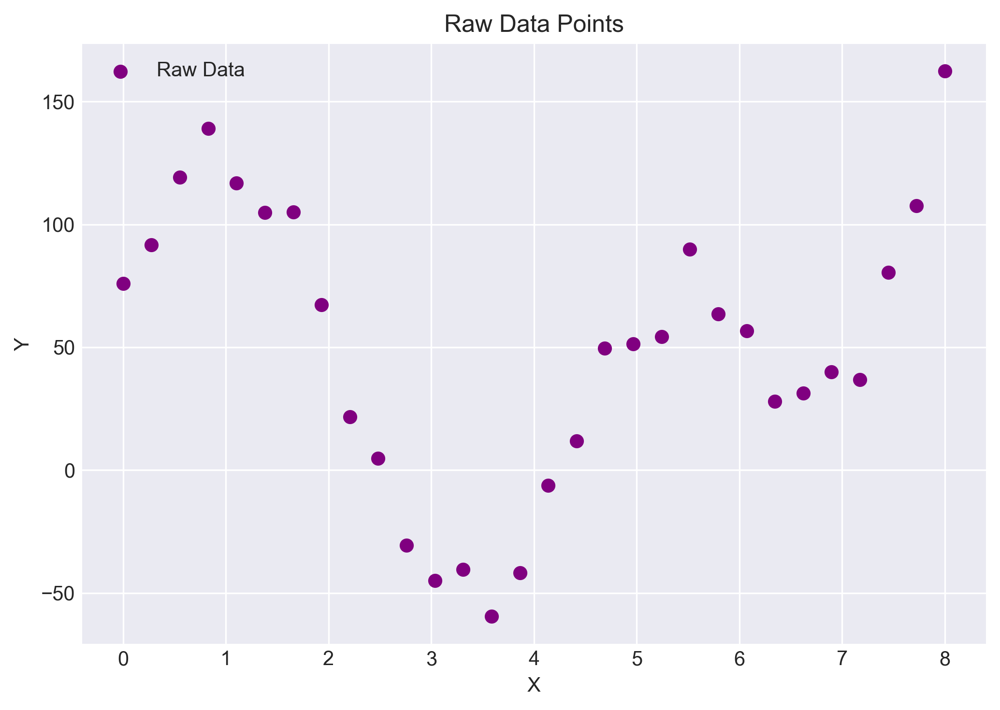

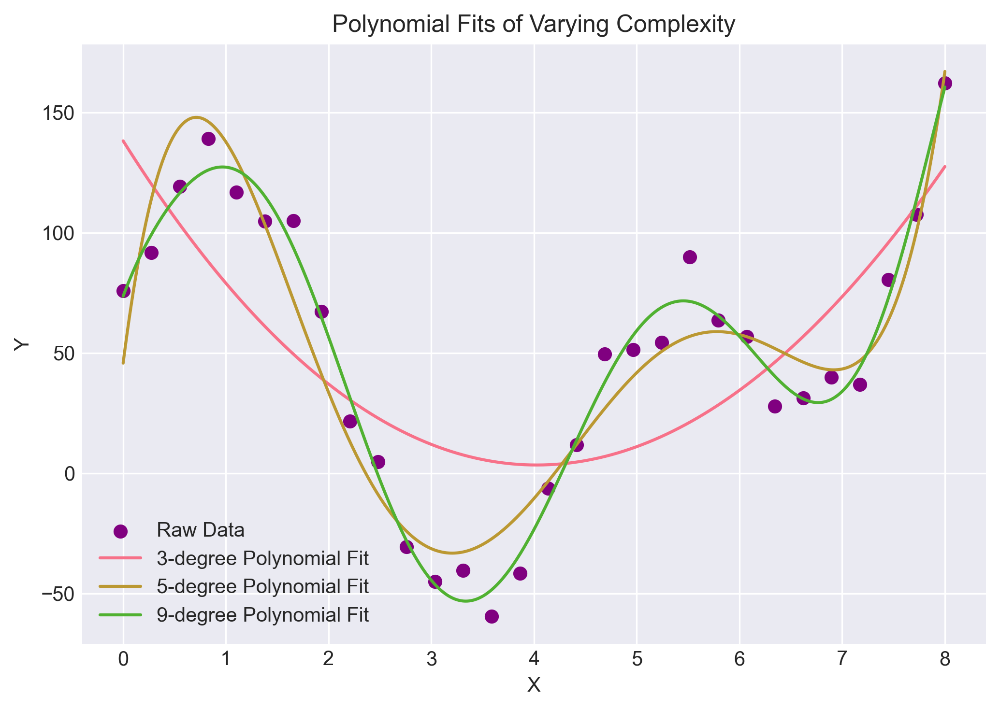

In [10]:
import numpy as np
import matplotlib.pyplot as plt


# Generate synthetic data

np.random.seed(42)
x = np.linspace(0, 8, 30)
true_y = 1.5 * x**3 - 10 * x**2 + 60 * np.sin(1.5 * x) + 70
y = true_y + np.random.normal(0, 12, size=x.shape)


# 1) Show raw data only

plt.figure(figsize=(7, 5))
plt.scatter(x, y, color="purple", label="Raw Data")
plt.xlabel("X")
plt.ylabel("Y")
plt.title("Raw Data Points")
plt.legend()
plt.tight_layout()
plt.show()


# 2) Add polynomial fits

degrees = [3, 5, 9]
x_grid = np.linspace(x.min(), x.max(), 400)

plt.figure(figsize=(7, 5))
plt.scatter(x, y, color="purple", label="Raw Data")

for deg in degrees:
    coeffs = np.polyfit(x, y, deg)
    poly   = np.poly1d(coeffs)
    plt.plot(x_grid, poly(x_grid), label=f"{deg}-degree Polynomial Fit")

plt.xlabel("X")
plt.ylabel("Y")
plt.title("Polynomial Fits of Varying Complexity")
plt.legend()
plt.tight_layout()
plt.show()


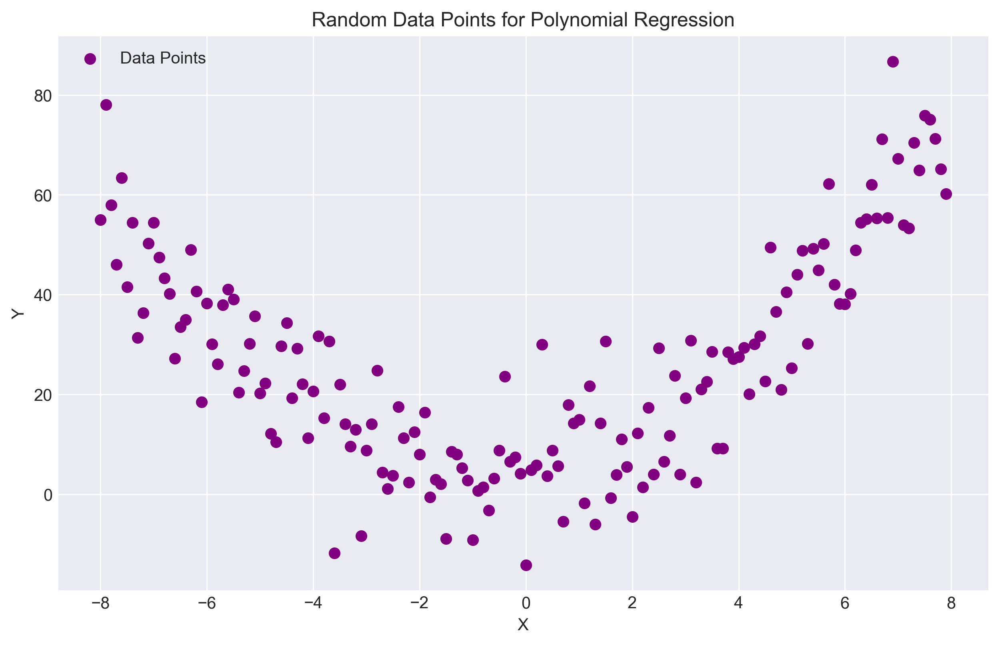

Linear Regression Model Evaluation:
Mean Squared Error: 342.820516257387
Mean Absolute Error: 16.042771100763304
R^2 Score: -0.018823154875756032


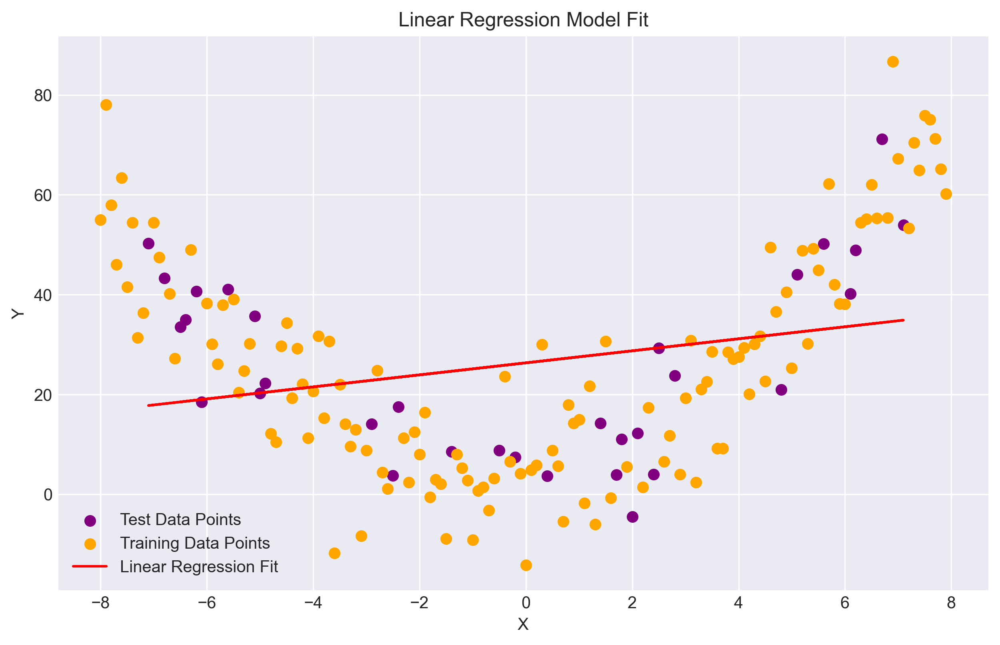

Polynomial Regression Model Evaluation:
Mean Squared Error: 65.77667609185721
Mean Absolute Error: 6.6665069227801625
R^2 Score: 0.8045192820291056


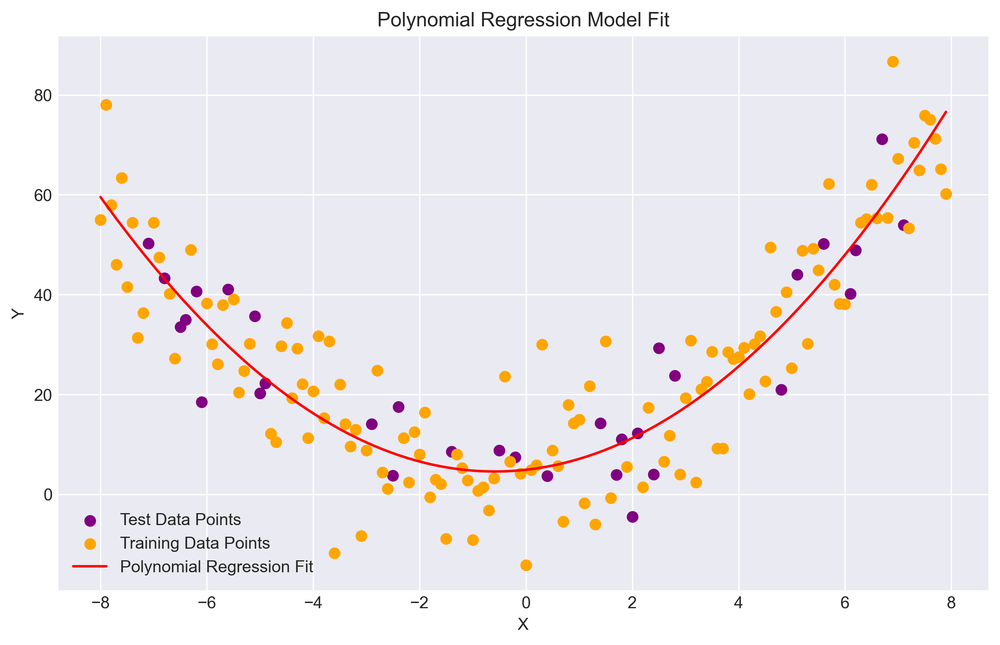

In [11]:
# Implement a polynomial regression model in python
# We will generate some random datapoints and the train the polynomial model with them

x = np.arange(-8,8,0.1)
rand = 10 * np.random.normal(size = len(x))
y = 1*(x**2) + 1*x + 5+rand
plt.scatter(x, y, color='purple', label='Data Points')
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Random Data Points for Polynomial Regression')
plt.legend()
plt.show()

#splitting the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(x.reshape(-1, 1), y, test_size=0.2, random_state=42)

# First we try a linear regression model
linear_model = LinearRegression()
linear_model.fit(X_train, y_train)
# Making predictions on the test set
y_pred = linear_model.predict(X_test)
# Evaluating the linear regression model
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
print("Linear Regression Model Evaluation:")
print("Mean Squared Error:", mse)
print("Mean Absolute Error:", mae)
print("R^2 Score:", r2)
# Visualizing the linear regression model with the best fit line
plt.scatter(X_test, y_test, color='purple', label='Test Data Points')
plt.scatter(X_train, y_train, color='orange', label='Training Data Points')
plt.plot(X_test, y_pred, color='red', label='Linear Regression Fit')
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Linear Regression Model Fit')
plt.legend()
plt.show()


# Now we will implement a polynomial regression model to fit the data

# Creating a polynomial regression model
degree = 2  # Change this value to try different polynomial degrees
poly_features = PolynomialFeatures(degree=degree)
X_poly_train = poly_features.fit_transform(X_train)
# Fitting the polynomial regression model
poly_model = LinearRegression()
poly_model.fit(X_poly_train, y_train)
# Making predictions on the test set
X_poly_test = poly_features.transform(X_test)
y_poly_pred = poly_model.predict(X_poly_test)
# Evaluating the polynomial regression model
mse_poly = mean_squared_error(y_test, y_poly_pred)
mae_poly = mean_absolute_error(y_test, y_poly_pred)
r2_poly = r2_score(y_test, y_poly_pred)
print("Polynomial Regression Model Evaluation:")
print("Mean Squared Error:", mse_poly)
print("Mean Absolute Error:", mae_poly)
print("R^2 Score:", r2_poly)
# Visualizing the polynomial regression model with the best fit line
plt.scatter(X_test, y_test, color='purple', label='Test Data Points')
plt.scatter(X_train, y_train, color='orange', label='Training Data Points')
x_grid = np.linspace(X_train.min(), X_train.max(), 100).reshape(-1, 1)
X_poly_grid = poly_features.transform(x_grid)
y_poly_grid = poly_model.predict(X_poly_grid)
plt.plot(x_grid, y_poly_grid, color='red', label='Polynomial Regression Fit')
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Polynomial Regression Model Fit')
plt.legend()
plt.show()




Polynomial Regression Demonstration
True function: y = 0.5x³ - 2x² + x + 1 + noise


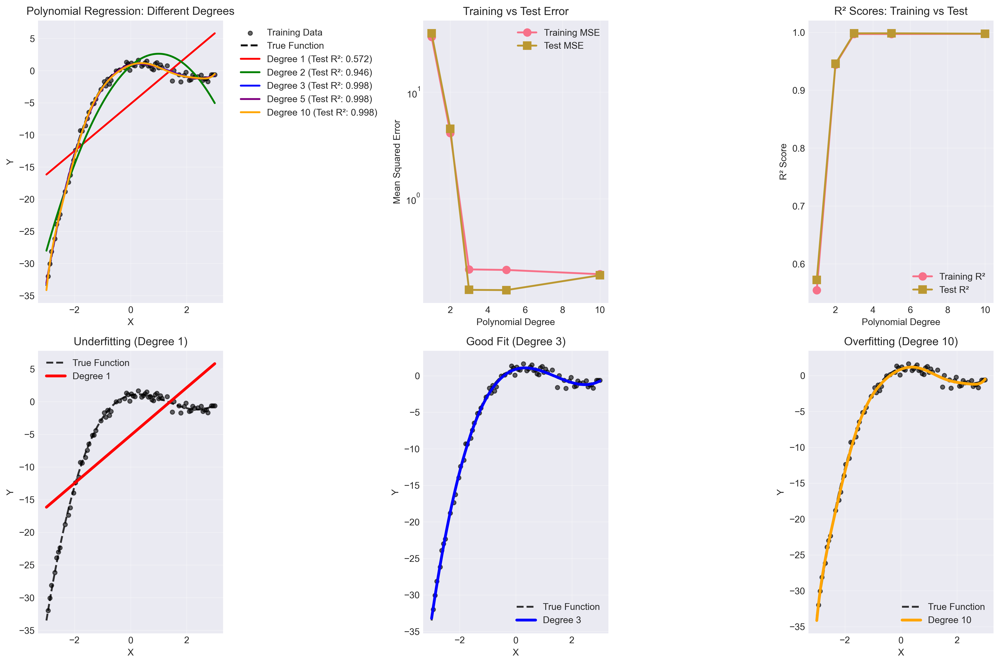


Polynomial Regression Results:
Degree | Train MSE | Test MSE  | Train R²  | Test R²   | Assessment
----------------------------------------------------------------------
   1   |   33.110  |   35.742  |    0.555  |    0.572  | Underfitting
   2   |    4.133  |    4.545  |    0.944  |    0.946  | Good Fit
   3   |    0.217  |    0.140  |    0.997  |    0.998  | Good Fit
   5   |    0.215  |    0.139  |    0.997  |    0.998  | Overfitting
  10   |    0.196  |    0.191  |    0.997  |    0.998  | Overfitting

Key Insights:
- Low degree: Underfits (high bias, low variance)
- Appropriate degree: Good balance (bias-variance tradeoff)
- High degree: Overfits (low bias, high variance)


In [12]:
# Demonstrate polynomial regression with different degrees
print("Polynomial Regression Demonstration")
print("=" * 40)

# Create non-linear synthetic data
np.random.seed(42)
X_poly = np.linspace(-3, 3, 100).reshape(-1, 1)
y_true_poly = 0.5 * X_poly**3 - 2 * X_poly**2 + X_poly + 1
noise = np.random.normal(0, 0.5, (100, 1))
y_poly = y_true_poly + noise

print(f"True function: y = 0.5x³ - 2x² + x + 1 + noise")

# Split data for training and testing
X_train_poly, X_test_poly, y_train_poly, y_test_poly = train_test_split(
    X_poly, y_poly, test_size=0.3, random_state=42
)

# Test different polynomial degrees
degrees = [1, 2, 3, 5, 10]
colors = ['red', 'green', 'blue', 'purple', 'orange']

plt.figure(figsize=(15, 10))

# Plot 1: All polynomial fits
plt.subplot(2, 3, 1)
plt.scatter(X_train_poly, y_train_poly, alpha=0.6, color='black', s=20, label='Training Data')
plt.plot(X_poly, y_true_poly, 'k--', linewidth=2, label='True Function')

results = {}
X_plot = np.linspace(-3, 3, 200).reshape(-1, 1)

for degree, color in zip(degrees, colors):
    # Create polynomial features and fit model
    poly_features = PolynomialFeatures(degree=degree, include_bias=False)
    X_train_poly_features = poly_features.fit_transform(X_train_poly)
    X_test_poly_features = poly_features.transform(X_test_poly)
    X_plot_features = poly_features.transform(X_plot)
    
    # Fit linear regression on polynomial features
    poly_model = LinearRegression()
    poly_model.fit(X_train_poly_features, y_train_poly)
    
    # Make predictions
    y_train_pred = poly_model.predict(X_train_poly_features)
    y_test_pred = poly_model.predict(X_test_poly_features)
    y_plot_pred = poly_model.predict(X_plot_features)
    
    # Calculate metrics
    train_mse = mean_squared_error(y_train_poly, y_train_pred)
    test_mse = mean_squared_error(y_test_poly, y_test_pred)
    train_r2 = r2_score(y_train_poly, y_train_pred)
    test_r2 = r2_score(y_test_poly, y_test_pred)
    
    results[degree] = {
        'train_mse': train_mse,
        'test_mse': test_mse,
        'train_r2': train_r2,
        'test_r2': test_r2
    }
    
    # Plot the fit
    plt.plot(X_plot, y_plot_pred, color=color, linewidth=2, 
             label=f'Degree {degree} (Test R²: {test_r2:.3f})')

plt.xlabel('X')
plt.ylabel('Y')
plt.title('Polynomial Regression: Different Degrees')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, alpha=0.3)

# Plot 2: Training vs Test Error
plt.subplot(2, 3, 2)
train_errors = [results[d]['train_mse'] for d in degrees]
test_errors = [results[d]['test_mse'] for d in degrees]

plt.plot(degrees, train_errors, 'o-', label='Training MSE', linewidth=2, markersize=8)
plt.plot(degrees, test_errors, 's-', label='Test MSE', linewidth=2, markersize=8)
plt.xlabel('Polynomial Degree')
plt.ylabel('Mean Squared Error')
plt.title('Training vs Test Error')
plt.legend()
plt.grid(True, alpha=0.3)
plt.yscale('log')

# Plot 3: R² Scores
plt.subplot(2, 3, 3)
train_r2s = [results[d]['train_r2'] for d in degrees]
test_r2s = [results[d]['test_r2'] for d in degrees]

plt.plot(degrees, train_r2s, 'o-', label='Training R²', linewidth=2, markersize=8)
plt.plot(degrees, test_r2s, 's-', label='Test R²', linewidth=2, markersize=8)
plt.xlabel('Polynomial Degree')
plt.ylabel('R² Score')
plt.title('R² Scores: Training vs Test')
plt.legend()
plt.grid(True, alpha=0.3)

# Plot 4-6: Individual degree examples
example_degrees = [1, 3, 10]
titles = ['Underfitting (Degree 1)', 'Good Fit (Degree 3)', 'Overfitting (Degree 10)']

for i, (deg, title) in enumerate(zip(example_degrees, titles)):
    plt.subplot(2, 3, 4 + i)
    
    # Refit for this specific degree
    poly_features = PolynomialFeatures(degree=deg, include_bias=False)
    X_train_features = poly_features.fit_transform(X_train_poly)
    X_plot_features = poly_features.transform(X_plot)
    
    model = LinearRegression()
    model.fit(X_train_features, y_train_poly)
    y_plot_pred = model.predict(X_plot_features)
    
    plt.scatter(X_train_poly, y_train_poly, alpha=0.6, color='black', s=20)
    plt.plot(X_poly, y_true_poly, 'k--', linewidth=2, alpha=0.8, label='True Function')
    plt.plot(X_plot, y_plot_pred, color=colors[degrees.index(deg)], linewidth=3, 
             label=f'Degree {deg}')
    
    plt.xlabel('X')
    plt.ylabel('Y')
    plt.title(title)
    plt.legend()
    plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# Print results table
print("\nPolynomial Regression Results:")
print("Degree | Train MSE | Test MSE  | Train R²  | Test R²   | Assessment")
print("-" * 70)
for degree in degrees:
    r = results[degree]
    if degree == 1:
        assessment = "Underfitting"
    elif degree in [2, 3]:
        assessment = "Good Fit"
    else:
        assessment = "Overfitting"
    
    print(f"  {degree:2d}   | {r['train_mse']:8.3f}  | {r['test_mse']:8.3f}  | {r['train_r2']:8.3f}  | {r['test_r2']:8.3f}  | {assessment}")

print("\nKey Insights:")
print("- Low degree: Underfits (high bias, low variance)")
print("- Appropriate degree: Good balance (bias-variance tradeoff)")
print("- High degree: Overfits (low bias, high variance)")

## Evaluation Metrics Deep Dive

Let's explore different regression metrics and understand when to use each one:

Regression Evaluation Metrics


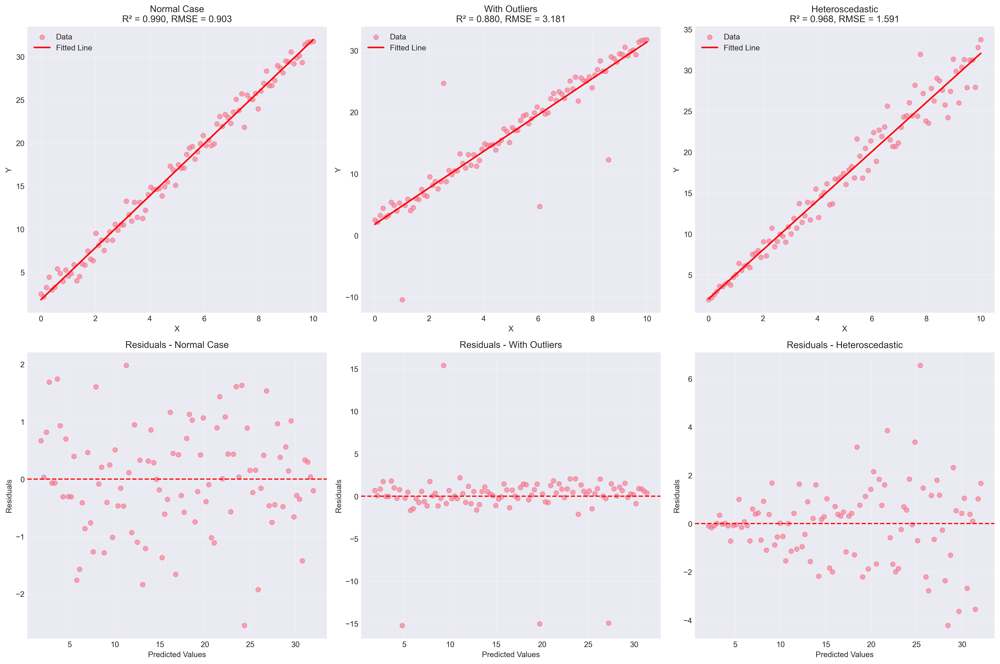


Metrics Comparison:
        Dataset     MSE   RMSE    MAE     R²  Adj R²
    Normal Case  0.8149 0.9027 0.7150 0.9896  0.9895
  With Outliers 10.1162 3.1806 1.3708 0.8803  0.8791
Heteroscedastic  2.5302 1.5907 1.1535 0.9680  0.9677

Metric Interpretations:
- MSE: Penalizes large errors heavily (outliers have big impact)
- RMSE: Same units as target, easier to interpret
- MAE: Robust to outliers, treats all errors equally
- R²: Proportion of variance explained (0-1, higher is better)
- Adj R²: Penalizes adding irrelevant features

Detailed Metrics Guide:
     Metric                   Formula   Range  Best_Value                       Use_Case
        MSE         (1/m) Σ(ŷᵢ - yᵢ)²  [0, ∞)       Lower General; optimization-friendly
       RMSE                      √MSE  [0, ∞)       Lower      Intuitive error magnitude
        MAE          (1/m) Σ|ŷᵢ - yᵢ|  [0, ∞)       Lower             Robust to outliers
         R²         1 - SS_res/SS_tot (-∞, 1] Higher (→1)              Overall mode

In [13]:
# Comprehensive evaluation metrics demonstration
print("Regression Evaluation Metrics")
print("=" * 40)

# Create datasets with different characteristics
np.random.seed(42)

# Dataset 1: Normal case
X1 = np.linspace(0, 10, 100).reshape(-1, 1)
y1_true = 2 + 3 * X1.flatten()
y1 = y1_true + np.random.normal(0, 1, 100)

# Dataset 2: With outliers
y2 = y1.copy()
outlier_indices = [10, 25, 60, 85]
y2[outlier_indices] += np.random.choice([-15, 15], size=len(outlier_indices))

# Dataset 3: Heteroscedastic (increasing variance)
noise_scale = 0.1 + 0.3 * X1.flatten()
y3 = y1_true + np.random.normal(0, noise_scale)

datasets = [
    (X1, y1, "Normal Case"),
    (X1, y2, "With Outliers"),
    (X1, y3, "Heteroscedastic")
]

fig, axes = plt.subplots(2, 3, figsize=(18, 12))

# Calculate metrics for each dataset
metrics_results = []

for i, (X, y, title) in enumerate(datasets):
    # Fit model
    model = LinearRegression()
    model.fit(X, y)
    y_pred = model.predict(X)
    
    # Calculate all metrics
    mse = mean_squared_error(y, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y, y_pred)
    r2 = r2_score(y, y_pred)
    
    # Adjusted R²
    n = len(y)
    p = X.shape[1]
    adj_r2 = 1 - (1 - r2) * (n - 1) / (n - p - 1)
    
    metrics_results.append({
        'Dataset': title,
        'MSE': mse,
        'RMSE': rmse,
        'MAE': mae,
        'R²': r2,
        'Adj R²': adj_r2
    })
    
    # Plot data and fit
    axes[0, i].scatter(X, y, alpha=0.6, label='Data')
    axes[0, i].plot(X, y_pred, color='red', linewidth=2, label='Fitted Line')
    axes[0, i].set_title(f'{title}\nR² = {r2:.3f}, RMSE = {rmse:.3f}')
    axes[0, i].set_xlabel('X')
    axes[0, i].set_ylabel('Y')
    axes[0, i].legend()
    axes[0, i].grid(True, alpha=0.3)
    
    # Plot residuals
    residuals = y - y_pred
    axes[1, i].scatter(y_pred, residuals, alpha=0.6)
    axes[1, i].axhline(y=0, color='red', linestyle='--')
    axes[1, i].set_title(f'Residuals - {title}')
    axes[1, i].set_xlabel('Predicted Values')
    axes[1, i].set_ylabel('Residuals')
    axes[1, i].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# Display metrics comparison table
metrics_df = pd.DataFrame(metrics_results)
print("\nMetrics Comparison:")
print(metrics_df.round(4).to_string(index=False))

print("\nMetric Interpretations:")
print("- MSE: Penalizes large errors heavily (outliers have big impact)")
print("- RMSE: Same units as target, easier to interpret")
print("- MAE: Robust to outliers, treats all errors equally")
print("- R²: Proportion of variance explained (0-1, higher is better)")
print("- Adj R²: Penalizes adding irrelevant features")

# Create detailed metrics explanation
metrics_info = {
    'Metric': ['MSE', 'RMSE', 'MAE', 'R²', 'Adjusted R²'],
    'Formula': [
        '(1/m) Σ(ŷᵢ - yᵢ)²',
        '√MSE',
        '(1/m) Σ|ŷᵢ - yᵢ|',
        '1 - SS_res/SS_tot',
        '1 - [(1-R²)(m-1)/(m-p-1)]'
    ],
    'Range': ['[0, ∞)', '[0, ∞)', '[0, ∞)', '(-∞, 1]', '(-∞, 1]'],
    'Best_Value': ['Lower', 'Lower', 'Lower', 'Higher (→1)', 'Higher (→1)'],
    'Use_Case': [
        'General; optimization-friendly',
        'Intuitive error magnitude',
        'Robust to outliers',
        'Overall model fit',
        'Multiple features comparison'
    ]
}

metrics_info_df = pd.DataFrame(metrics_info)
print("\nDetailed Metrics Guide:")
print(metrics_info_df.to_string(index=False))

### Example

,R&D Spend,Administration,Marketing Spend,State,Profit
0,165349.20,136897.80,471784.10,New York,192261.83
1,162597.70,151377.59,443898.53,California,191792.06
2,153441.51,101145.55,407934.54,Florida,191050.39
3,144372.41,118671.85,383199.62,New York,182901.99
4,142107.34,91391.77,366168.42,Florida,166187.94


Model Evaluation:
Mean Squared Error: 30222809.54869668
Mean Absolute Error: 1271.039661037825
R^2 Score: 0.9828413651608124


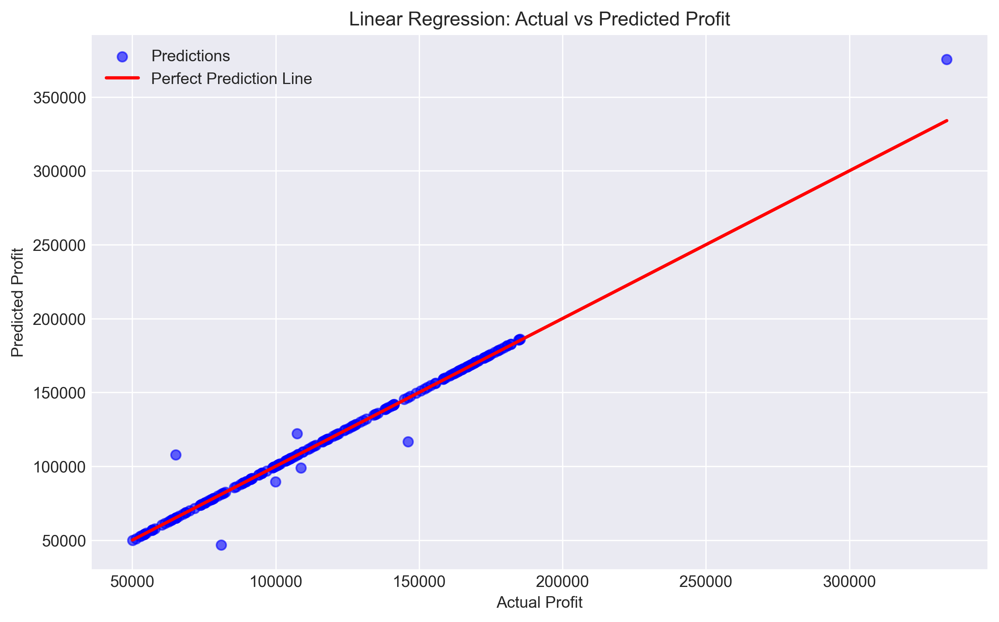

Predictions for new data: [127850.97106647 181472.85703086 235094.74299526]
Polynomial Regression Model Evaluation:
Mean Squared Error: 787747088.7915341
Mean Absolute Error: 2606.6057787627387
R^2 Score: 0.5527661112899449


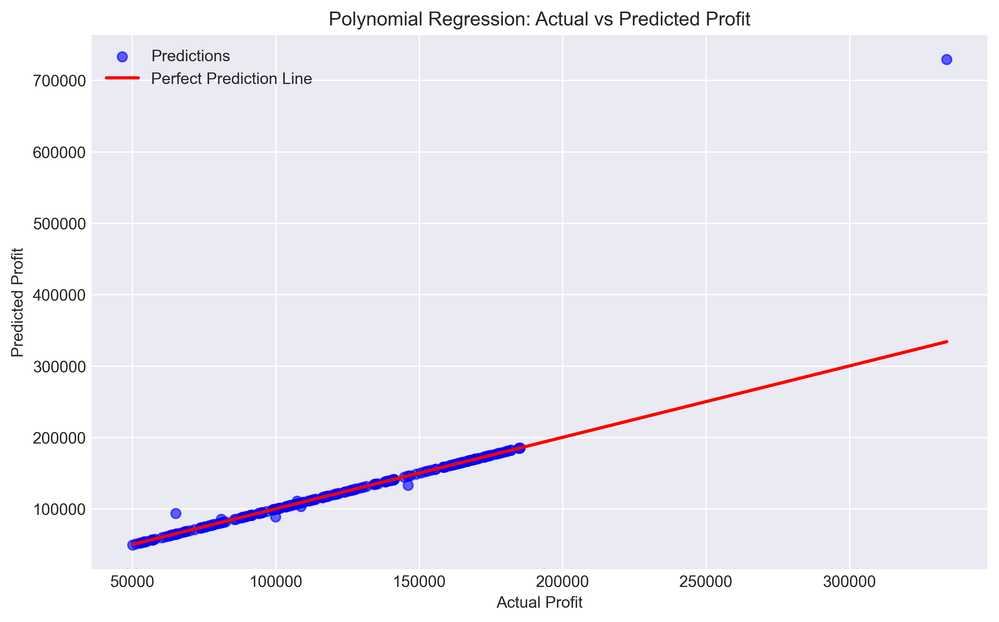

Predictions for new data with polynomial model: [176670.06554827 218835.35779064 266787.54680889]


In [14]:
# Predicting companies profit based on some factors.
# Importing the dataset
data = pd.read_csv('Datasets/1000_Companies.csv')
display(data.head())

# Split the data into features and target variable
X = data[['R&D Spend', 'Administration', 'Marketing Spend']]
y = data['Profit']
# Splitting the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
# Training the linear regression model
linear_model = LinearRegression()
linear_model.fit(X_train, y_train)
# Making predictions on the test set
y_pred = linear_model.predict(X_test)
# Evaluating the model
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
print("Model Evaluation:")
print("Mean Squared Error:", mse)
print("Mean Absolute Error:", mae)
print("R^2 Score:", r2)
# Visualizing the predictions
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', alpha=0.6, label
='Predictions')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', linewidth=2, label='Perfect Prediction Line')
plt.xlabel('Actual Profit')
plt.ylabel('Predicted Profit')
plt.title('Linear Regression: Actual vs Predicted Profit')
plt.legend()
plt.show()
# Saving the model for future use
joblib.dump(linear_model, 'profit_prediction_model.pkl')
# Loading the model for future use
loaded_model = joblib.load('profit_prediction_model.pkl')
# Making predictions with the loaded model
new_data = pd.DataFrame({
    'R&D Spend': [150000, 200000, 250000],
    'Administration': [100000, 120000, 140000],
    'Marketing Spend': [200000, 250000, 300000]
})
predictions = loaded_model.predict(new_data)
print("Predictions for new data:", predictions)


# Training the polynomial regression model
from sklearn.preprocessing import PolynomialFeatures
degree = 2  # Change this value to try different polynomial degrees
poly_features = PolynomialFeatures(degree=degree)
X_poly_train = poly_features.fit_transform(X_train)
# Fitting the polynomial regression model
poly_model = LinearRegression()
poly_model.fit(X_poly_train, y_train)
# Making predictions on the test set
X_poly_test = poly_features.transform(X_test)
y_poly_pred = poly_model.predict(X_poly_test)
# Evaluating the polynomial regression model
mse_poly = mean_squared_error(y_test, y_poly_pred)
mae_poly = mean_absolute_error(y_test, y_poly_pred)
r2_poly = r2_score(y_test, y_poly_pred)
print("Polynomial Regression Model Evaluation:")
print("Mean Squared Error:", mse_poly)
print("Mean Absolute Error:", mae_poly)
print("R^2 Score:", r2_poly)
# Visualizing the polynomial regression model with the best fit line
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_poly_pred, color='blue', alpha=0.6, label='Predictions')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', linewidth=2, label='Perfect Prediction Line')
plt.xlabel('Actual Profit')
plt.ylabel('Predicted Profit')
plt.title('Polynomial Regression: Actual vs Predicted Profit')
plt.legend()
plt.show()
# Saving the polynomial regression model for future use
joblib.dump(poly_model, 'profit_prediction_poly_model.pkl')
# Loading the polynomial regression model for future use
loaded_poly_model = joblib.load('profit_prediction_poly_model.pkl')
# Making predictions with the loaded polynomial regression model
new_data_poly = pd.DataFrame({
    'R&D Spend': [150000, 200000, 250000],
    'Administration': [100000, 120000, 140000],
    'Marketing Spend': [200000, 250000, 300000]
})
predictions_poly = loaded_poly_model.predict(poly_features.transform(new_data_poly))
print("Predictions for new data with polynomial model:", predictions_poly)



### Analysis

,R&D Spend,Administration,Marketing Spend,State,Profit
0,165349.20,136897.80,471784.10,New York,192261.83
1,162597.70,151377.59,443898.53,California,191792.06
2,153441.51,101145.55,407934.54,Florida,191050.39
3,144372.41,118671.85,383199.62,New York,182901.99
4,142107.34,91391.77,366168.42,Florida,166187.94


Dataset Shape: (1000, 5)

Dataset Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 5 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   R&D Spend        1000 non-null   float64
 1   Administration   1000 non-null   float64
 2   Marketing Spend  1000 non-null   float64
 3   State            1000 non-null   object 
 4   Profit           1000 non-null   float64
dtypes: float64(4), object(1)
memory usage: 39.2+ KB
None

First 5 rows:
   R&D Spend  Administration  Marketing Spend       State     Profit
0  165349.20       136897.80        471784.10    New York  192261.83
1  162597.70       151377.59        443898.53  California  191792.06
2  153441.51       101145.55        407934.54     Florida  191050.39
3  144372.41       118671.85        383199.62    New York  182901.99
4  142107.34        91391.77        366168.42     Florida  166187.94

EXPLORATORY DATA ANALYSIS

Descriptive Statis

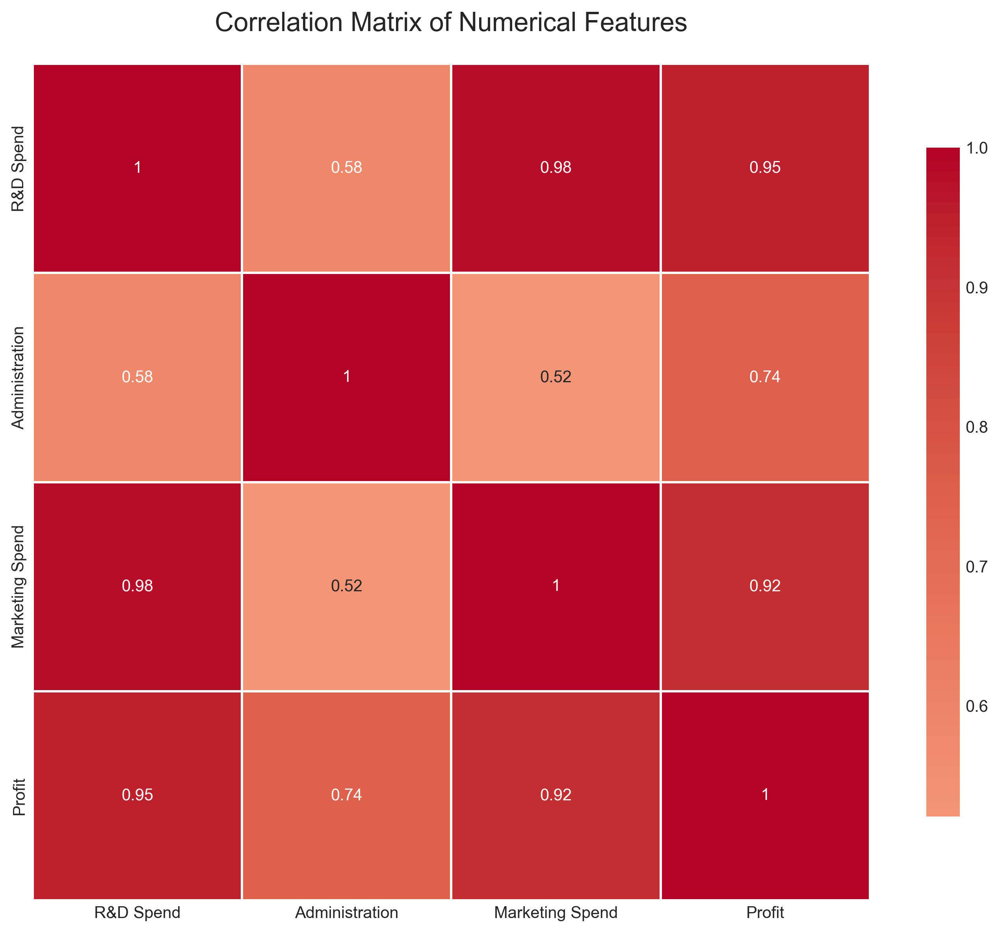

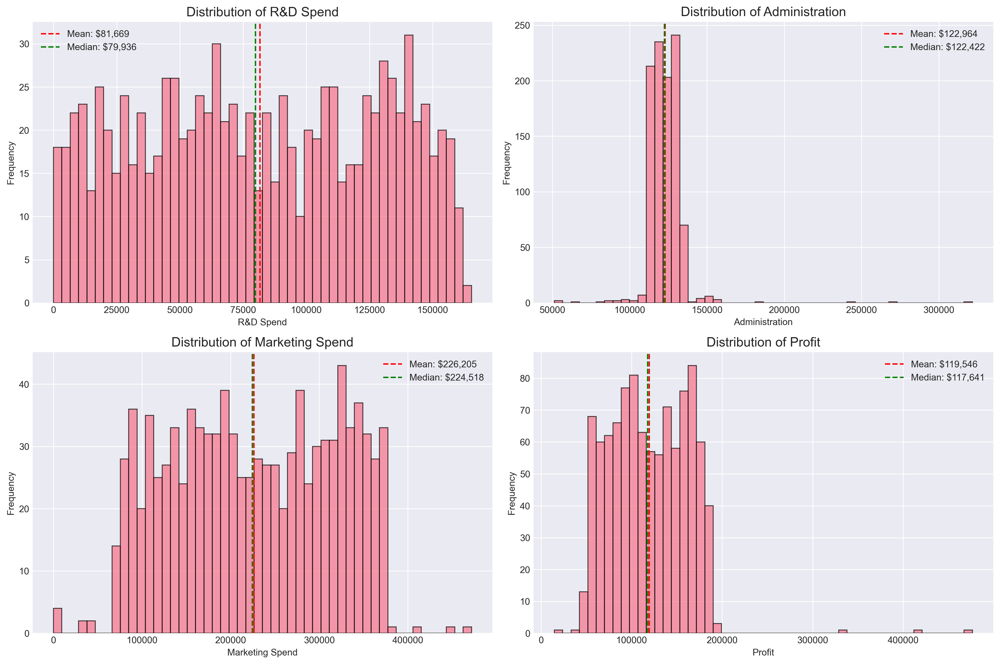

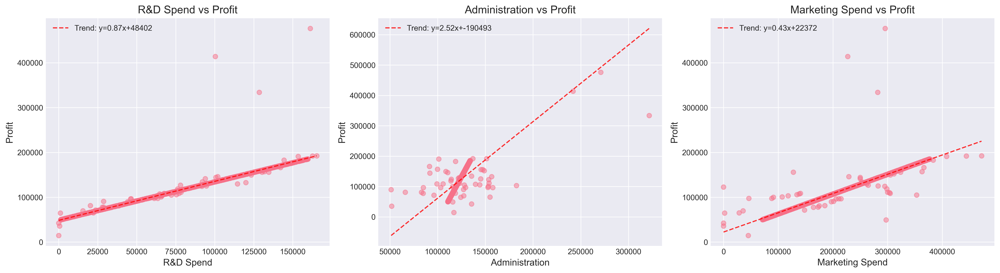

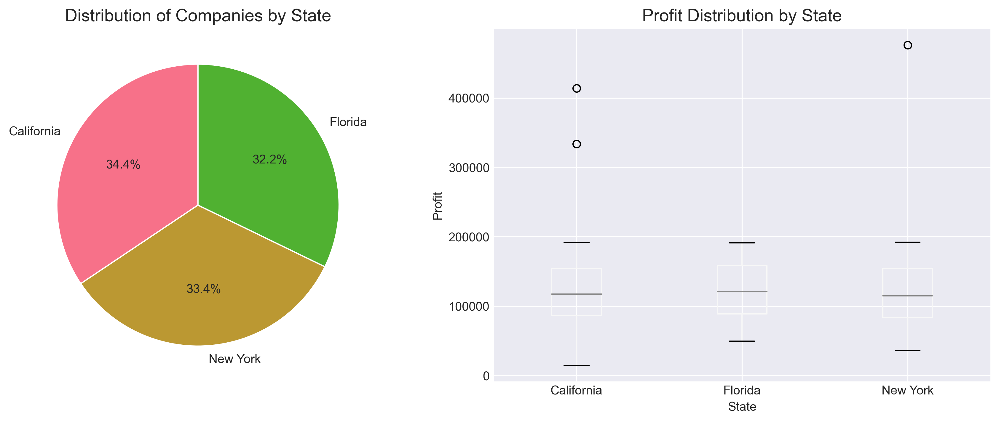


DATA PREPROCESSING

Dataset after one-hot encoding:
   R&D Spend  Administration  Marketing Spend     Profit  State_California  \
0  165349.20       136897.80        471784.10  192261.83             False   
1  162597.70       151377.59        443898.53  191792.06              True   
2  153441.51       101145.55        407934.54  191050.39             False   
3  144372.41       118671.85        383199.62  182901.99             False   
4  142107.34        91391.77        366168.42  166187.94             False   

   State_Florida  State_New York  
0          False            True  
1          False           False  
2           True           False  
3          False            True  
4           True           False  

Training set size: (800, 6)
Test set size: (200, 6)

MODEL IMPLEMENTATION AND COMPARISON

1. Linear Regression
Test R² Score: 0.9825

2. Polynomial Regression (Degree 2)
Test R² Score: 0.5694

3. Polynomial Regression (Degree 3)
Test R² Score: 0.0304

4. Polynomial R

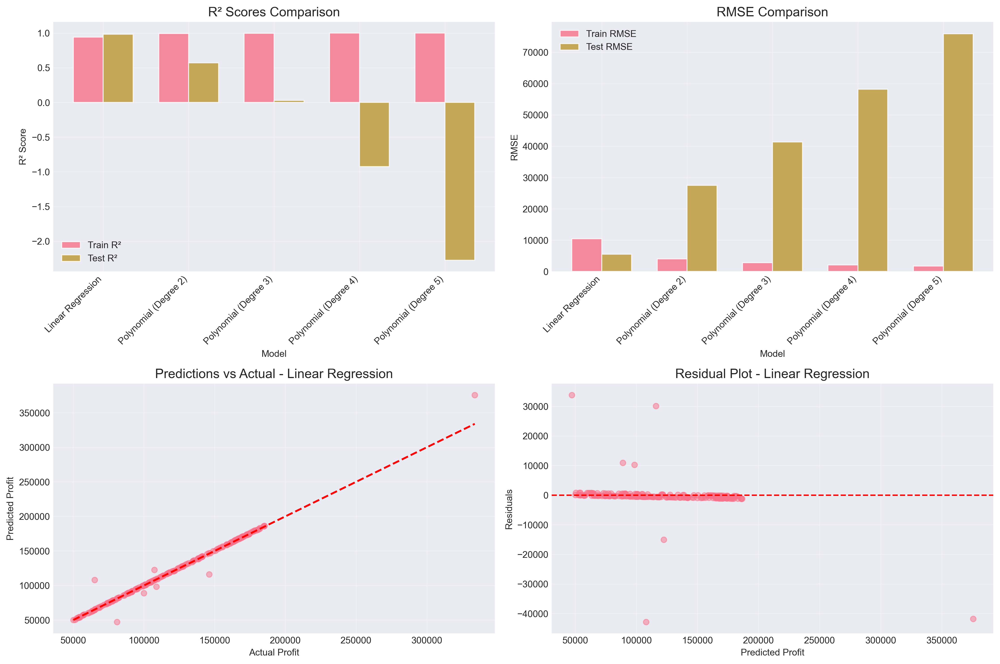

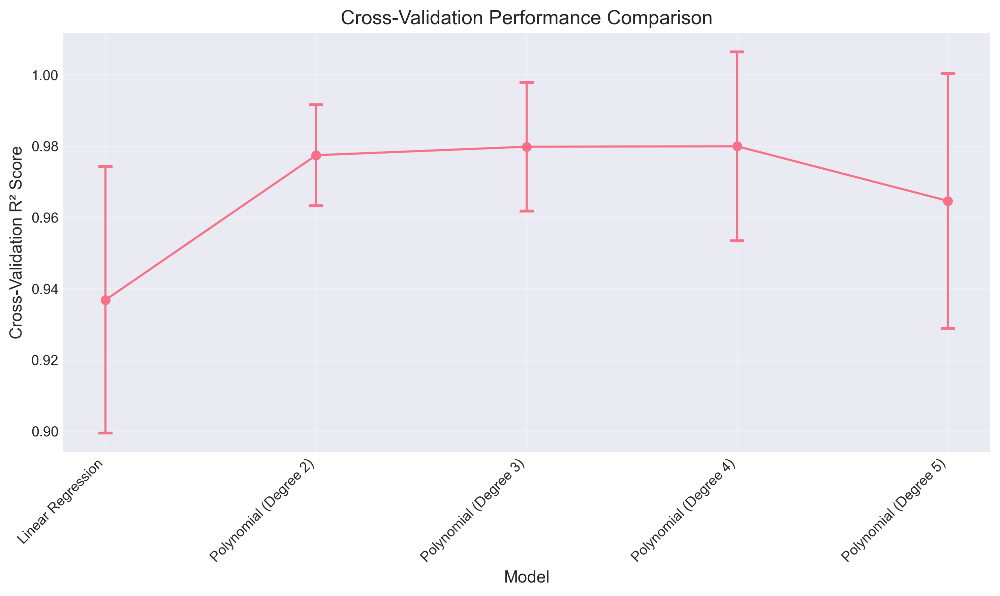


FEATURE IMPORTANCE ANALYSIS

Feature Importance (Linear Model):
            Feature   Coefficient  Abs_Coefficient
0         R&D Spend  24881.652357     24881.652357
1    Administration  13174.603836     13174.603836
2   Marketing Spend   7641.483136      7641.483136
4     State_Florida   -259.249035       259.249035
3  State_California    149.750661       149.750661
5    State_New York    105.054325       105.054325


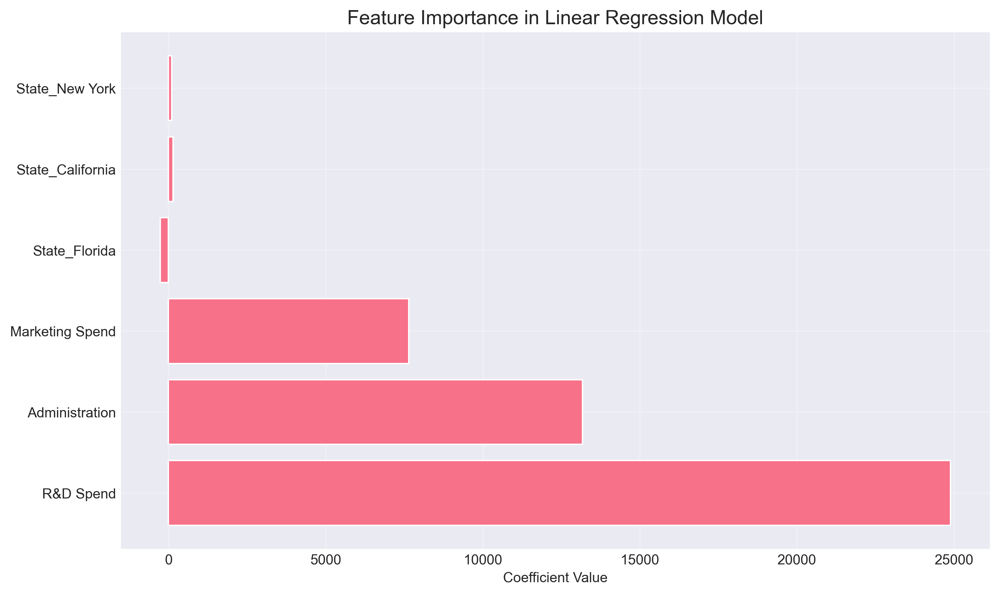


SUMMARY REPORT

ANALYSIS SUMMARY

1. DATASET OVERVIEW:
   - Total samples: 1000 companies
   - Features: R&D Spend, Administration, Marketing Spend, State
   - Target: Profit
   - States: New York, California, Florida

2. INSIGHTS FROM EDA:
   - Strongest correlation with Profit: R&D Spend (r = 0.945)
   - Marketing Spend correlation: r = 0.917
   - Administration correlation: r = 0.742
   - Average Profit: $119,546.16

3. MODEL PERFORMANCE COMPARISON:


   Linear Regression:
   - Test R² Score: 0.9825
   - Test RMSE: $5,547.53
   - CV R² Mean: 0.9368 (±0.0373)
   - Overfitting: No


   Polynomial (Degree 2):
   - Test R² Score: 0.5694
   - Test RMSE: $27,538.88
   - CV R² Mean: 0.9774 (±0.0142)
   - Overfitting: Yes


   Polynomial (Degree 3):
   - Test R² Score: 0.0304
   - Test RMSE: $41,324.94
   - CV R² Mean: 0.9798 (±0.0180)
   - Overfitting: Yes


   Polynomial (Degree 4):
   - Test R² Score: -0.9228
   - Test RMSE: $58,195.79
   - CV R² Mean: 0.9799 (±0.0265)
   - Overfitting:

In [16]:
# Set style for better visualizations
plt.style.use('seaborn-v0_8-darkgrid')
sns.set_palette("husl")

# Load the dataset
df = pd.read_csv('Datasets/1000_Companies.csv')
display(df.head())
print("Dataset Shape:", df.shape)
print("\nDataset Info:")
print(df.info())
print("\nFirst 5 rows:")
print(df.head())

# 1. EXPLORATORY DATA ANALYSIS
print("\n" + "="*50)
print("EXPLORATORY DATA ANALYSIS")
print("="*50)

# Basic statistics
print("\nDescriptive Statistics:")
print(df.describe())

# Correlation analysis
plt.figure(figsize=(10, 8))
correlation_matrix = df.select_dtypes(include=[np.number]).corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0, 
            square=True, linewidths=1, cbar_kws={"shrink": .8})
plt.title('Correlation Matrix of Numerical Features', fontsize=16, pad=20)
plt.tight_layout()
plt.show()

# Distribution plots
fig, axes = plt.subplots(2, 2, figsize=(15, 10))
axes = axes.ravel()

for idx, col in enumerate(['R&D Spend', 'Administration', 'Marketing Spend', 'Profit']):
    axes[idx].hist(df[col], bins=50, alpha=0.7, edgecolor='black')
    axes[idx].set_title(f'Distribution of {col}', fontsize=14)
    axes[idx].set_xlabel(col)
    axes[idx].set_ylabel('Frequency')
    
    # Add mean and median lines
    mean_val = df[col].mean()
    median_val = df[col].median()
    axes[idx].axvline(mean_val, color='red', linestyle='--', label=f'Mean: ${mean_val:,.0f}')
    axes[idx].axvline(median_val, color='green', linestyle='--', label=f'Median: ${median_val:,.0f}')
    axes[idx].legend()

plt.tight_layout()
plt.show()

# Scatter plots: Features vs Profit
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

features = ['R&D Spend', 'Administration', 'Marketing Spend']
for idx, feature in enumerate(features):
    axes[idx].scatter(df[feature], df['Profit'], alpha=0.5)
    axes[idx].set_xlabel(feature, fontsize=12)
    axes[idx].set_ylabel('Profit', fontsize=12)
    axes[idx].set_title(f'{feature} vs Profit', fontsize=14)
    
    # Add trend line
    z = np.polyfit(df[feature], df['Profit'], 1)
    p = np.poly1d(z)
    axes[idx].plot(df[feature].sort_values(), p(df[feature].sort_values()), 
                   "r--", alpha=0.8, label=f'Trend: y={z[0]:.2f}x+{z[1]:.0f}')
    axes[idx].legend()

plt.tight_layout()
plt.show()

# State analysis
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
state_counts = df['State'].value_counts()
plt.pie(state_counts.values, labels=state_counts.index, autopct='%1.1f%%', startangle=90)
plt.title('Distribution of Companies by State', fontsize=14)

plt.subplot(1, 2, 2)
df.boxplot(column='Profit', by='State', ax=plt.gca())
plt.title('Profit Distribution by State', fontsize=14)
plt.suptitle('')
plt.xlabel('State')
plt.ylabel('Profit')

plt.tight_layout()
plt.show()

# 2. DATA PREPROCESSING
print("\n" + "="*50)
print("DATA PREPROCESSING")
print("="*50)

# One-hot encode the State column
df_encoded = pd.get_dummies(df, columns=['State'], prefix='State')
print("\nDataset after one-hot encoding:")
print(df_encoded.head())

# Prepare features and target
X = df_encoded.drop('Profit', axis=1)
y = df_encoded['Profit']

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
print(f"\nTraining set size: {X_train.shape}")
print(f"Test set size: {X_test.shape}")

# 3. MODEL IMPLEMENTATION AND COMPARISON
print("\n" + "="*50)
print("MODEL IMPLEMENTATION AND COMPARISON")
print("="*50)

# Function to evaluate models
def evaluate_model(model, X_train, X_test, y_train, y_test, model_name):
    # Fit the model
    model.fit(X_train, y_train)
    
    # Make predictions
    y_train_pred = model.predict(X_train)
    y_test_pred = model.predict(X_test)
    
    # Calculate metrics
    train_mse = mean_squared_error(y_train, y_train_pred)
    test_mse = mean_squared_error(y_test, y_test_pred)
    train_rmse = np.sqrt(train_mse)
    test_rmse = np.sqrt(test_mse)
    train_mae = mean_absolute_error(y_train, y_train_pred)
    test_mae = mean_absolute_error(y_test, y_test_pred)
    train_r2 = r2_score(y_train, y_train_pred)
    test_r2 = r2_score(y_test, y_test_pred)
    
    # Cross-validation
    cv_scores = cross_val_score(model, X_train, y_train, cv=5, scoring='r2')
    
    results = {
        'Model': model_name,
        'Train MSE': train_mse,
        'Test MSE': test_mse,
        'Train RMSE': train_rmse,
        'Test RMSE': test_rmse,
        'Train MAE': train_mae,
        'Test MAE': test_mae,
        'Train R²': train_r2,
        'Test R²': test_r2,
        'CV R² Mean': cv_scores.mean(),
        'CV R² Std': cv_scores.std()
    }
    
    return results, y_test_pred

# Store results
results_list = []

# Linear Regression
print("\n1. Linear Regression")
linear_model = Pipeline([
    ('scaler', StandardScaler()),
    ('regressor', LinearRegression())
])
linear_results, linear_pred = evaluate_model(linear_model, X_train, X_test, y_train, y_test, 'Linear Regression')
results_list.append(linear_results)
print(f"Test R² Score: {linear_results['Test R²']:.4f}")

# Polynomial Regression with different degrees
degrees = [2, 3, 4, 5]
poly_predictions = {}

for degree in degrees:
    print(f"\n{degree}. Polynomial Regression (Degree {degree})")
    poly_model = Pipeline([
        ('poly', PolynomialFeatures(degree=degree, include_bias=False)),
        ('scaler', StandardScaler()),
        ('regressor', Ridge(alpha=1.0))  # Using Ridge to prevent overfitting
    ])
    poly_results, poly_pred = evaluate_model(poly_model, X_train, X_test, y_train, y_test, f'Polynomial (Degree {degree})')
    results_list.append(poly_results)
    poly_predictions[degree] = poly_pred
    print(f"Test R² Score: {poly_results['Test R²']:.4f}")

# 4. RESULTS COMPARISON
print("\n" + "="*50)
print("RESULTS COMPARISON")
print("="*50)

# Create results dataframe
results_df = pd.DataFrame(results_list)
print("\nModel Performance Summary:")
print(results_df[['Model', 'Train R²', 'Test R²', 'Test RMSE', 'Test MAE']])

# Visualization of results
fig, axes = plt.subplots(2, 2, figsize=(15, 10))

# R² Scores Comparison
ax1 = axes[0, 0]
x = np.arange(len(results_df))
width = 0.35
ax1.bar(x - width/2, results_df['Train R²'], width, label='Train R²', alpha=0.8)
ax1.bar(x + width/2, results_df['Test R²'], width, label='Test R²', alpha=0.8)
ax1.set_xlabel('Model')
ax1.set_ylabel('R² Score')
ax1.set_title('R² Scores Comparison', fontsize=14)
ax1.set_xticks(x)
ax1.set_xticklabels(results_df['Model'], rotation=45, ha='right')
ax1.legend()
ax1.grid(True, alpha=0.3)

# RMSE Comparison
ax2 = axes[0, 1]
ax2.bar(x - width/2, results_df['Train RMSE'], width, label='Train RMSE', alpha=0.8)
ax2.bar(x + width/2, results_df['Test RMSE'], width, label='Test RMSE', alpha=0.8)
ax2.set_xlabel('Model')
ax2.set_ylabel('RMSE')
ax2.set_title('RMSE Comparison', fontsize=14)
ax2.set_xticks(x)
ax2.set_xticklabels(results_df['Model'], rotation=45, ha='right')
ax2.legend()
ax2.grid(True, alpha=0.3)

# Predictions vs Actual (Best Model)
best_model_idx = results_df['Test R²'].idxmax()
best_model_name = results_df.loc[best_model_idx, 'Model']

if best_model_name == 'Linear Regression':
    best_predictions = linear_pred
else:
    degree = int(best_model_name.split()[-1].strip(')'))
    best_predictions = poly_predictions[degree]

ax3 = axes[1, 0]
ax3.scatter(y_test, best_predictions, alpha=0.5)
ax3.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)
ax3.set_xlabel('Actual Profit')
ax3.set_ylabel('Predicted Profit')
ax3.set_title(f'Predictions vs Actual - {best_model_name}', fontsize=14)
ax3.grid(True, alpha=0.3)

# Residuals Plot
ax4 = axes[1, 1]
residuals = y_test - best_predictions
ax4.scatter(best_predictions, residuals, alpha=0.5)
ax4.axhline(y=0, color='r', linestyle='--')
ax4.set_xlabel('Predicted Profit')
ax4.set_ylabel('Residuals')
ax4.set_title(f'Residual Plot - {best_model_name}', fontsize=14)
ax4.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# Cross-validation scores visualization
plt.figure(figsize=(10, 6))
models = results_df['Model']
cv_means = results_df['CV R² Mean']
cv_stds = results_df['CV R² Std']

plt.errorbar(models, cv_means, yerr=cv_stds, marker='o', linestyle='-', capsize=5, capthick=2)
plt.xlabel('Model', fontsize=12)
plt.ylabel('Cross-Validation R² Score', fontsize=12)
plt.title('Cross-Validation Performance Comparison', fontsize=14)
plt.xticks(rotation=45, ha='right')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# 5. FEATURE IMPORTANCE (for Linear Model)
print("\n" + "="*50)
print("FEATURE IMPORTANCE ANALYSIS")
print("="*50)

# Get feature importance from linear model
linear_model.fit(X_train, y_train)
coefficients = linear_model.named_steps['regressor'].coef_
feature_importance = pd.DataFrame({
    'Feature': X_train.columns,
    'Coefficient': coefficients,
    'Abs_Coefficient': np.abs(coefficients)
}).sort_values('Abs_Coefficient', ascending=False)

print("\nFeature Importance (Linear Model):")
print(feature_importance)

# Visualize feature importance
plt.figure(figsize=(10, 6))
plt.barh(feature_importance['Feature'], feature_importance['Coefficient'])
plt.xlabel('Coefficient Value')
plt.title('Feature Importance in Linear Regression Model', fontsize=14)
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# 6. SUMMARY REPORT
print("\n" + "="*50)
print("SUMMARY REPORT")
print("="*50)

print(f"""
ANALYSIS SUMMARY
==============================

1. DATASET OVERVIEW:
   - Total samples: {len(df)} companies
   - Features: R&D Spend, Administration, Marketing Spend, State
   - Target: Profit
   - States: {', '.join(df['State'].unique())}

2. INSIGHTS FROM EDA:
   - Strongest correlation with Profit: R&D Spend (r = {correlation_matrix.loc['R&D Spend', 'Profit']:.3f})
   - Marketing Spend correlation: r = {correlation_matrix.loc['Marketing Spend', 'Profit']:.3f}
   - Administration correlation: r = {correlation_matrix.loc['Administration', 'Profit']:.3f}
   - Average Profit: ${df['Profit'].mean():,.2f}

3. MODEL PERFORMANCE COMPARISON:
""")

for _, row in results_df.iterrows():
    print(f"""
   {row['Model']}:
   - Test R² Score: {row['Test R²']:.4f}
   - Test RMSE: ${row['Test RMSE']:,.2f}
   - CV R² Mean: {row['CV R² Mean']:.4f} (±{row['CV R² Std']:.4f})
   - Overfitting: {'Yes' if (row['Train R²'] - row['Test R²']) > 0.1 else 'No'}
""")

print(f"""
4. BEST MODEL: {best_model_name}
   - Achieves {results_df.loc[best_model_idx, 'Test R²']:.2%} variance explained
   - Average prediction error: ${results_df.loc[best_model_idx, 'Test MAE']:,.2f}
   - Root Mean Square Error: ${results_df.loc[best_model_idx, 'Test RMSE']:,.2f}

5. FINDINGS:
   - R&D Spend is the most important feature for profit prediction
   - Location (State) has minimal impact on profit
   - Higher degree polynomials show signs of overfitting
   - Linear regression provides good balance of simplicity and performance
""")

# Save the results
results_df.to_csv('model_comparison_results.csv', index=False)
print("\nResults saved to 'model_comparison_results.csv'")

# Classification

Classification is a supervised learning task for predicting discrete labels (e.g., spam detection, image classification). We will cover key concepts, algorithms, and evaluation metrics.

# Logistic Regression

Logistic regression is a linear model for binary classification. It predicts probabilities using the logistic function:
$$
P(y=1|x) = \frac{1}{1 + e^{-(w₀ + w₁x₁ + ... + wₙxₙ)}}
$$
where \(P(y=1|x)\) is the probability of the positive class.
## Key Concepts
- **Sigmoid Function**: Maps any real-valued number to the (0, 1) interval
- **Decision Boundary**: The threshold for classification (e.g., 0.5)

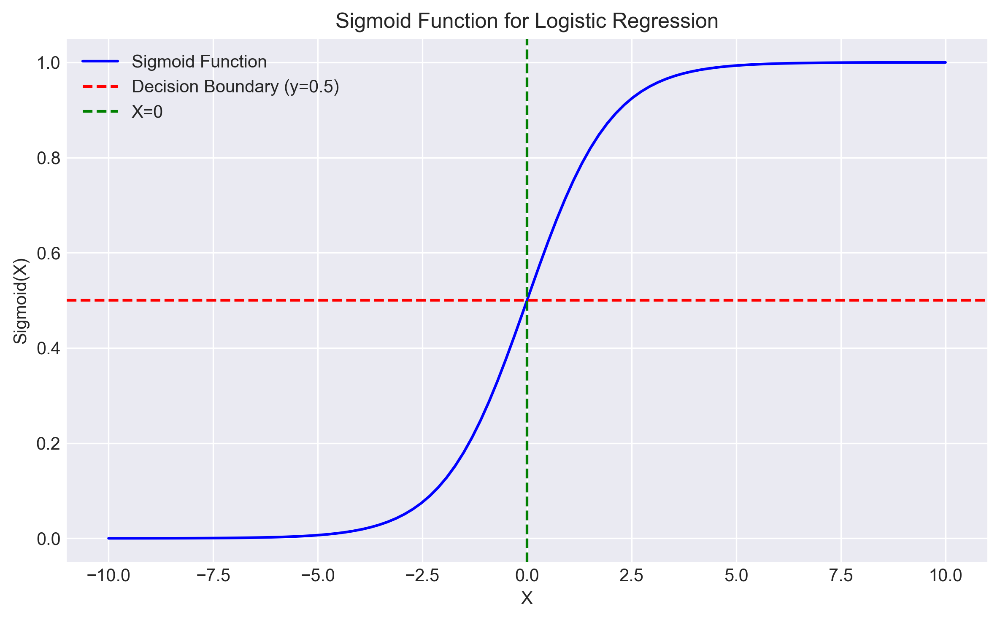

In [17]:
# sigmoid function for logistic regression visualisation
def sigmoid(x):
    return 1 / (1 + np.exp(-x))
# Generate data for logistic regression visualization
x = np.linspace(-10, 10, 100)
y = sigmoid(x)
# Plot the sigmoid function
plt.figure(figsize=(8, 5))
plt.plot(x, y, label='Sigmoid Function', color='blue')
plt.title('Sigmoid Function for Logistic Regression')
plt.xlabel('X')
plt.ylabel('Sigmoid(X)')
plt.axhline(0.5, color='red', linestyle='--', label='Decision Boundary (y=0.5)')
plt.axvline(0, color='green', linestyle='--', label='X=0')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


## Decision Boundaries

C:\Users\Gamitha\AppData\Local\Temp\ipykernel_20300\4214745193.py:28: UserWarning: You passed a edgecolor/edgecolors ('k') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  plt.scatter(X_te[:,0], X_te[:,1], c=y_te, cmap='bwr', edgecolor='k', label='test',  marker='x', s=55)


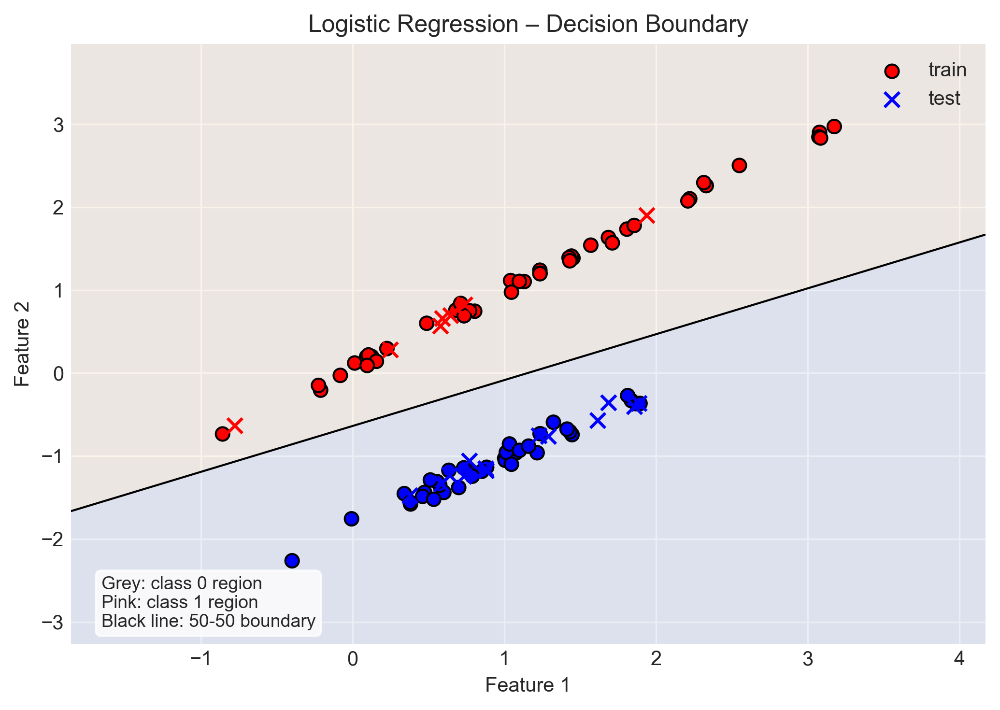

In [18]:
import numpy as np, matplotlib.pyplot as plt
from sklearn.datasets        import make_classification
from sklearn.linear_model    import LogisticRegression
from sklearn.model_selection import train_test_split

# 1) data
X, y = make_classification(n_samples=100, n_features=2, n_informative=2,
                           n_redundant=0, n_clusters_per_class=1, random_state=42)
X_tr, X_te, y_tr, y_te = train_test_split(X, y, test_size=.2, random_state=42)

# 2) model
clf = LogisticRegression().fit(X_tr, y_tr)

# 3) grid
h = .03
x_min, x_max = X[:,0].min()-1, X[:,0].max()+1
y_min, y_max = X[:,1].min()-1, X[:,1].max()+1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h),
                     np.arange(y_min, y_max, h))
Z = clf.predict_proba(np.c_[xx.ravel(), yy.ravel()])[:,1].reshape(xx.shape)

# 4) plot
plt.figure(figsize=(7,5))
plt.contourf(xx, yy, (Z>.5), cmap='Pastel2', alpha=.4)
plt.contour  (xx, yy,  Z, levels=[.5], colors='k', linewidths=1)

plt.scatter(X_tr[:,0], X_tr[:,1], c=y_tr, cmap='bwr', edgecolor='k', label='train', marker='o', s=45)
plt.scatter(X_te[:,0], X_te[:,1], c=y_te, cmap='bwr', edgecolor='k', label='test',  marker='x', s=55)

plt.xlabel('Feature 1'); plt.ylabel('Feature 2')
plt.title('Logistic Regression – Decision Boundary')
plt.legend(loc='upper right')                       # <-- legend moved

# explanatory note
plt.text(x_min+0.2, y_min+0.2,
         'Grey: class 0 region\nPink: class 1 region\nBlack line: 50-50 boundary',
         fontsize=9, bbox=dict(facecolor='white', alpha=.8, boxstyle='round'))

plt.tight_layout()
plt.show()


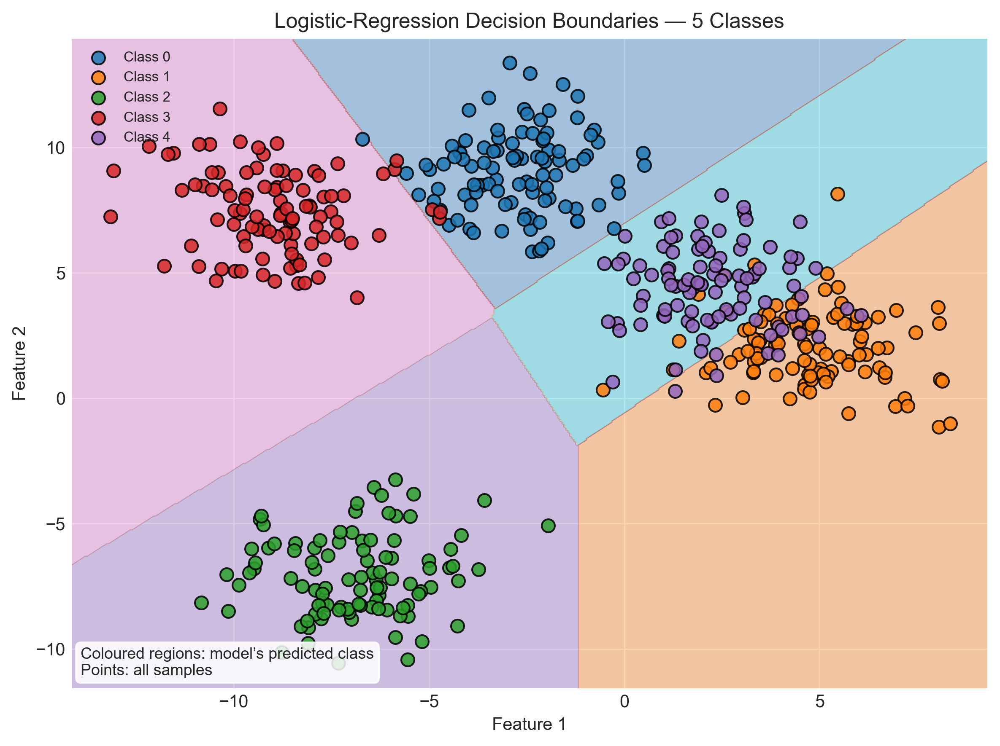

In [19]:
# 1) 2-D blobs → 5 slightly overlapping classes
X, y = make_blobs(n_samples=500, centers=5, n_features=2,
                  cluster_std=1.6, random_state=42)

# 2) Fit multinomial (soft-max) logistic regression
clf = LogisticRegression(multi_class='multinomial', solver='lbfgs')
clf.fit(X, y)

# 3) Build a fine grid → model prediction for each pixel
h = 0.05
x_min, x_max = X[:,0].min() - 1, X[:,0].max() + 1
y_min, y_max = X[:,1].min() - 1, X[:,1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h),
                     np.arange(y_min, y_max, h))
Z = clf.predict(np.c_[xx.ravel(), yy.ravel()]).reshape(xx.shape)

# 4) Plot: coloured decision regions + all points
fig, ax = plt.subplots(figsize=(8, 6))
ax.contourf(xx, yy, Z, cmap='tab10', alpha=.35)      # linear boundaries

for cls in np.unique(y):
    idx = y == cls
    ax.scatter(X[idx,0], X[idx,1],
               c=[plt.cm.tab10(cls)], edgecolor='k',
               s=55, alpha=.85, label=f"Class {cls}")

# one label per class
handles, labels = ax.get_legend_handles_labels()
ax.legend(dict(zip(labels, handles)).values(),
          dict(zip(labels, handles)).keys(),
          fontsize=8, loc='upper left')

ax.set_title("Logistic-Regression Decision Boundaries — 5 Classes")
ax.set_xlabel("Feature 1"); ax.set_ylabel("Feature 2")

# brief on-chart note anchored inside axes
ax.text(0.01, 0.02,
        "Coloured regions: model’s predicted class\nPoints: all samples",
        transform=ax.transAxes, fontsize=9,
        bbox=dict(facecolor='white', alpha=.85, boxstyle='round'))

plt.tight_layout();  plt.show()


## Iris dataset 

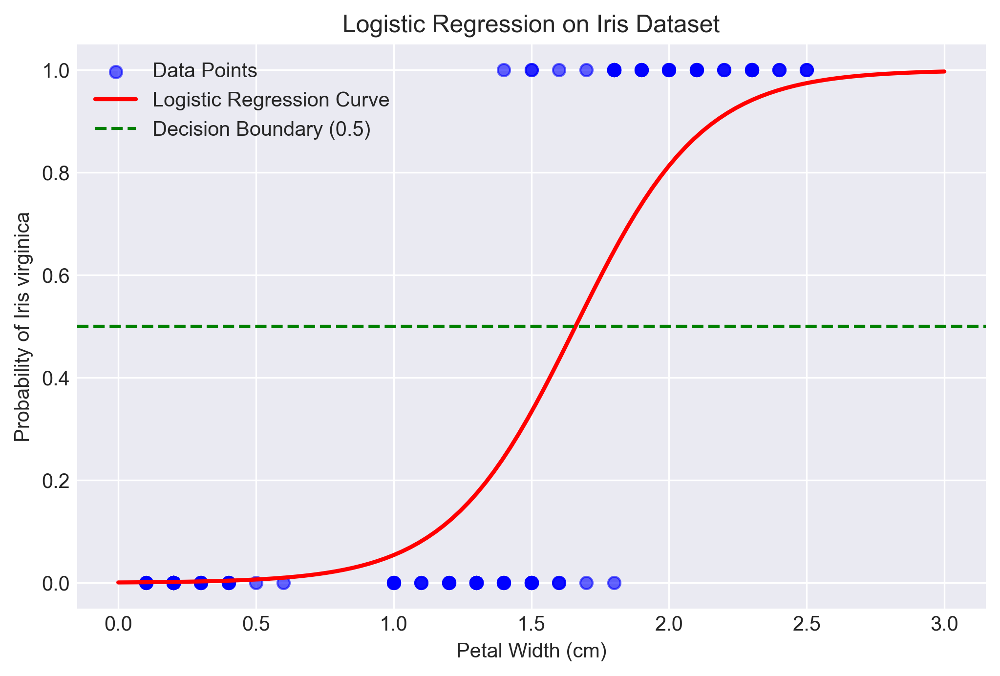

In [20]:
# Let’s use the iris dataset to illustrate Logistic Regression
# Iris dataset is a famous dataset that contains the sepal and petal length and width of 150 iris flowers of three different species: Iris setosa, Iris versicolor, and Iris virginica.
# Let’s build a Logistic Regression classifier to detect the Iris virginica type based only on the petal width feature. 


# Load the iris dataset
iris = load_iris()
X = iris.data[:, 3].reshape(-1, 1)  # Petal width
y = (iris.target == 2).astype(int)  # Binary classification: 1 for Iris virginica, 0 otherwise
# Create a Logistic Regression model
model = LogisticRegression()
# Fit the model to the data
model.fit(X, y)
# Generate a range of values for prediction
X_new = np.linspace(0, 3, 100).reshape(-1, 1)
# Predict probabilities for the new data
y_proba = model.predict_proba(X_new)[:, 1]
# Plot the results
plt.figure(figsize=(8, 5))
plt.scatter(X, y, color='blue', label='Data Points', alpha=0.6)
plt.plot(X_new, y_proba, color='red', label='Logistic Regression Curve', linewidth=2)
plt.axhline(0.5, color='green', linestyle='--', label='Decision Boundary (0.5)')
plt.xlabel('Petal Width (cm)')
plt.ylabel('Probability of Iris virginica')
plt.title('Logistic Regression on Iris Dataset')
plt.legend()
plt.grid(True)
plt.show()



### Multiclass

Accuracy: 0.973
Confusion matrix:
 [[50  0  0]
 [ 0 47  3]
 [ 0  1 49]]

Classification report:
               precision    recall  f1-score   support

      setosa       1.00      1.00      1.00        50
  versicolor       0.98      0.94      0.96        50
   virginica       0.94      0.98      0.96        50

    accuracy                           0.97       150
   macro avg       0.97      0.97      0.97       150
weighted avg       0.97      0.97      0.97       150



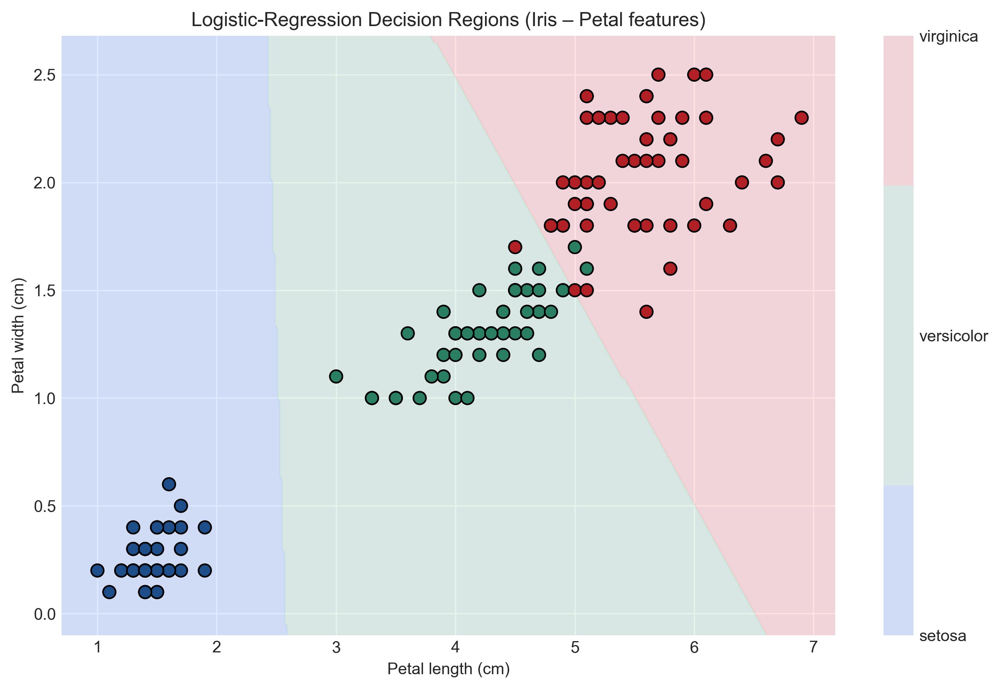

In [21]:
# Imports
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap, BoundaryNorm
from sklearn.datasets import load_iris
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

# Load iris dataset
iris = load_iris()
X, y = iris.data, iris.target
class_names = iris.target_names

# Train multinomial logistic-regression model
model = LogisticRegression(multi_class='multinomial', solver='lbfgs', max_iter=200)
model.fit(X, y)

# Evaluation metrics on entire dataset
y_pred = model.predict(X)
print("Accuracy:", round(accuracy_score(y, y_pred), 3))
print("Confusion matrix:\n", confusion_matrix(y, y_pred))
print("\nClassification report:\n", classification_report(y, y_pred, target_names=class_names))

# Build grid in PETAL-LENGTH × PETAL-WIDTH space (sepal feats fixed at means)
x_min, x_max = X[:, 2].min() - 0.3, X[:, 2].max() + 0.3
y_min, y_max = X[:, 3].min() - 0.2, X[:, 3].max() + 0.2
xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.02),
                     np.arange(y_min, y_max, 0.02))

sepal_len_mean = np.full(xx.size, X[:, 0].mean())
sepal_wid_mean = np.full(xx.size, X[:, 1].mean())
grid = np.c_[sepal_len_mean, sepal_wid_mean, xx.ravel(), yy.ravel()]
Z = model.predict(grid).reshape(xx.shape)

# Plot decision regions + data points
bg_cmap = ListedColormap(["#A0C4FF", "#B7E4C7", "#FFADAD"])
pt_cmap = ListedColormap(["#1D4E89", "#2A7F62", "#B12025"])
norm = BoundaryNorm(np.arange(-0.5, 3.5, 1), bg_cmap.N)

plt.figure(figsize=(9, 6))
im = plt.contourf(xx, yy, Z, cmap=bg_cmap, norm=norm, alpha=0.35)
plt.scatter(X[:, 2], X[:, 3], c=y, cmap=pt_cmap, norm=norm, edgecolor='k', s=60)

plt.xlabel('Petal length (cm)')
plt.ylabel('Petal width (cm)')
plt.title('Logistic-Regression Decision Regions (Iris – Petal features)')

# Discrete colour-bar with class labels
cbar = plt.colorbar(im, ticks=[0, 1, 2])
cbar.ax.set_yticklabels(class_names)

plt.grid(True)
plt.tight_layout()
plt.show()


# Decision Tree
Decision trees are versatile models that can handle both regression and classification tasks. They work by recursively splitting the data based on feature values to create a tree-like structure.
## Concepts
- **Tree Structure**: Nodes represent features, branches represent decisions, and leaves represent outcomes
- **Splitting Criteria**: Gini impurity, entropy for classification; MSE for regression
## Advantages
- **Interpretability**: Easy to visualize and understand
- **Non-linearity**: Can capture complex relationships


Accuracy: 0.96
Confusion matrix:
 [[50  0  0]
 [ 0 49  1]
 [ 0  5 45]]

Classification report:
               precision    recall  f1-score   support

      setosa       1.00      1.00      1.00        50
  versicolor       0.91      0.98      0.94        50
   virginica       0.98      0.90      0.94        50

    accuracy                           0.96       150
   macro avg       0.96      0.96      0.96       150
weighted avg       0.96      0.96      0.96       150



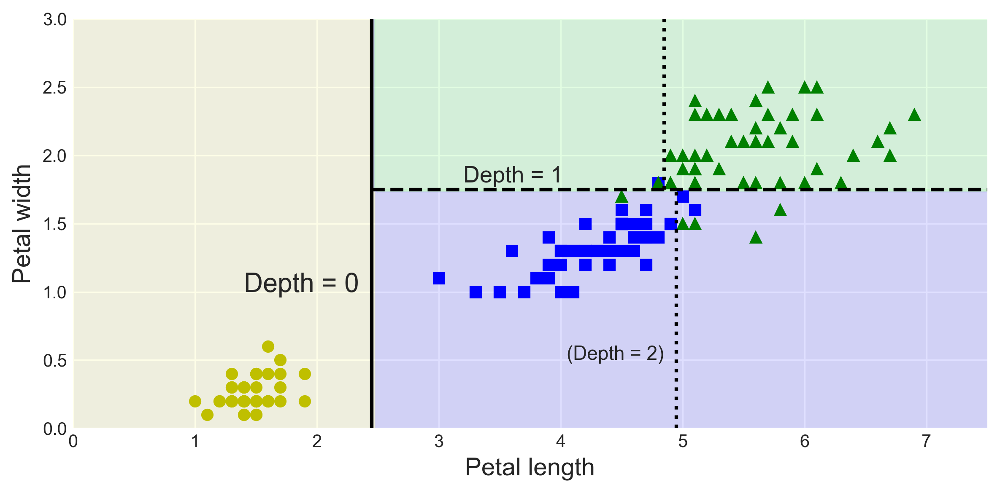

In [22]:

# Decision-tree classification and decision-boundary visual
# on the Iris data (using only the PETAL features)


import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import load_iris
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from matplotlib.colors import ListedColormap

# Load the data  ─────────────────────────────────────────
iris = load_iris()
X = iris.data[:, 2:]      # petal length & width only
y = iris.target           # 3 classes

# Train a shallow decision tree (depth ≤ 2) ─────────────
tree_clf = DecisionTreeClassifier(max_depth=2, random_state=42)
tree_clf.fit(X, y)

# Quick evaluation (on full dataset)  ───────────────────
y_pred = tree_clf.predict(X)
print("Accuracy:", round(accuracy_score(y, y_pred), 3))
print("Confusion matrix:\n", confusion_matrix(y, y_pred))
print("\nClassification report:\n", classification_report(y, y_pred,
                                                         target_names=iris.target_names))

# Helper to plot the decision regions  ──────────────────
def plot_decision_boundary(clf, X, y,
                           axes=[0, 7.5, 0, 3],
                           iris=True, legend=False, plot_training=True):
    """
    Draw the decision regions of a 2-feature classifier.
    • clf  : fitted classifier with predict method
    • X, y : data (N×2) and labels
    • axes : [x_min, x_max, y_min, y_max] for plot limits
    """
    # build a 100×100 grid over the axes range
    x1s = np.linspace(axes[0], axes[1], 100)
    x2s = np.linspace(axes[2], axes[3], 100)
    x1, x2 = np.meshgrid(x1s, x2s)

    # predict class on each grid point
    X_new = np.c_[x1.ravel(), x2.ravel()]
    y_pred = clf.predict(X_new).reshape(x1.shape)

    # pastel background for predicted classes
    custom_cmap = ListedColormap(['#fafab0', '#9898ff', '#a0faa0'])
    plt.contourf(x1, x2, y_pred, alpha=0.3, cmap=custom_cmap)

    # optional darker contour lines
    if not iris:
        custom_cmap2 = ListedColormap(['#7d7d58', '#4c4c7f', '#507d50'])
        plt.contour(x1, x2, y_pred, cmap=custom_cmap2, alpha=0.8)

    # scatter the training points
    if plot_training:
        plt.plot(X[:, 0][y == 0], X[:, 1][y == 0], "yo", label="Iris setosa")
        plt.plot(X[:, 0][y == 1], X[:, 1][y == 1], "bs", label="Iris versicolor")
        plt.plot(X[:, 0][y == 2], X[:, 1][y == 2], "g^", label="Iris virginica")
        plt.axis(axes)

    # Axis labels
    if iris:
        plt.xlabel("Petal length", fontsize=14)
        plt.ylabel("Petal width", fontsize=14)
    else:
        plt.xlabel(r"$x_1$", fontsize=18)
        plt.ylabel(r"$x_2$", fontsize=18, rotation=0)

    if legend:
        plt.legend(loc="lower right", fontsize=14)

# Plot decision boundary with depth annotations  ────────
plt.figure(figsize=(8, 4))
plot_decision_boundary(tree_clf, X, y)

# manual tree-split lines and depth labels
plt.plot([2.45, 2.45], [0, 3], "k-",  linewidth=2)   # depth-0 split
plt.plot([2.45, 7.5],  [1.75, 1.75], "k--", linewidth=2)  # depth-1 split
plt.plot([4.95, 4.95], [0, 1.75], "k:", linewidth=2)      # depth-2 split (left branch)
plt.plot([4.85, 4.85], [1.75, 3], "k:", linewidth=2)      # depth-2 split (right branch)

plt.text(1.40, 1.0, "Depth = 0",  fontsize=15)
plt.text(3.20, 1.80, "Depth = 1", fontsize=13)
plt.text(4.05, 0.50, "(Depth = 2)", fontsize=11)

plt.tight_layout()
plt.show()


# Wine Quality Classification

Loading Wine Quality Dataset...
Dataset Shape: (1599, 12)

Features: 11
Samples: 1599

Column Names:
['fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar', 'chlorides', 'free sulfur dioxide', 'total sulfur dioxide', 'density', 'pH', 'sulphates', 'alcohol', 'quality']

EXPLORATORY DATA ANALYSIS

Dataset Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1599 entries, 0 to 1598
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   fixed acidity         1599 non-null   float64
 1   volatile acidity      1599 non-null   float64
 2   citric acid           1599 non-null   float64
 3   residual sugar        1599 non-null   float64
 4   chlorides             1599 non-null   float64
 5   free sulfur dioxide   1599 non-null   float64
 6   total sulfur dioxide  1599 non-null   float64
 7   density               1599 non-null   float64
 8   pH                    1599 non-null   float64
 9   s

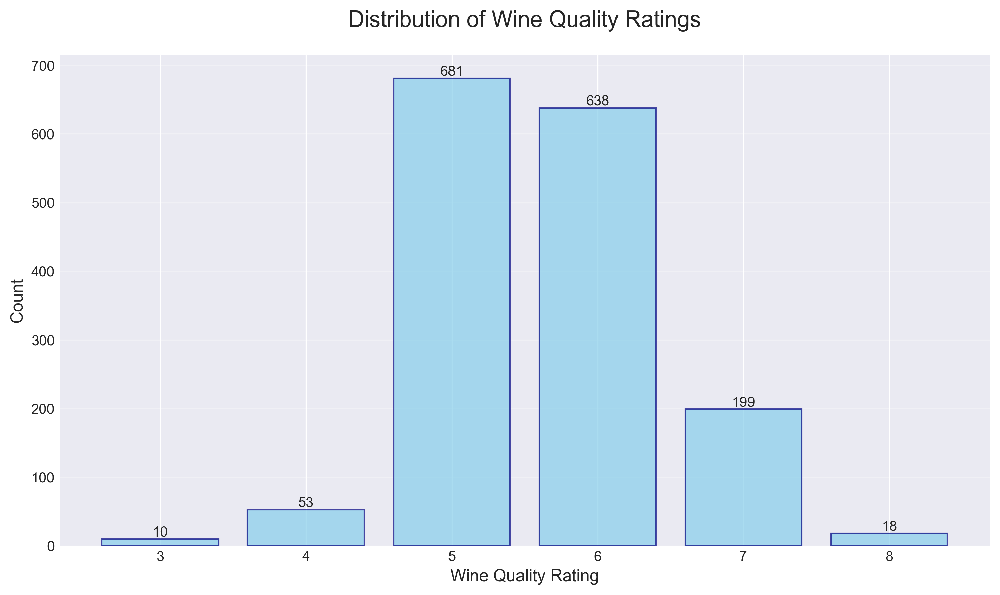

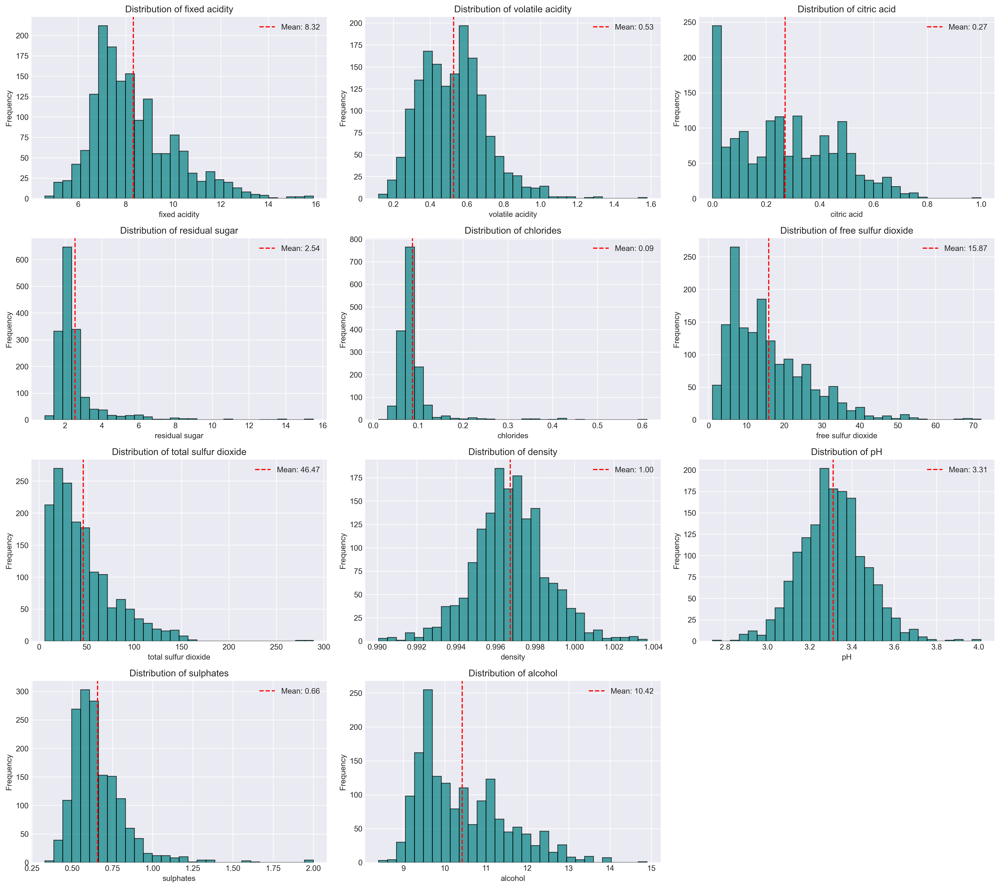

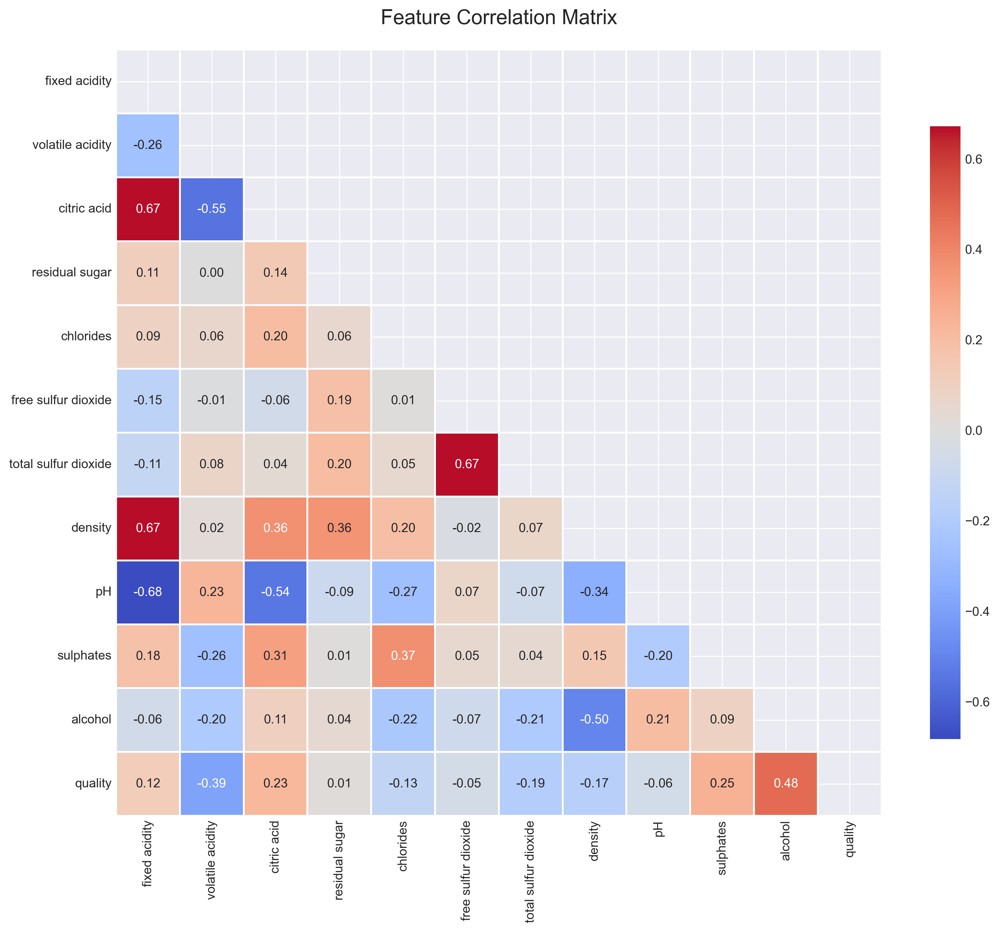

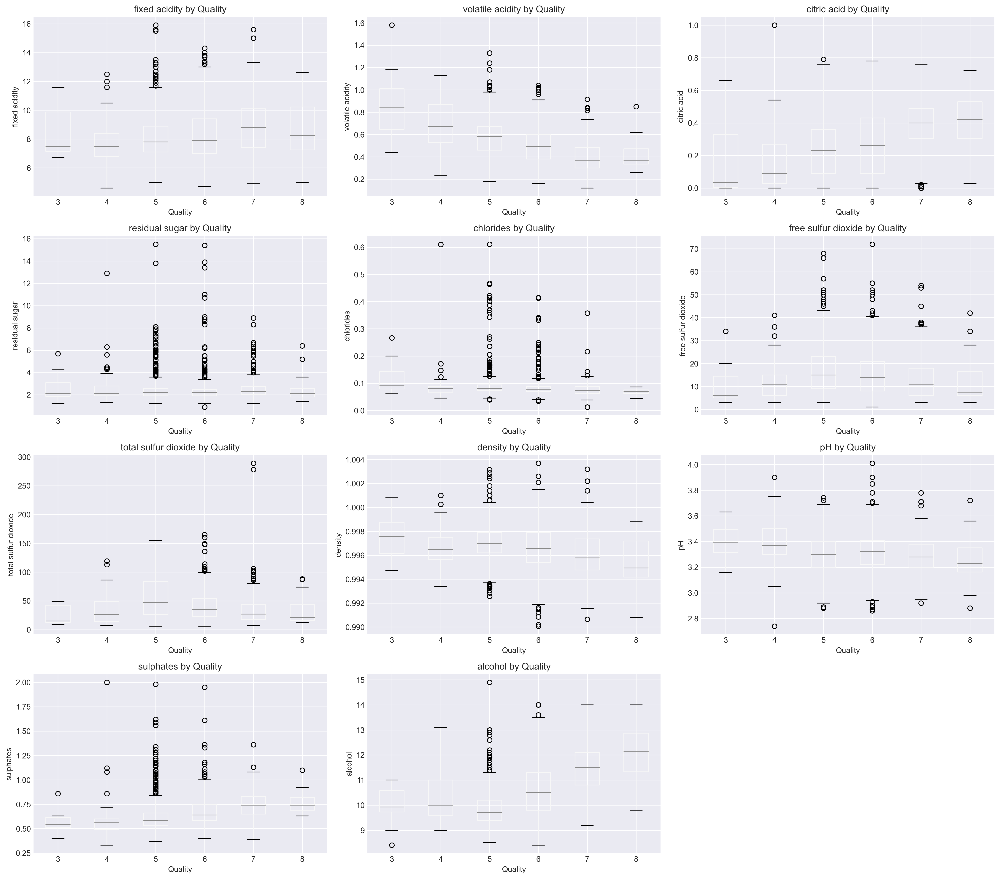

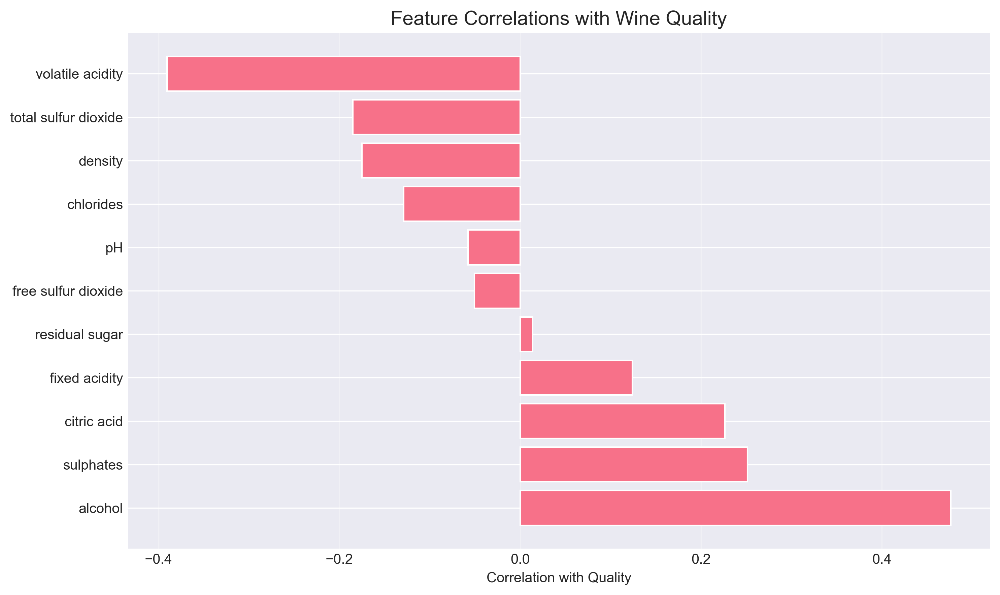


Feature Correlations with Quality:
alcohol                 0.476166
sulphates               0.251397
citric acid             0.226373
fixed acidity           0.124052
residual sugar          0.013732
free sulfur dioxide    -0.050656
pH                     -0.057731
chlorides              -0.128907
density                -0.174919
total sulfur dioxide   -0.185100
volatile acidity       -0.390558
Name: quality, dtype: float64

DATA PREPROCESSING

Quality Categories Distribution:
quality_category
Low       744
Medium    638
High      217
Name: count, dtype: int64

Training set size: (1279, 11)
Test set size: (320, 11)

MODEL IMPLEMENTATION

1. Logistic Regression (with scaling)


e:\studies\ML\projects\ML Learning\House Price Prediction\.venv\lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
e:\studies\ML\projects\ML Learning\House Price Prediction\.venv\lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Test Accuracy: 0.5844

2. Decision Tree (without scaling)
Test Accuracy: 0.6062

MODEL COMPARISON AND EVALUATION

Model Performance Summary:
                 Model  Train Accuracy  Test Accuracy  Train Precision  \
0  Logistic Regression        0.605942       0.584375         0.582992   
1        Decision Tree        1.000000       0.606250         1.000000   

   Test Precision  Train Recall  Test Recall  Train F1   Test F1  \
0        0.567655      0.605942     0.584375  0.567929  0.546082   
1        0.609688      1.000000     0.606250  1.000000  0.606572   

   CV Accuracy Mean  CV Accuracy Std  
0          0.594197         0.017763  
1          0.588735         0.014453  


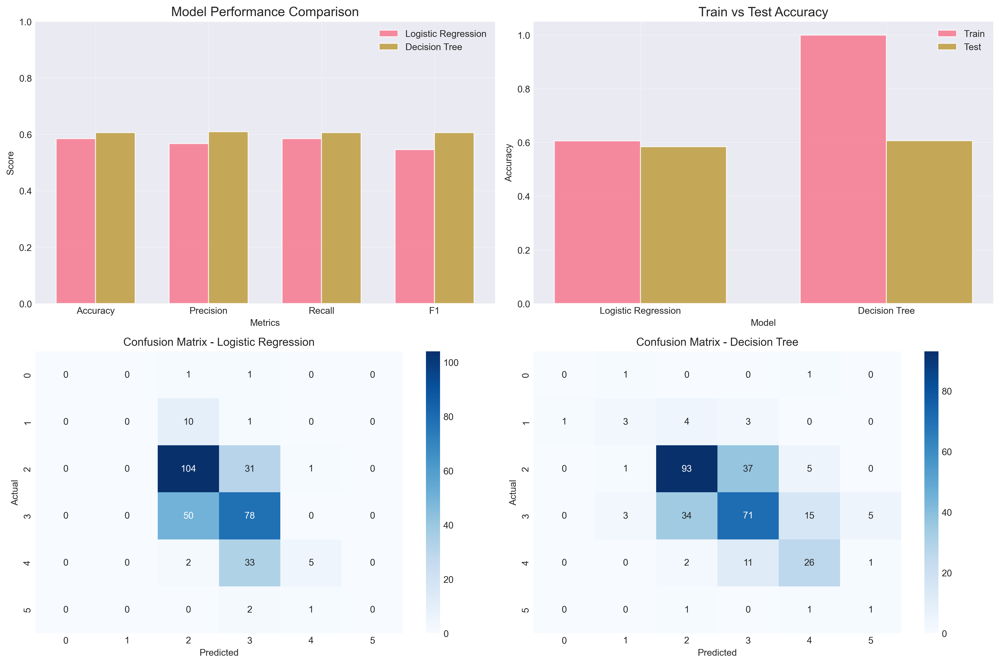


DETAILED CLASSIFICATION REPORTS

Logistic Regression:
              precision    recall  f1-score   support

           3       0.00      0.00      0.00         2
           4       0.00      0.00      0.00        11
           5       0.62      0.76      0.69       136
           6       0.53      0.61      0.57       128
           7       0.71      0.12      0.21        40
           8       0.00      0.00      0.00         3

    accuracy                           0.58       320
   macro avg       0.31      0.25      0.24       320
weighted avg       0.57      0.58      0.55       320


Decision Tree:
              precision    recall  f1-score   support

           3       0.00      0.00      0.00         2
           4       0.38      0.27      0.32        11
           5       0.69      0.68      0.69       136
           6       0.58      0.55      0.57       128
           7       0.54      0.65      0.59        40
           8       0.14      0.33      0.20         3

    ac

e:\studies\ML\projects\ML Learning\House Price Prediction\.venv\lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
e:\studies\ML\projects\ML Learning\House Price Prediction\.venv\lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
e:\studies\ML\projects\ML Learning\House Price Prediction\.venv\lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this beh

Best parameters: {'C': 10, 'penalty': 'l2', 'solver': 'lbfgs'}
Best CV score: 0.5950

Tuning Decision Tree...
Best parameters: {'criterion': 'gini', 'max_depth': 7, 'min_samples_leaf': 1, 'min_samples_split': 2}
Best CV score: 0.5918

Evaluating Tuned Models...

Tuned Logistic Regression Accuracy: 0.5844
Tuned Decision Tree Accuracy: 0.5781

FEATURE IMPORTANCE ANALYSIS

Logistic Regression Feature Importance:
                 Feature  Importance
10               alcohol    1.001013
6   total sulfur dioxide    0.825044
0          fixed acidity    0.758742
1       volatile acidity    0.694018
7                density    0.672639
2            citric acid    0.541626
8                     pH    0.482528
9              sulphates    0.441621
3         residual sugar    0.359428
4              chlorides    0.280609
5    free sulfur dioxide    0.259678

Decision Tree Feature Importance:
                 Feature  Importance
10               alcohol    0.315137
9              sulphates    0.1892

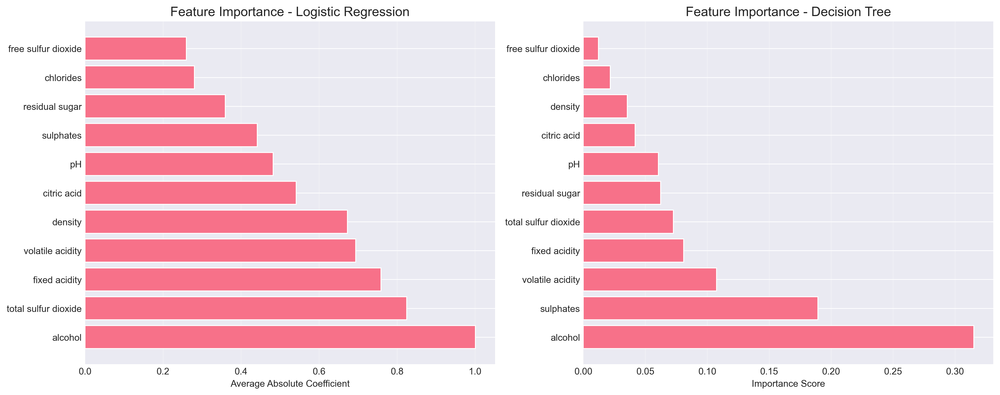

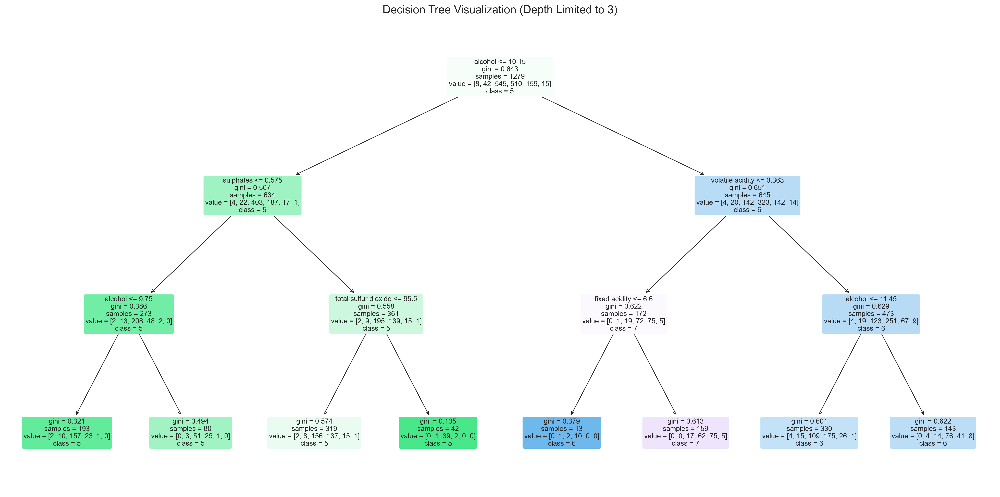


MULTI-CLASS ROC ANALYSIS


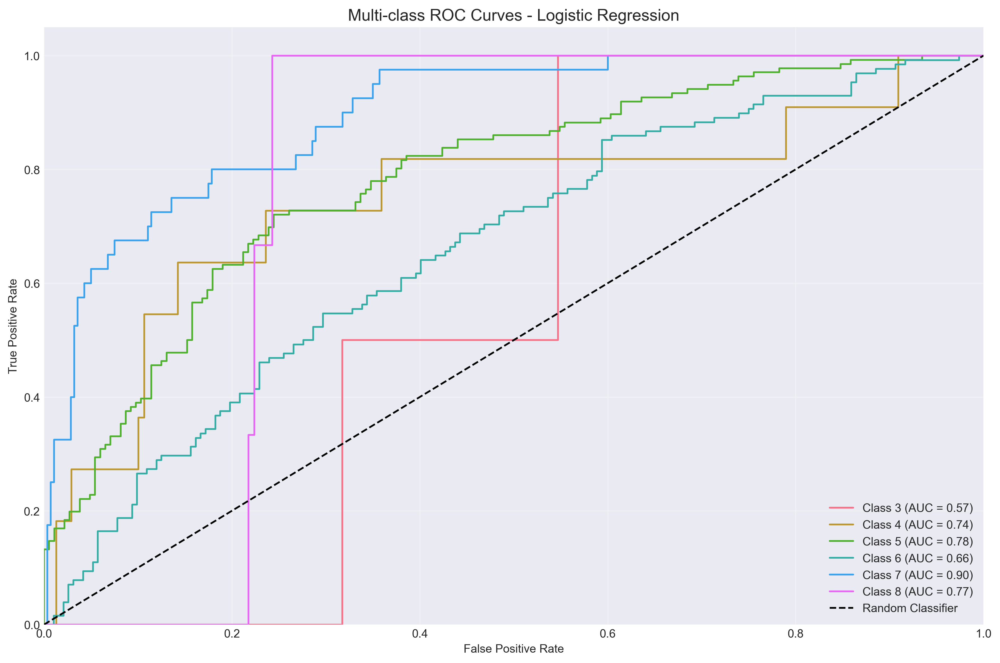


COMPREHENSIVE ANALYSIS SUMMARY

WINE QUALITY CLASSIFICATION ANALYSIS

1. DATASET OVERVIEW:
   - Total samples: 1599
   - Features: 11 physicochemical properties
   - Classes: 6 quality ratings (3, 4, 5, 6, 7, 8)
   - Class distribution: Imbalanced (majority in quality 5-6)

2. INSIGHTS FROM EDA:
   - Most correlated features with quality:
     * Alcohol: 0.476
     * Volatile acidity: -0.391
     * Sulphates: 0.251
   - Quality ratings are concentrated in the middle range (5-6)
   - Features show different distributions across quality levels

3. MODEL PERFORMANCE COMPARISON:

   BASELINE MODELS:
   - Logistic Regression: 58.44% accuracy
   - Decision Tree: 60.62% accuracy

   TUNED MODELS:
   - Tuned Logistic Regression: 58.44% accuracy
     Best parameters: {'C': 10, 'penalty': 'l2', 'solver': 'lbfgs'}
   
   - Tuned Decision Tree: 57.81% accuracy
     Best parameters: {'criterion': 'gini', 'max_depth': 7, 'min_samples_leaf': 1, 'min_samples_split': 2}

4. FEATURE IMPORTANCE:
   - To

In [23]:

# Set style for better visualizations
plt.style.use('seaborn-v0_8-darkgrid')
sns.set_palette("husl")

# Load the Wine Quality dataset
# This dataset is available from UCI ML Repository
# For this example, we'll use the red wine dataset
# URL: https://archive.ics.uci.edu/ml/datasets/wine+quality

print("Loading Wine Quality Dataset...")
print("="*60)

# If you have the dataset locally, use:
# df = pd.read_csv('winequality-red.csv', sep=';')

# Alternative: Load directly from URL
url = "https://archive.ics.uci.edu/ml/machine-learning-databases/wine-quality/winequality-red.csv"
df = pd.read_csv(url, sep=';')

print(f"Dataset Shape: {df.shape}")
print(f"\nFeatures: {df.shape[1]-1}")
print(f"Samples: {df.shape[0]}")
print(f"\nColumn Names:")
print(df.columns.tolist())

# 1. EXPLORATORY DATA ANALYSIS
print("\n" + "="*60)
print("EXPLORATORY DATA ANALYSIS")
print("="*60)

# Basic information
print("\nDataset Info:")
print(df.info())

print("\nFirst 5 rows:")
print(df.head())

print("\nBasic Statistics:")
print(df.describe())

# Check for missing values
print("\nMissing Values:")
print(df.isnull().sum())

# Quality distribution (target variable)
print("\nTarget Variable Distribution:")
quality_counts = df['quality'].value_counts().sort_index()
print(quality_counts)

# Visualize quality distribution
plt.figure(figsize=(10, 6))
bars = plt.bar(quality_counts.index, quality_counts.values, color='skyblue', edgecolor='navy', alpha=0.7)
plt.xlabel('Wine Quality Rating', fontsize=12)
plt.ylabel('Count', fontsize=12)
plt.title('Distribution of Wine Quality Ratings', fontsize=16, pad=20)
plt.grid(axis='y', alpha=0.3)

# Add value labels on bars
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height,
             f'{int(height)}', ha='center', va='bottom')

plt.tight_layout()
plt.show()

# Feature distributions
fig, axes = plt.subplots(4, 3, figsize=(18, 16))
axes = axes.ravel()

for idx, col in enumerate(df.columns[:-1]):  # Exclude 'quality'
    axes[idx].hist(df[col], bins=30, alpha=0.7, color='teal', edgecolor='black')
    axes[idx].set_title(f'Distribution of {col}', fontsize=12)
    axes[idx].set_xlabel(col)
    axes[idx].set_ylabel('Frequency')
    
    # Add mean line
    mean_val = df[col].mean()
    axes[idx].axvline(mean_val, color='red', linestyle='--', 
                      label=f'Mean: {mean_val:.2f}')
    axes[idx].legend()

# Remove empty subplot
if len(df.columns[:-1]) < len(axes):
    fig.delaxes(axes[-1])

plt.tight_layout()
plt.show()

# Correlation matrix
plt.figure(figsize=(12, 10))
correlation_matrix = df.corr()
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))
sns.heatmap(correlation_matrix, mask=mask, annot=True, fmt='.2f', 
            cmap='coolwarm', center=0, square=True, linewidths=1, 
            cbar_kws={"shrink": .8})
plt.title('Feature Correlation Matrix', fontsize=16, pad=20)
plt.tight_layout()
plt.show()

# Box plots for each feature by quality
fig, axes = plt.subplots(4, 3, figsize=(18, 16))
axes = axes.ravel()

for idx, col in enumerate(df.columns[:-1]):
    df.boxplot(column=col, by='quality', ax=axes[idx])
    axes[idx].set_title(f'{col} by Quality', fontsize=12)
    axes[idx].set_xlabel('Quality')
    axes[idx].set_ylabel(col)
    axes[idx].get_figure().suptitle('')

if len(df.columns[:-1]) < len(axes):
    fig.delaxes(axes[-1])

plt.tight_layout()
plt.show()

# Feature importance based on correlation with quality
feature_correlations = df.corr()['quality'].drop('quality').sort_values(ascending=False)
plt.figure(figsize=(10, 6))
plt.barh(feature_correlations.index, feature_correlations.values)
plt.xlabel('Correlation with Quality')
plt.title('Feature Correlations with Wine Quality', fontsize=14)
plt.grid(axis='x', alpha=0.3)
plt.tight_layout()
plt.show()

print("\nFeature Correlations with Quality:")
print(feature_correlations)

# 2. DATA PREPROCESSING
print("\n" + "="*60)
print("DATA PREPROCESSING")
print("="*60)

# For multi-class classification, we'll keep all quality levels
# But we'll also create a simplified version (Low, Medium, High)

# Original quality distribution
X = df.drop('quality', axis=1)
y = df['quality']

# Create quality categories for additional analysis
df['quality_category'] = pd.cut(df['quality'], bins=[0, 5, 6, 10], 
                                labels=['Low', 'Medium', 'High'])

print("\nQuality Categories Distribution:")
print(df['quality_category'].value_counts())

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, 
                                                    random_state=42, stratify=y)

print(f"\nTraining set size: {X_train.shape}")
print(f"Test set size: {X_test.shape}")

# Scale the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# 3. MODEL IMPLEMENTATION
print("\n" + "="*60)
print("MODEL IMPLEMENTATION")
print("="*60)

# Initialize models
models = {
    'Logistic Regression': LogisticRegression(multi_class='ovr', max_iter=1000, random_state=42),
    'Decision Tree': DecisionTreeClassifier(random_state=42)
}

# Function to evaluate models
def evaluate_model(model, X_train, X_test, y_train, y_test, model_name):
    # Fit the model
    model.fit(X_train, y_train)
    
    # Make predictions
    y_train_pred = model.predict(X_train)
    y_test_pred = model.predict(X_test)
    
    # Calculate metrics
    train_accuracy = accuracy_score(y_train, y_train_pred)
    test_accuracy = accuracy_score(y_test, y_test_pred)
    
    # For multi-class, we use macro and weighted averages
    train_precision = precision_score(y_train, y_train_pred, average='weighted')
    test_precision = precision_score(y_test, y_test_pred, average='weighted')
    
    train_recall = recall_score(y_train, y_train_pred, average='weighted')
    test_recall = recall_score(y_test, y_test_pred, average='weighted')
    
    train_f1 = f1_score(y_train, y_train_pred, average='weighted')
    test_f1 = f1_score(y_test, y_test_pred, average='weighted')
    
    # Cross-validation
    cv_scores = cross_val_score(model, X_train, y_train, cv=5, scoring='accuracy')
    
    results = {
        'Model': model_name,
        'Train Accuracy': train_accuracy,
        'Test Accuracy': test_accuracy,
        'Train Precision': train_precision,
        'Test Precision': test_precision,
        'Train Recall': train_recall,
        'Test Recall': test_recall,
        'Train F1': train_f1,
        'Test F1': test_f1,
        'CV Accuracy Mean': cv_scores.mean(),
        'CV Accuracy Std': cv_scores.std()
    }
    
    return results, y_test_pred, model

# Train and evaluate models
results_list = []
predictions = {}
trained_models = {}

print("\n1. Logistic Regression (with scaling)")
lr_model = LogisticRegression(multi_class='ovr', max_iter=1000, random_state=42)
lr_results, lr_pred, lr_trained = evaluate_model(lr_model, X_train_scaled, X_test_scaled, 
                                                 y_train, y_test, 'Logistic Regression')
results_list.append(lr_results)
predictions['Logistic Regression'] = lr_pred
trained_models['Logistic Regression'] = lr_trained
print(f"Test Accuracy: {lr_results['Test Accuracy']:.4f}")

print("\n2. Decision Tree (without scaling)")
dt_model = DecisionTreeClassifier(random_state=42)
dt_results, dt_pred, dt_trained = evaluate_model(dt_model, X_train, X_test, 
                                                 y_train, y_test, 'Decision Tree')
results_list.append(dt_results)
predictions['Decision Tree'] = dt_pred
trained_models['Decision Tree'] = dt_trained
print(f"Test Accuracy: {dt_results['Test Accuracy']:.4f}")

# 4. MODEL COMPARISON AND EVALUATION
print("\n" + "="*60)
print("MODEL COMPARISON AND EVALUATION")
print("="*60)

# Create results dataframe
results_df = pd.DataFrame(results_list)
print("\nModel Performance Summary:")
print(results_df)

# Visualization of results
fig, axes = plt.subplots(2, 2, figsize=(15, 10))

# Accuracy Comparison
ax1 = axes[0, 0]
metrics = ['Accuracy', 'Precision', 'Recall', 'F1']
x = np.arange(len(metrics))
width = 0.35

for i, model_name in enumerate(['Logistic Regression', 'Decision Tree']):
    model_results = results_df[results_df['Model'] == model_name]
    values = [model_results[f'Test {m}'].values[0] for m in metrics]
    ax1.bar(x + i*width, values, width, label=model_name, alpha=0.8)

ax1.set_xlabel('Metrics')
ax1.set_ylabel('Score')
ax1.set_title('Model Performance Comparison', fontsize=14)
ax1.set_xticks(x + width/2)
ax1.set_xticklabels(metrics)
ax1.legend()
ax1.grid(True, alpha=0.3)
ax1.set_ylim(0, 1)

# Train vs Test Accuracy
ax2 = axes[0, 1]
models_names = results_df['Model']
train_acc = results_df['Train Accuracy']
test_acc = results_df['Test Accuracy']

x = np.arange(len(models_names))
ax2.bar(x - width/2, train_acc, width, label='Train', alpha=0.8)
ax2.bar(x + width/2, test_acc, width, label='Test', alpha=0.8)
ax2.set_xlabel('Model')
ax2.set_ylabel('Accuracy')
ax2.set_title('Train vs Test Accuracy', fontsize=14)
ax2.set_xticks(x)
ax2.set_xticklabels(models_names)
ax2.legend()
ax2.grid(True, alpha=0.3)

# Confusion Matrices
for idx, (model_name, pred) in enumerate(predictions.items()):
    ax = axes[1, idx]
    cm = confusion_matrix(y_test, pred)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', ax=ax)
    ax.set_title(f'Confusion Matrix - {model_name}', fontsize=12)
    ax.set_xlabel('Predicted')
    ax.set_ylabel('Actual')

plt.tight_layout()
plt.show()

# Detailed Classification Reports
print("\n" + "="*40)
print("DETAILED CLASSIFICATION REPORTS")
print("="*40)

for model_name, pred in predictions.items():
    print(f"\n{model_name}:")
    print(classification_report(y_test, pred))

# 5. HYPERPARAMETER TUNING
print("\n" + "="*60)
print("HYPERPARAMETER TUNING")
print("="*60)

# Grid Search for Logistic Regression
print("\nTuning Logistic Regression...")
lr_param_grid = {
    'C': [0.001, 0.01, 0.1, 1, 10, 100],
    'solver': ['lbfgs', 'liblinear', 'saga'],
    'penalty': ['l2']
}

lr_grid = GridSearchCV(LogisticRegression(multi_class='ovr', max_iter=1000, random_state=42),
                       lr_param_grid, cv=5, scoring='accuracy', n_jobs=-1)
lr_grid.fit(X_train_scaled, y_train)

print(f"Best parameters: {lr_grid.best_params_}")
print(f"Best CV score: {lr_grid.best_score_:.4f}")

# Grid Search for Decision Tree
print("\nTuning Decision Tree...")
dt_param_grid = {
    'max_depth': [3, 5, 7, 10, None],
    'min_samples_split': [2, 5, 10, 20],
    'min_samples_leaf': [1, 2, 4, 8],
    'criterion': ['gini', 'entropy']
}

dt_grid = GridSearchCV(DecisionTreeClassifier(random_state=42),
                       dt_param_grid, cv=5, scoring='accuracy', n_jobs=-1)
dt_grid.fit(X_train, y_train)

print(f"Best parameters: {dt_grid.best_params_}")
print(f"Best CV score: {dt_grid.best_score_:.4f}")

# Evaluate best models
print("\nEvaluating Tuned Models...")
best_lr_pred = lr_grid.predict(X_test_scaled)
best_dt_pred = dt_grid.predict(X_test)

print(f"\nTuned Logistic Regression Accuracy: {accuracy_score(y_test, best_lr_pred):.4f}")
print(f"Tuned Decision Tree Accuracy: {accuracy_score(y_test, best_dt_pred):.4f}")

# 6. FEATURE IMPORTANCE ANALYSIS
print("\n" + "="*60)
print("FEATURE IMPORTANCE ANALYSIS")
print("="*60)

# Logistic Regression coefficients (for one-vs-rest)
# We'll look at the average absolute coefficients across all classes
lr_coef = np.abs(lr_grid.best_estimator_.coef_).mean(axis=0)
lr_feature_importance = pd.DataFrame({
    'Feature': X.columns,
    'Importance': lr_coef
}).sort_values('Importance', ascending=False)

print("\nLogistic Regression Feature Importance:")
print(lr_feature_importance)

# Decision Tree feature importance
dt_feature_importance = pd.DataFrame({
    'Feature': X.columns,
    'Importance': dt_grid.best_estimator_.feature_importances_
}).sort_values('Importance', ascending=False)

print("\nDecision Tree Feature Importance:")
print(dt_feature_importance)

# Visualize feature importance
fig, axes = plt.subplots(1, 2, figsize=(15, 6))

# Logistic Regression
axes[0].barh(lr_feature_importance['Feature'], lr_feature_importance['Importance'])
axes[0].set_xlabel('Average Absolute Coefficient')
axes[0].set_title('Feature Importance - Logistic Regression', fontsize=14)
axes[0].grid(axis='x', alpha=0.3)

# Decision Tree
axes[1].barh(dt_feature_importance['Feature'], dt_feature_importance['Importance'])
axes[1].set_xlabel('Importance Score')
axes[1].set_title('Feature Importance - Decision Tree', fontsize=14)
axes[1].grid(axis='x', alpha=0.3)

plt.tight_layout()
plt.show()

# Visualize the Decision Tree (limited depth for clarity)
plt.figure(figsize=(20, 10))
plot_tree(DecisionTreeClassifier(max_depth=3, random_state=42).fit(X_train, y_train),
          feature_names=X.columns, class_names=[str(i) for i in sorted(y.unique())],
          filled=True, rounded=True, fontsize=10)
plt.title('Decision Tree Visualization (Depth Limited to 3)', fontsize=16)
plt.tight_layout()
plt.show()

# 7. MULTI-CLASS ROC CURVES
print("\n" + "="*60)
print("MULTI-CLASS ROC ANALYSIS")
print("="*60)

# Binarize the output for multi-class ROC
y_test_binarized = label_binarize(y_test, classes=sorted(y.unique()))
n_classes = y_test_binarized.shape[1]

# Compute ROC curve for each class (Logistic Regression)
lr_proba = lr_grid.predict_proba(X_test_scaled)

plt.figure(figsize=(12, 8))
for i in range(n_classes):
    fpr, tpr, _ = roc_curve(y_test_binarized[:, i], lr_proba[:, i])
    roc_auc = auc(fpr, tpr)
    plt.plot(fpr, tpr, label=f'Class {sorted(y.unique())[i]} (AUC = {roc_auc:.2f})')

plt.plot([0, 1], [0, 1], 'k--', label='Random Classifier')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Multi-class ROC Curves - Logistic Regression', fontsize=14)
plt.legend(loc="lower right")
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# 8. SUMMARY REPORT
print("\n" + "="*60)
print("COMPREHENSIVE ANALYSIS SUMMARY")
print("="*60)

print(f"""
WINE QUALITY CLASSIFICATION ANALYSIS
=====================================

1. DATASET OVERVIEW:
   - Total samples: {len(df)}
   - Features: {X.shape[1]} physicochemical properties
   - Classes: {len(y.unique())} quality ratings ({', '.join(map(str, sorted(y.unique())))})
   - Class distribution: Imbalanced (majority in quality 5-6)

2. INSIGHTS FROM EDA:
   - Most correlated features with quality:
     * Alcohol: {feature_correlations['alcohol']:.3f}
     * Volatile acidity: {feature_correlations['volatile acidity']:.3f}
     * Sulphates: {feature_correlations['sulphates']:.3f}
   - Quality ratings are concentrated in the middle range (5-6)
   - Features show different distributions across quality levels

3. MODEL PERFORMANCE COMPARISON:

   BASELINE MODELS:
   - Logistic Regression: {lr_results['Test Accuracy']:.2%} accuracy
   - Decision Tree: {dt_results['Test Accuracy']:.2%} accuracy

   TUNED MODELS:
   - Tuned Logistic Regression: {accuracy_score(y_test, best_lr_pred):.2%} accuracy
     Best parameters: {lr_grid.best_params_}
   
   - Tuned Decision Tree: {accuracy_score(y_test, best_dt_pred):.2%} accuracy
     Best parameters: {dt_grid.best_params_}

4. FEATURE IMPORTANCE:
   - Top 3 features (Decision Tree):
""")

for idx, row in dt_feature_importance.head(3).iterrows():
    print(f"     * {row['Feature']}: {row['Importance']:.3f}")

print(f"""

""")

# Save results
results_summary = pd.DataFrame({
    'Model': ['Logistic Regression', 'Decision Tree', 'Tuned LR', 'Tuned DT'],
    'Test Accuracy': [
        lr_results['Test Accuracy'],
        dt_results['Test Accuracy'],
        accuracy_score(y_test, best_lr_pred),
        accuracy_score(y_test, best_dt_pred)
    ]
})

results_summary.to_csv('wine_classification_results.csv', index=False)
print("\nResults saved to 'wine_classification_results.csv'")

# Feature importance comparison
feature_importance_comparison = pd.merge(
    lr_feature_importance.rename(columns={'Importance': 'LR_Importance'}),
    dt_feature_importance.rename(columns={'Importance': 'DT_Importance'}),
    on='Feature'
)
feature_importance_comparison.to_csv('feature_importance_comparison.csv', index=False)
print("Feature importance comparison saved to 'feature_importance_comparison.csv'")

# Overfitting, Underfitting, and Bias-Variance Tradeoff

## Overview
Models must generalize, not just memorize training data. Understanding the bias-variance tradeoff is crucial for building robust models.

Bias-Variance Tradeoff Demonstration


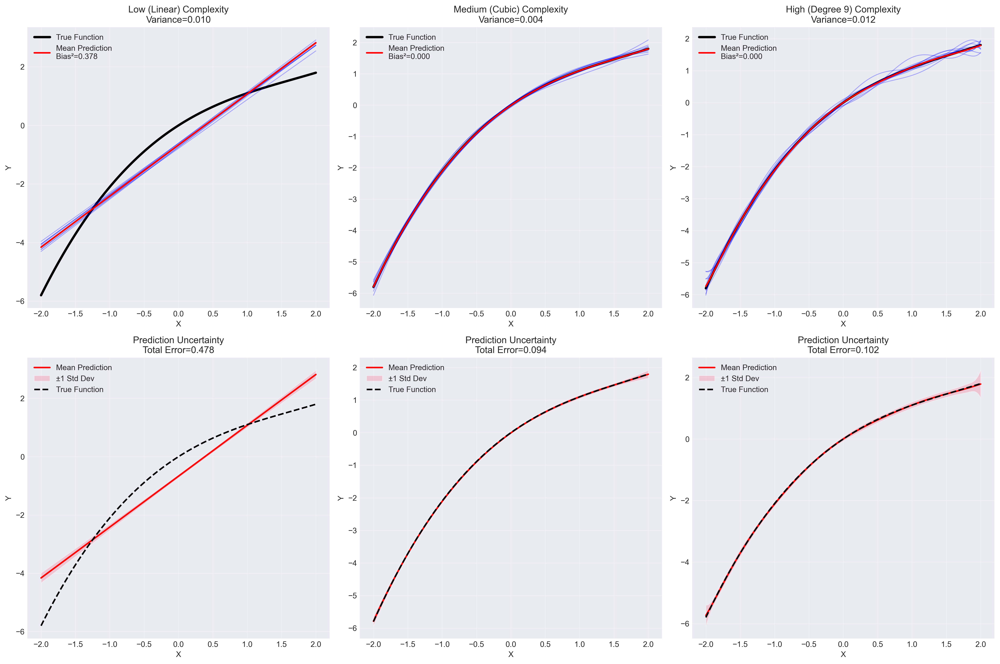

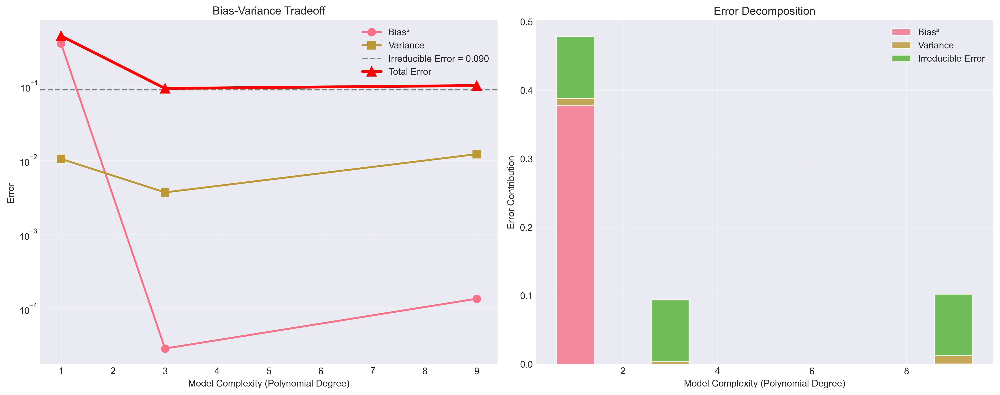


Bias-Variance Decomposition Results:
Degree | Bias²     | Variance  | Irreducible | Total Error | Interpretation
--------------------------------------------------------------------------------
   1   |   0.3778  |   0.0105  |     0.0900  |     0.4783  | High Bias, Low Variance (Underfitting)
   3   |   0.0000  |   0.0037  |     0.0900  |     0.0937  | Balanced Bias-Variance (Good Fit)
   9   |   0.0001  |   0.0122  |     0.0900  |     0.1023  | Low Bias, High Variance (Overfitting)

Key Mathematical Insight:
Total Error = Bias² + Variance + Irreducible Error
- Bias: How far off is the average prediction from the true value?
- Variance: How much do predictions vary across different datasets?
- Irreducible Error: Noise in the data that cannot be reduced


In [24]:
# Comprehensive bias-variance tradeoff demonstration
print("Bias-Variance Tradeoff Demonstration")
print("=" * 40)

# Create true function and noisy data
np.random.seed(42)
n_samples = 100
noise_level = 0.3

def true_function(x):
    return 1.5 * x - 0.5 * x**2 + 0.1 * x**3

X_true = np.linspace(-2, 2, 200).reshape(-1, 1)
y_true = true_function(X_true.flatten())

# Generate multiple datasets to show variance
n_datasets = 50
datasets = []

for i in range(n_datasets):
    X_sample = np.random.uniform(-2, 2, n_samples).reshape(-1, 1)
    y_sample = true_function(X_sample.flatten()) + np.random.normal(0, noise_level, n_samples)
    datasets.append((X_sample, y_sample))

# Test different model complexities
complexities = [1, 3, 9]  # polynomial degrees
complexity_names = ['Low (Linear)', 'Medium (Cubic)', 'High (Degree 9)']

fig, axes = plt.subplots(2, 3, figsize=(18, 12))

bias_variance_results = {}

for idx, (degree, name) in enumerate(zip(complexities, complexity_names)):
    predictions = []
    
    # Train models on multiple datasets
    for X_sample, y_sample in datasets:
        # Create polynomial features
        poly_features = PolynomialFeatures(degree=degree, include_bias=False)
        X_poly = poly_features.fit_transform(X_sample)
        X_true_poly = poly_features.transform(X_true)
        
        # Fit model
        model = LinearRegression()
        model.fit(X_poly, y_sample)
        
        # Predict on test points
        y_pred = model.predict(X_true_poly)
        predictions.append(y_pred)
    
    predictions = np.array(predictions)
    
    # Calculate bias and variance
    mean_prediction = np.mean(predictions, axis=0)
    bias_squared = np.mean((mean_prediction - y_true)**2)
    variance = np.mean(np.var(predictions, axis=0))
    irreducible_error = noise_level**2
    total_error = bias_squared + variance + irreducible_error
    
    bias_variance_results[degree] = {
        'bias_squared': bias_squared,
        'variance': variance,
        'irreducible_error': irreducible_error,
        'total_error': total_error,
        'predictions': predictions,
        'mean_prediction': mean_prediction
    }
    
    # Plot individual predictions
    axes[0, idx].plot(X_true, y_true, 'k-', linewidth=3, label='True Function')
    
    # Show first 10 predictions to avoid clutter
    for i in range(min(10, len(predictions))):
        axes[0, idx].plot(X_true, predictions[i], 'b-', alpha=0.3, linewidth=1)
    
    axes[0, idx].plot(X_true, mean_prediction, 'r-', linewidth=2, 
                      label=f'Mean Prediction\nBias²={bias_squared:.3f}')
    axes[0, idx].set_title(f'{name} Complexity\nVariance={variance:.3f}')
    axes[0, idx].set_xlabel('X')
    axes[0, idx].set_ylabel('Y')
    axes[0, idx].legend()
    axes[0, idx].grid(True, alpha=0.3)
    
    # Plot variance visualization
    prediction_std = np.std(predictions, axis=0)
    axes[1, idx].plot(X_true, mean_prediction, 'r-', linewidth=2, label='Mean Prediction')
    axes[1, idx].fill_between(X_true.flatten(), 
                              mean_prediction - prediction_std, 
                              mean_prediction + prediction_std, 
                              alpha=0.3, label='±1 Std Dev')
    axes[1, idx].plot(X_true, y_true, 'k--', linewidth=2, label='True Function')
    axes[1, idx].set_title(f'Prediction Uncertainty\nTotal Error={total_error:.3f}')
    axes[1, idx].set_xlabel('X')
    axes[1, idx].set_ylabel('Y')
    axes[1, idx].legend()
    axes[1, idx].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# Plot bias-variance decomposition
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))

# Extract results for plotting
degrees = list(bias_variance_results.keys())
bias_squared_vals = [bias_variance_results[d]['bias_squared'] for d in degrees]
variance_vals = [bias_variance_results[d]['variance'] for d in degrees]
irreducible_vals = [bias_variance_results[d]['irreducible_error'] for d in degrees]
total_error_vals = [bias_variance_results[d]['total_error'] for d in degrees]

# Bias-Variance tradeoff plot
ax1.plot(degrees, bias_squared_vals, 'o-', linewidth=2, markersize=8, label='Bias²')
ax1.plot(degrees, variance_vals, 's-', linewidth=2, markersize=8, label='Variance')
ax1.axhline(y=irreducible_vals[0], color='gray', linestyle='--', 
            label=f'Irreducible Error = {irreducible_vals[0]:.3f}')
ax1.plot(degrees, total_error_vals, '^-', linewidth=3, markersize=10, 
         color='red', label='Total Error')
ax1.set_xlabel('Model Complexity (Polynomial Degree)')
ax1.set_ylabel('Error')
ax1.set_title('Bias-Variance Tradeoff')
ax1.legend()
ax1.grid(True, alpha=0.3)
ax1.set_yscale('log')

# Stacked bar chart showing error decomposition
ax2.bar(degrees, bias_squared_vals, label='Bias²', alpha=0.8)
ax2.bar(degrees, variance_vals, bottom=bias_squared_vals, label='Variance', alpha=0.8)
ax2.bar(degrees, irreducible_vals, 
        bottom=np.array(bias_squared_vals) + np.array(variance_vals), 
        label='Irreducible Error', alpha=0.8)
ax2.set_xlabel('Model Complexity (Polynomial Degree)')
ax2.set_ylabel('Error Contribution')
ax2.set_title('Error Decomposition')
ax2.legend()
ax2.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# Print detailed results
print("\nBias-Variance Decomposition Results:")
print("Degree | Bias²     | Variance  | Irreducible | Total Error | Interpretation")
print("-" * 80)
interpretations = ['High Bias, Low Variance (Underfitting)', 
                  'Balanced Bias-Variance (Good Fit)', 
                  'Low Bias, High Variance (Overfitting)']

for i, degree in enumerate(degrees):
    r = bias_variance_results[degree]
    print(f"  {degree:2d}   | {r['bias_squared']:8.4f}  | {r['variance']:8.4f}  | {r['irreducible_error']:10.4f}  | {r['total_error']:10.4f}  | {interpretations[i]}")

print("\nKey Mathematical Insight:")
print("Total Error = Bias² + Variance + Irreducible Error")
print("- Bias: How far off is the average prediction from the true value?")
print("- Variance: How much do predictions vary across different datasets?")
print("- Irreducible Error: Noise in the data that cannot be reduced")

# Scikit-learn and Regularization

## Overview
Scikit-learn provides a unified API for machine learning. Regularization adds penalties to prevent overfitting by constraining model complexity.

In [25]:
# Comprehensive regularization demonstration
print("Regularization Techniques Demonstration")
print("=" * 40)

# Load California housing dataset
housing = fetch_california_housing()
X_housing = pd.DataFrame(housing.data, columns=housing.feature_names)
y_housing = housing.target

print(f"Dataset: {X_housing.shape[0]} samples, {X_housing.shape[1]} features")
print(f"Features: {list(X_housing.columns)}")
print(f"Target: Median house value (hundreds of thousands)")

# Add polynomial features to create potential overfitting
poly_features = PolynomialFeatures(degree=2, include_bias=False, interaction_only=False)
X_poly = poly_features.fit_transform(X_housing)
feature_names_poly = poly_features.get_feature_names_out(X_housing.columns)

print(f"After polynomial expansion: {X_poly.shape[1]} features")

# Split data
X_train, X_test, y_train, y_test = train_test_split(
    X_poly, y_housing, test_size=0.2, random_state=42
)

# Scale features (important for regularization)
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

print("\nData preprocessing complete!")
print(f"Training set: {X_train_scaled.shape}")
print(f"Test set: {X_test_scaled.shape}")

Regularization Techniques Demonstration
Dataset: 20640 samples, 8 features
Features: ['MedInc', 'HouseAge', 'AveRooms', 'AveBedrms', 'Population', 'AveOccup', 'Latitude', 'Longitude']
Target: Median house value (hundreds of thousands)
After polynomial expansion: 44 features

Data preprocessing complete!
Training set: (16512, 44)
Test set: (4128, 44)



Comparing Regularization Techniques


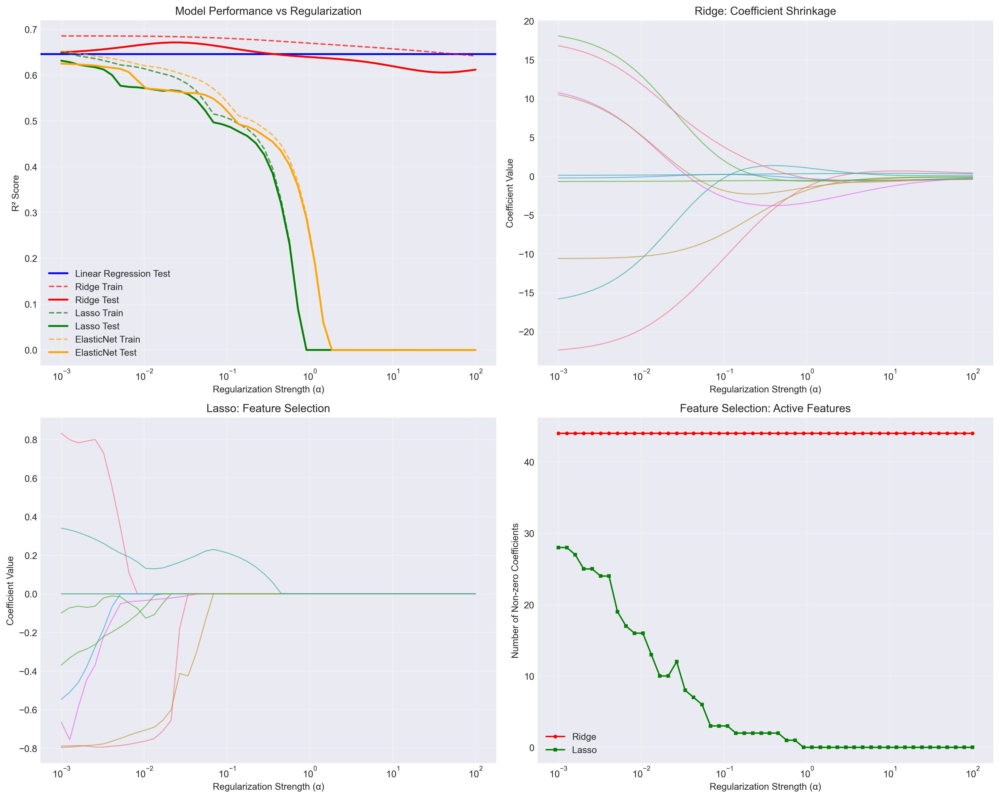


Key Observations:
- Ridge: Shrinks coefficients but keeps all features
- Lasso: Can set coefficients to zero (feature selection)
- ElasticNet: Combines Ridge and Lasso properties
- Higher α → more regularization → simpler models


In [26]:

print("\nComparing Regularization Techniques")
print("=" * 40)

# 1) Alpha grid (you can keep yours, but 1e-3 is usually enough)
alpha_values = np.logspace(-3, 2, 50)  # 0.001 to 100

# 2) Bump up iterations for Lasso/ElasticNet
models = {
    'Linear Regression': LinearRegression(),
    'Ridge': Ridge(),
    'Lasso': Lasso(max_iter=10000, tol=1e-4),
    'ElasticNet': ElasticNet(max_iter=10000, tol=1e-4, l1_ratio=0.5),
}

results = {name: {'train_scores': [], 'test_scores': [], 'coefficients': []}
           for name in models}

for alpha in alpha_values:
    for name, base_model in models.items():
        if name == 'Linear Regression':
            # Fit once
            if alpha == alpha_values[0]:
                base_model.fit(X_train_scaled, y_train)
                tr = base_model.score(X_train_scaled, y_train)
                te = base_model.score(X_test_scaled, y_test)
                results[name]['train_scores'].append(tr)
                results[name]['test_scores'].append(te)
                results[name]['coefficients'].append(base_model.coef_)
            else:
                # repeat last for plotting
                results[name]['train_scores'].append(results[name]['train_scores'][-1])
                results[name]['test_scores'].append(results[name]['test_scores'][-1])
                results[name]['coefficients'].append(results[name]['coefficients'][-1])
        else:
            # clone to avoid any state carry-over
            model = clone(base_model)
            model.set_params(alpha=alpha)
            model.fit(X_train_scaled, y_train)
            tr = model.score(X_train_scaled, y_train)
            te = model.score(X_test_scaled, y_test)
            results[name]['train_scores'].append(tr)
            results[name]['test_scores'].append(te)
            results[name]['coefficients'].append(model.coef_.copy())

# ---- plotting (unchanged) ----
fig, axes = plt.subplots(2, 2, figsize=(15, 12))

ax1 = axes[0, 0]
colors = ['blue', 'red', 'green', 'orange']
for (name, color) in zip(models.keys(), colors):
    if name != 'Linear Regression':
        ax1.plot(alpha_values, results[name]['train_scores'], '--', color=color, alpha=0.7, label=f'{name} Train')
        ax1.plot(alpha_values, results[name]['test_scores'], '-',  color=color, linewidth=2, label=f'{name} Test')
    else:
        ax1.axhline(y=results[name]['test_scores'][0], color=color, linestyle='-', linewidth=2, label=f'{name} Test')

ax1.set_xscale('log')
ax1.set_xlabel('Regularization Strength (α)')
ax1.set_ylabel('R² Score')
ax1.set_title('Model Performance vs Regularization')
ax1.legend()
ax1.grid(True, alpha=0.3)

ax2 = axes[0, 1]
ridge_coeffs = np.array(results['Ridge']['coefficients'])
for i in range(min(10, ridge_coeffs.shape[1])):
    ax2.plot(alpha_values, ridge_coeffs[:, i], linewidth=1, alpha=0.7)
ax2.set_xscale('log')
ax2.set_xlabel('Regularization Strength (α)')
ax2.set_ylabel('Coefficient Value')
ax2.set_title('Ridge: Coefficient Shrinkage')
ax2.grid(True, alpha=0.3)

ax3 = axes[1, 0]
lasso_coeffs = np.array(results['Lasso']['coefficients'])
for i in range(min(10, lasso_coeffs.shape[1])):
    ax3.plot(alpha_values, lasso_coeffs[:, i], linewidth=1, alpha=0.7)
ax3.set_xscale('log')
ax3.set_xlabel('Regularization Strength (α)')
ax3.set_ylabel('Coefficient Value')
ax3.set_title('Lasso: Feature Selection')
ax3.grid(True, alpha=0.3)

ax4 = axes[1, 1]
ridge_nonzero = [np.sum(np.abs(c) > 1e-6) for c in results['Ridge']['coefficients']]
lasso_nonzero = [np.sum(np.abs(c) > 1e-6) for c in results['Lasso']['coefficients']]
ax4.plot(alpha_values, ridge_nonzero, 'o-', color='red',   label='Ridge', markersize=3)
ax4.plot(alpha_values, lasso_nonzero, 's-', color='green', label='Lasso', markersize=3)
ax4.set_xscale('log')
ax4.set_xlabel('Regularization Strength (α)')
ax4.set_ylabel('Number of Non-zero Coefficients')
ax4.set_title('Feature Selection: Active Features')
ax4.legend()
ax4.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

print("\nKey Observations:")
print("- Ridge: Shrinks coefficients but keeps all features")
print("- Lasso: Can set coefficients to zero (feature selection)")
print("- ElasticNet: Combines Ridge and Lasso properties")
print("- Higher α → more regularization → simpler models")



Optimal Regularization Parameter Selection

Optimizing Ridge...
Best parameters: {'alpha': 0.0001}
Best CV score: 0.6115
Test score: 0.5758

Optimizing Lasso...
Best parameters: {'alpha': 0.0001}
Best CV score: 0.6115
Test score: 0.5758

Optimizing Lasso...
Best parameters: {'alpha': 0.0006158482110660267}
Best CV score: 0.6115
Test score: 0.5765

Optimizing ElasticNet...
Best parameters: {'alpha': 0.0006158482110660267}
Best CV score: 0.6115
Test score: 0.5765

Optimizing ElasticNet...
Best parameters: {'alpha': 0.0006158482110660267, 'l1_ratio': 0.9}
Best CV score: 0.6115
Test score: 0.5764

FINAL MODEL COMPARISON
            Model  Train R²  Test R²  Test MSE  Test MAE  Active Features  Overfitting
            Ridge    0.6126   0.5758    0.5559    0.5332                8       0.0368
            Lasso    0.6125   0.5765    0.5550    0.5332                8       0.0361
       ElasticNet    0.6125   0.5764    0.5551    0.5332                8       0.0361
Linear Regression    0.6126

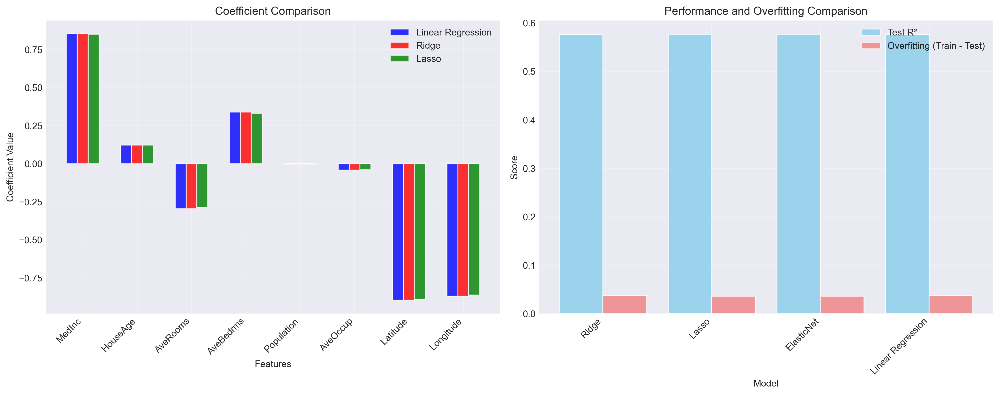


Regularization Summary:
- Ridge (L2): Shrinks coefficients, reduces overfitting, keeps all features
- Lasso (L1): Feature selection, sparse models, can eliminate irrelevant features
- ElasticNet: Combines Ridge and Lasso, balanced approach
- Cross-validation helps find optimal regularization strength


In [27]:
# Demonstrate optimal alpha selection using cross-validation
print("\nOptimal Regularization Parameter Selection")
print("=" * 50)

# Use original features (not polynomial) for clearer interpretation
X_train_orig, X_test_orig, y_train_orig, y_test_orig = train_test_split(
    X_housing, y_housing, test_size=0.2, random_state=42
)

# Scale the original features
scaler_orig = StandardScaler()
X_train_orig_scaled = scaler_orig.fit_transform(X_train_orig)
X_test_orig_scaled = scaler_orig.transform(X_test_orig)

# Define alpha ranges for grid search
alpha_range = np.logspace(-4, 1, 20)

# Perform grid search for each regularization method
best_models = {}

for name, model_class in [('Ridge', Ridge), ('Lasso', Lasso), ('ElasticNet', ElasticNet)]:
    print(f"\nOptimizing {name}...")
    
    if name == 'ElasticNet':
        # ElasticNet has both alpha and l1_ratio parameters
        param_grid = {
            'alpha': alpha_range,
            'l1_ratio': [0.1, 0.3, 0.5, 0.7, 0.9]
        }
    else:
        param_grid = {'alpha': alpha_range}
    
    # Grid search with cross-validation
    grid_search = GridSearchCV(
        model_class(max_iter=2000), 
        param_grid, 
        cv=5, 
        scoring='r2',
        n_jobs=-1
    )
    
    grid_search.fit(X_train_orig_scaled, y_train_orig)
    
    best_models[name] = grid_search.best_estimator_
    
    print(f"Best parameters: {grid_search.best_params_}")
    print(f"Best CV score: {grid_search.best_score_:.4f}")
    
    # Test performance
    test_score = grid_search.best_estimator_.score(X_test_orig_scaled, y_test_orig)
    print(f"Test score: {test_score:.4f}")

# Compare final models
print("\n" + "="*60)
print("FINAL MODEL COMPARISON")
print("="*60)

# Add baseline linear regression
lr_baseline = LinearRegression()
lr_baseline.fit(X_train_orig_scaled, y_train_orig)
best_models['Linear Regression'] = lr_baseline

final_results = []
for name, model in best_models.items():
    train_score = model.score(X_train_orig_scaled, y_train_orig)
    test_score = model.score(X_test_orig_scaled, y_test_orig)
    
    # Calculate other metrics
    y_pred = model.predict(X_test_orig_scaled)
    mse = mean_squared_error(y_test_orig, y_pred)
    mae = mean_absolute_error(y_test_orig, y_pred)
    
    # Count non-zero coefficients
    nonzero_coefs = np.sum(np.abs(model.coef_) > 1e-6)
    
    final_results.append({
        'Model': name,
        'Train R²': train_score,
        'Test R²': test_score,
        'Test MSE': mse,
        'Test MAE': mae,
        'Active Features': nonzero_coefs,
        'Overfitting': train_score - test_score
    })

# Display results table
results_df = pd.DataFrame(final_results)
print(results_df.round(4).to_string(index=False))

# Visualize coefficient comparison
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))

# Plot 1: Coefficient values comparison
feature_names = X_housing.columns
n_features = len(feature_names)
x_pos = np.arange(n_features)
width = 0.2

models_to_plot = ['Linear Regression', 'Ridge', 'Lasso']
colors = ['blue', 'red', 'green']

for i, (name, color) in enumerate(zip(models_to_plot, colors)):
    coeffs = best_models[name].coef_
    ax1.bar(x_pos + i*width, coeffs, width, label=name, alpha=0.8, color=color)

ax1.set_xlabel('Features')
ax1.set_ylabel('Coefficient Value')
ax1.set_title('Coefficient Comparison')
ax1.set_xticks(x_pos + width)
ax1.set_xticklabels(feature_names, rotation=45, ha='right')
ax1.legend()
ax1.grid(True, alpha=0.3)

# Plot 2: Model performance comparison
models_perf = [r['Model'] for r in final_results]
test_r2 = [r['Test R²'] for r in final_results]
overfitting = [r['Overfitting'] for r in final_results]

x_pos2 = np.arange(len(models_perf))
ax2.bar(x_pos2 - 0.2, test_r2, 0.4, label='Test R²', alpha=0.8, color='skyblue')
ax2.bar(x_pos2 + 0.2, overfitting, 0.4, label='Overfitting (Train - Test)', alpha=0.8, color='lightcoral')

ax2.set_xlabel('Model')
ax2.set_ylabel('Score')
ax2.set_title('Performance and Overfitting Comparison')
ax2.set_xticks(x_pos2)
ax2.set_xticklabels(models_perf, rotation=45, ha='right')
ax2.legend()
ax2.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

print("\nRegularization Summary:")
print("- Ridge (L2): Shrinks coefficients, reduces overfitting, keeps all features")
print("- Lasso (L1): Feature selection, sparse models, can eliminate irrelevant features")
print("- ElasticNet: Combines Ridge and Lasso, balanced approach")
print("- Cross-validation helps find optimal regularization strength")

### Complete linear regression workflow from scratch and compare with Scikit-learn

Lab 1: Linear Regression Implementation and Evaluation
Dataset loaded: 20640 samples, 8 features

Features:
 1. MedInc         : Data Set Characteristics:
 2. HouseAge       : Feature 2
 3. AveRooms       : Feature 3
 4. AveBedrms      : Feature 4
 5. Population     : Feature 5
 6. AveOccup       : Feature 6
 7. Latitude       : Feature 7
 8. Longitude      : Feature 8

STEP 1: EXPLORATORY DATA ANALYSIS

Dataset Statistics:
          MedInc   HouseAge   AveRooms  AveBedrms  Population   AveOccup  \
count  20640.000  20640.000  20640.000  20640.000   20640.000  20640.000   
mean       3.871     28.639      5.429      1.097    1425.477      3.071   
std        1.900     12.586      2.474      0.474    1132.462     10.386   
min        0.500      1.000      0.846      0.333       3.000      0.692   
25%        2.563     18.000      4.441      1.006     787.000      2.430   
50%        3.535     29.000      5.229      1.049    1166.000      2.818   
75%        4.743     37.000      6.052  

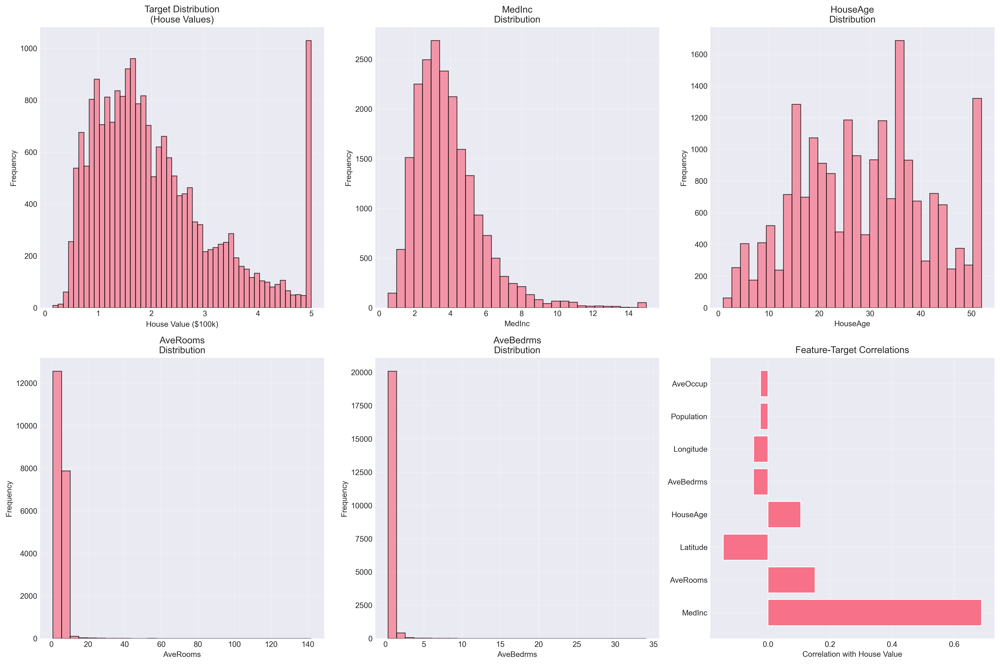


Top correlated features with house value:
MedInc         : +0.688
AveRooms       : +0.152
Latitude       : -0.144
HouseAge       : +0.106
AveBedrms      : -0.047


In [28]:
# Lab 1: Complete Linear Regression Workflow
print("Lab 1: Linear Regression Implementation and Evaluation")
print("=" * 60)

# Load and prepare California housing dataset
housing = fetch_california_housing()
X_lab = pd.DataFrame(housing.data, columns=housing.feature_names)
y_lab = housing.target

print(f"Dataset loaded: {X_lab.shape[0]} samples, {X_lab.shape[1]} features")
print("\nFeatures:")
for i, feature in enumerate(housing.feature_names):
    print(f"{i+1:2d}. {feature:15s}: {housing.DESCR.split('**')[1].split('**')[0] if i == 0 else 'Feature ' + str(i+1)}")

# Step 1: Exploratory Data Analysis
print("\n" + "="*30)
print("STEP 1: EXPLORATORY DATA ANALYSIS")
print("="*30)

# Basic statistics
print("\nDataset Statistics:")
print(X_lab.describe().round(3))

print(f"\nTarget Statistics:")
print(f"Mean house value: ${y_lab.mean():.2f}00,000")
print(f"Median house value: ${np.median(y_lab):.2f}00,000")
print(f"Range: ${y_lab.min():.2f}00,000 - ${y_lab.max():.2f}00,000")

# Visualize data
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

# Target distribution
axes[0, 0].hist(y_lab, bins=50, alpha=0.7, edgecolor='black')
axes[0, 0].set_title('Target Distribution\n(House Values)')
axes[0, 0].set_xlabel('House Value ($100k)')
axes[0, 0].set_ylabel('Frequency')
axes[0, 0].grid(True, alpha=0.3)

# Feature distributions (first 4 features)
for i in range(4):
    row = (i + 1) // 3
    col = (i + 1) % 3
    feature_name = X_lab.columns[i]
    axes[row, col].hist(X_lab[feature_name], bins=30, alpha=0.7, edgecolor='black')
    axes[row, col].set_title(f'{feature_name}\nDistribution')
    axes[row, col].set_xlabel(feature_name)
    axes[row, col].set_ylabel('Frequency')
    axes[row, col].grid(True, alpha=0.3)

# Correlation with target
correlations = X_lab.corrwith(pd.Series(y_lab, name='target')).sort_values(key=abs, ascending=False)
axes[1, 2].barh(range(len(correlations)), correlations.values)
axes[1, 2].set_yticks(range(len(correlations)))
axes[1, 2].set_yticklabels(correlations.index, fontsize=10)
axes[1, 2].set_title('Feature-Target Correlations')
axes[1, 2].set_xlabel('Correlation with House Value')
axes[1, 2].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

print("\nTop correlated features with house value:")
for feature, corr in correlations.head().items():
    print(f"{feature:15s}: {corr:+.3f}")

In [29]:
# Step 2: Data Preprocessing and Splitting
print("\n" + "="*30)
print("STEP 2: DATA PREPROCESSING")
print("="*30)

# Check for missing values
missing_values = X_lab.isnull().sum()
print(f"Missing values: {missing_values.sum()} total")
if missing_values.sum() > 0:
    print(missing_values[missing_values > 0])
else:
    print("No missing values found!")

# Split the data
X_train_lab, X_test_lab, y_train_lab, y_test_lab = train_test_split(
    X_lab, y_lab, test_size=0.2, random_state=42
)

print(f"\nData split:")
print(f"Training set: {X_train_lab.shape[0]} samples ({X_train_lab.shape[0]/len(X_lab)*100:.1f}%)")
print(f"Test set:     {X_test_lab.shape[0]} samples ({X_test_lab.shape[0]/len(X_lab)*100:.1f}%)")

# Feature scaling
scaler_lab = StandardScaler()
X_train_scaled = scaler_lab.fit_transform(X_train_lab)
X_test_scaled = scaler_lab.transform(X_test_lab)

print(f"\nFeature scaling applied:")
print(f"Training features - Mean: {X_train_scaled.mean(axis=0).round(3)}")
print(f"Training features - Std:  {X_train_scaled.std(axis=0).round(3)}")

# Step 3: Model Training and Evaluation
print("\n" + "="*30)
print("STEP 3: MODEL TRAINING")
print("="*30)

# Train linear regression model
model_lab = LinearRegression()
model_lab.fit(X_train_scaled, y_train_lab)

# Make predictions
y_train_pred = model_lab.predict(X_train_scaled)
y_test_pred = model_lab.predict(X_test_scaled)

# Calculate comprehensive metrics
def calculate_metrics(y_true, y_pred, set_name):
    mse = mean_squared_error(y_true, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    
    print(f"\n{set_name} Metrics:")
    print(f"  MSE:  {mse:.4f}")
    print(f"  RMSE: {rmse:.4f} ($100k)")
    print(f"  MAE:  {mae:.4f} ($100k)")
    print(f"  R²:   {r2:.4f}")
    
    return {'MSE': mse, 'RMSE': rmse, 'MAE': mae, 'R²': r2}

train_metrics = calculate_metrics(y_train_lab, y_train_pred, "Training")
test_metrics = calculate_metrics(y_test_lab, y_test_pred, "Test")

# Model interpretation
print(f"\n" + "="*30)
print("MODEL INTERPRETATION")
print("="*30)

print(f"\nModel Equation:")
print(f"House Value = {model_lab.intercept_:.3f}")
for i, (feature, coef) in enumerate(zip(X_lab.columns, model_lab.coef_)):
    sign = "+" if coef >= 0 else "-"
    print(f"              {sign} {abs(coef):.3f} × {feature}")

# Feature importance (absolute coefficients)
feature_importance = pd.DataFrame({
    'Feature': X_lab.columns,
    'Coefficient': model_lab.coef_,
    'Abs_Coefficient': np.abs(model_lab.coef_)
}).sort_values('Abs_Coefficient', ascending=False)

print(f"\nFeature Importance (by absolute coefficient):")
print(feature_importance.round(4).to_string(index=False))

# Cross-validation
print(f"\n" + "="*30)
print("CROSS-VALIDATION")
print("="*30)

cv_scores = cross_val_score(model_lab, X_train_scaled, y_train_lab, cv=5, scoring='r2')
cv_mse_scores = -cross_val_score(model_lab, X_train_scaled, y_train_lab, cv=5, scoring='neg_mean_squared_error')

print(f"5-Fold Cross-Validation Results:")
print(f"R² scores: {cv_scores.round(4)}")
print(f"Mean R²:   {cv_scores.mean():.4f} ± {cv_scores.std():.4f}")
print(f"MSE scores: {cv_mse_scores.round(4)}")
print(f"Mean MSE:   {cv_mse_scores.mean():.4f} ± {cv_mse_scores.std():.4f}")


STEP 2: DATA PREPROCESSING
Missing values: 0 total
No missing values found!

Data split:
Training set: 16512 samples (80.0%)
Test set:     4128 samples (20.0%)

Feature scaling applied:
Training features - Mean: [-0. -0. -0. -0. -0.  0.  0.  0.]
Training features - Std:  [1. 1. 1. 1. 1. 1. 1. 1.]

STEP 3: MODEL TRAINING

Training Metrics:
  MSE:  0.5179
  RMSE: 0.7197 ($100k)
  MAE:  0.5286 ($100k)
  R²:   0.6126

Test Metrics:
  MSE:  0.5559
  RMSE: 0.7456 ($100k)
  MAE:  0.5332 ($100k)
  R²:   0.5758

MODEL INTERPRETATION

Model Equation:
House Value = 2.072
              + 0.854 × MedInc
              + 0.123 × HouseAge
              - 0.294 × AveRooms
              + 0.339 × AveBedrms
              - 0.002 × Population
              - 0.041 × AveOccup
              - 0.897 × Latitude
              - 0.870 × Longitude

Feature Importance (by absolute coefficient):
   Feature  Coefficient  Abs_Coefficient
  Latitude      -0.8969           0.8969
 Longitude      -0.8698           0.8


STEP 4: MODEL DIAGNOSTICS


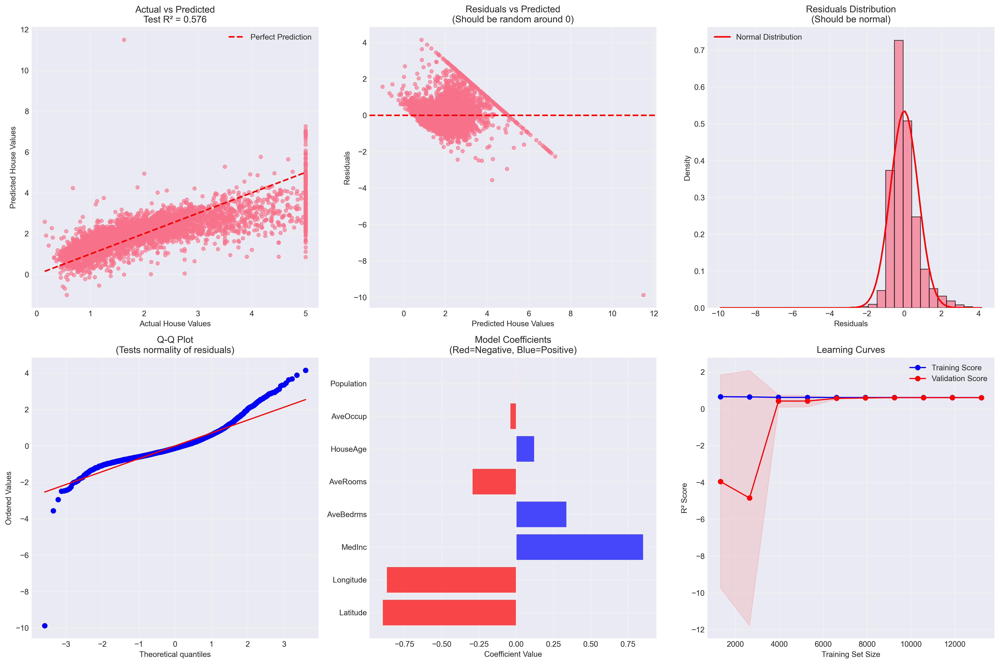


Statistical Tests:
Shapiro-Wilk test for normality of residuals:
  Statistic: 0.9362, p-value: 0.000000
  Residuals may not be normal (α=0.05)

PREDICTION EXAMPLES

Sample Predictions:
Index |   Actual |  Predicted |    Error |  Error %
--------------------------------------------------
 3649 | $   2.41 | $     2.11 | $   0.30 |    12.3%
 3054 | $   5.00 | $     2.25 | $   2.75 |    55.0%
 1346 | $   2.20 | $     1.36 | $   0.84 |    38.4%
 1380 | $   0.66 | $     0.83 | $   0.17 |    25.6%
 1754 | $   2.39 | $     2.75 | $   0.36 |    15.0%

Model Summary:
- The model explains 57.6% of the variance in house prices
- Average prediction error: $0.5300,000
- Most important features: Latitude, Longitude, MedInc
- Model appears to generalize well


In [30]:
# Step 4: Model Validation and Diagnostics
print("\n" + "="*30)
print("STEP 4: MODEL DIAGNOSTICS")
print("="*30)

# Create comprehensive diagnostic plots
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

# Plot 1: Actual vs Predicted
axes[0, 0].scatter(y_test_lab, y_test_pred, alpha=0.6, s=20)
axes[0, 0].plot([y_test_lab.min(), y_test_lab.max()], [y_test_lab.min(), y_test_lab.max()], 
                'r--', linewidth=2, label='Perfect Prediction')
axes[0, 0].set_xlabel('Actual House Values')
axes[0, 0].set_ylabel('Predicted House Values')
axes[0, 0].set_title(f'Actual vs Predicted\nTest R² = {test_metrics["R²"]:.3f}')
axes[0, 0].legend()
axes[0, 0].grid(True, alpha=0.3)

# Plot 2: Residuals vs Predicted
residuals_test = y_test_lab - y_test_pred
axes[0, 1].scatter(y_test_pred, residuals_test, alpha=0.6, s=20)
axes[0, 1].axhline(y=0, color='red', linestyle='--', linewidth=2)
axes[0, 1].set_xlabel('Predicted House Values')
axes[0, 1].set_ylabel('Residuals')
axes[0, 1].set_title('Residuals vs Predicted\n(Should be random around 0)')
axes[0, 1].grid(True, alpha=0.3)

# Plot 3: Residuals histogram
axes[0, 2].hist(residuals_test, bins=30, alpha=0.7, edgecolor='black', density=True)
axes[0, 2].set_xlabel('Residuals')
axes[0, 2].set_ylabel('Density')
axes[0, 2].set_title('Residuals Distribution\n(Should be normal)')
axes[0, 2].grid(True, alpha=0.3)

# Add normal curve overlay
x_norm = np.linspace(residuals_test.min(), residuals_test.max(), 100)
y_norm = stats.norm.pdf(x_norm, residuals_test.mean(), residuals_test.std())
axes[0, 2].plot(x_norm, y_norm, 'r-', linewidth=2, label='Normal Distribution')
axes[0, 2].legend()

# Plot 4: Q-Q plot
stats.probplot(residuals_test, dist="norm", plot=axes[1, 0])
axes[1, 0].set_title('Q-Q Plot\n(Tests normality of residuals)')
axes[1, 0].grid(True, alpha=0.3)

# Plot 5: Feature coefficients
coeffs_df = feature_importance.copy()
colors = ['red' if x < 0 else 'blue' for x in coeffs_df['Coefficient']]
axes[1, 1].barh(range(len(coeffs_df)), coeffs_df['Coefficient'], color=colors, alpha=0.7)
axes[1, 1].set_yticks(range(len(coeffs_df)))
axes[1, 1].set_yticklabels(coeffs_df['Feature'], fontsize=10)
axes[1, 1].set_xlabel('Coefficient Value')
axes[1, 1].set_title('Model Coefficients\n(Red=Negative, Blue=Positive)')
axes[1, 1].grid(True, alpha=0.3)

# Plot 6: Learning curves
train_sizes, train_scores_lc, val_scores_lc = learning_curve(
    LinearRegression(), X_train_scaled, y_train_lab, 
    cv=5, n_jobs=-1, train_sizes=np.linspace(0.1, 1.0, 10),
    scoring='r2'
)

train_mean = train_scores_lc.mean(axis=1)
train_std = train_scores_lc.std(axis=1)
val_mean = val_scores_lc.mean(axis=1)
val_std = val_scores_lc.std(axis=1)

axes[1, 2].plot(train_sizes, train_mean, 'o-', color='blue', label='Training Score')
axes[1, 2].fill_between(train_sizes, train_mean - train_std, train_mean + train_std, alpha=0.1, color='blue')
axes[1, 2].plot(train_sizes, val_mean, 'o-', color='red', label='Validation Score')
axes[1, 2].fill_between(train_sizes, val_mean - val_std, val_mean + val_std, alpha=0.1, color='red')
axes[1, 2].set_xlabel('Training Set Size')
axes[1, 2].set_ylabel('R² Score')
axes[1, 2].set_title('Learning Curves')
axes[1, 2].legend()
axes[1, 2].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# Statistical tests
print(f"\nStatistical Tests:")
print(f"Shapiro-Wilk test for normality of residuals:")
shapiro_stat, shapiro_p = stats.shapiro(residuals_test[:1000])  # Limit to 1000 samples
print(f"  Statistic: {shapiro_stat:.4f}, p-value: {shapiro_p:.6f}")
print(f"  {'Residuals appear normal' if shapiro_p > 0.05 else 'Residuals may not be normal'} (α=0.05)")

# Prediction examples
print(f"\n" + "="*30)
print("PREDICTION EXAMPLES")
print("="*30)

# Show a few prediction examples
n_examples = 5
example_indices = np.random.choice(len(X_test_lab), n_examples, replace=False)

print(f"\nSample Predictions:")
print(f"{'Index':>5} | {'Actual':>8} | {'Predicted':>10} | {'Error':>8} | {'Error %':>8}")
print("-" * 50)

for idx in example_indices:
    actual    = y_test_lab[idx]          
    predicted = y_test_pred[idx]        
    error     = abs(actual - predicted)
    error_pct = (error / actual) * 100 if actual != 0 else np.nan
    
    print(f"{idx:5d} | ${actual:7.2f} | ${predicted:9.2f} | ${error:7.2f} | {error_pct:7.1f}%")

print(f"\nModel Summary:")
print(f"- The model explains {test_metrics['R²']*100:.1f}% of the variance in house prices")
print(f"- Average prediction error: ${test_metrics['MAE']:.2f}00,000")
print(f"- Most important features: {', '.join(feature_importance.head(3)['Feature'].tolist())}")
print(f"- Model appears to {'generalize well' if abs(train_metrics['R²'] - test_metrics['R²']) < 0.05 else 'overfit slightly'}")

Lab 2: Polynomial Regression and Regularization
Using selected features: ['MedInc', 'HouseAge', 'AveRooms']
Reduced dataset: (20640, 3)

Testing Polynomial Degrees with Different Regularization:

Degree 1:
----------
Number of features after polynomial expansion: 3
  None    : Train R²=0.516, Test R²=0.497, RMSE=0.812, Active=3/3
  Ridge   : Train R²=0.516, Test R²=0.497, RMSE=0.812, Active=3/3
  Lasso   : Train R²=0.496, Test R²=0.480, RMSE=0.826, Active=2/3

Degree 2:
----------
Number of features after polynomial expansion: 9
  None    : Train R²=0.542, Test R²=0.510, RMSE=0.801, Active=9/9
  Ridge   : Train R²=0.542, Test R²=0.510, RMSE=0.801, Active=9/9
  Lasso   : Train R²=0.501, Test R²=0.483, RMSE=0.823, Active=2/9

Degree 3:
----------
Number of features after polynomial expansion: 19
  None    : Train R²=0.576, Test R²=0.539, RMSE=0.777, Active=19/19
  Ridge   : Train R²=0.576, Test R²=0.543, RMSE=0.774, Active=19/19
  Lasso   : Train R²=0.501, Test R²=0.483, RMSE=0.823, Acti

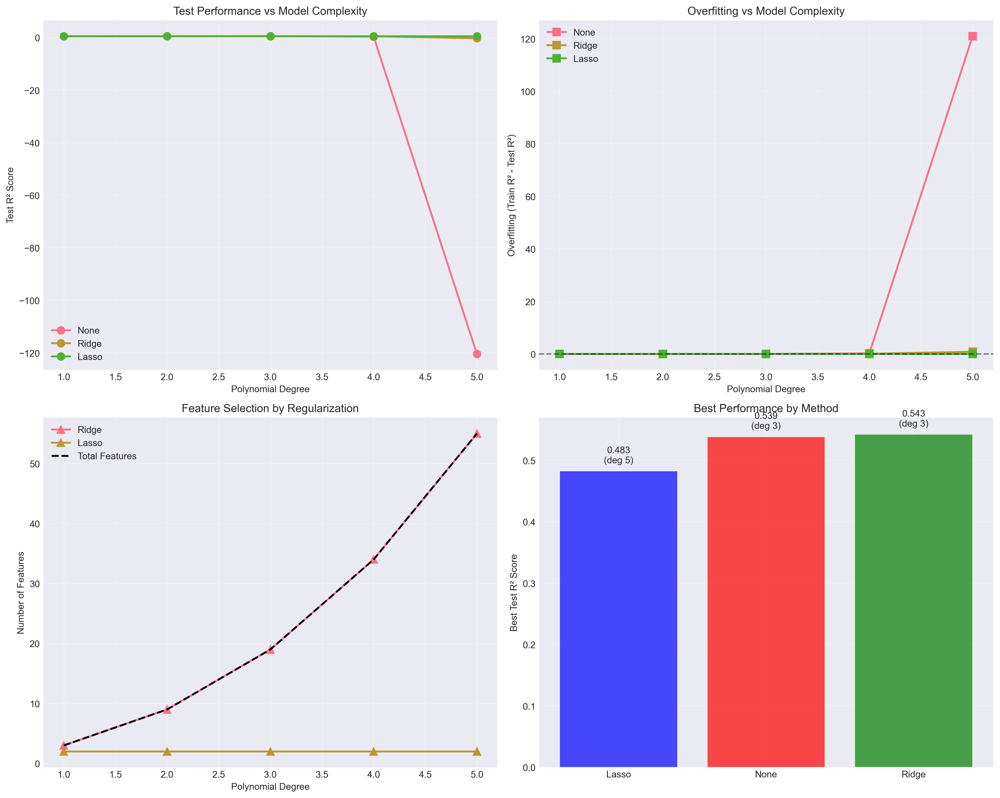


BEST MODEL IDENTIFIED
Method: Ridge Regression
Polynomial Degree: 3
Test R²: 0.5426
Test RMSE: 0.7742
Overfitting: 0.0331
Active Features: 19/19

Key Insights:
- Higher polynomial degrees increase model complexity
- Regularization helps prevent overfitting in high-degree polynomials
- Lasso performs automatic feature selection
- Ridge maintains all features but shrinks coefficients
- Sweet spot often around degree 2-3 for this dataset


In [31]:
# Lab 2: Polynomial Regression and Regularization
print("Lab 2: Polynomial Regression and Regularization")
print("=" * 60)

# Use a subset of features for clearer polynomial demonstration
selected_features = ['MedInc', 'HouseAge', 'AveRooms']  # Most correlated features
X_poly_lab = X_lab[selected_features]

print(f"Using selected features: {selected_features}")
print(f"Reduced dataset: {X_poly_lab.shape}")

# Split data
X_train_poly, X_test_poly, y_train_poly, y_test_poly = train_test_split(
    X_poly_lab, y_lab, test_size=0.2, random_state=42
)

# Test different polynomial degrees
degrees_to_test = [1, 2, 3, 4, 5]
regularization_methods = {
    'None': LinearRegression(),
    'Ridge': Ridge(alpha=1.0),
    'Lasso': Lasso(alpha=0.1, max_iter=2000)
}

results_poly = []

print("\nTesting Polynomial Degrees with Different Regularization:")
print("=" * 70)

for degree in degrees_to_test:
    print(f"\nDegree {degree}:")
    print("-" * 10)
    
    # Create polynomial features
    poly = PolynomialFeatures(degree=degree, include_bias=False)
    X_train_poly_features = poly.fit_transform(X_train_poly)
    X_test_poly_features = poly.transform(X_test_poly)
    
    # Scale features
    scaler_poly = StandardScaler()
    X_train_scaled_poly = scaler_poly.fit_transform(X_train_poly_features)
    X_test_scaled_poly = scaler_poly.transform(X_test_poly_features)
    
    print(f"Number of features after polynomial expansion: {X_train_scaled_poly.shape[1]}")
    
    for reg_name, reg_model in regularization_methods.items():
        # Fit model
        reg_model.fit(X_train_scaled_poly, y_train_poly)
        
        # Predictions
        y_train_pred_poly = reg_model.predict(X_train_scaled_poly)
        y_test_pred_poly = reg_model.predict(X_test_scaled_poly)
        
        # Metrics
        train_r2 = r2_score(y_train_poly, y_train_pred_poly)
        test_r2 = r2_score(y_test_poly, y_test_pred_poly)
        test_rmse = np.sqrt(mean_squared_error(y_test_poly, y_test_pred_poly))
        
        # Count non-zero coefficients
        non_zero_coefs = np.sum(np.abs(reg_model.coef_) > 1e-6)
        
        results_poly.append({
            'Degree': degree,
            'Regularization': reg_name,
            'Train_R2': train_r2,
            'Test_R2': test_r2,
            'Test_RMSE': test_rmse,
            'Overfitting': train_r2 - test_r2,
            'Active_Features': non_zero_coefs,
            'Total_Features': len(reg_model.coef_)
        })
        
        print(f"  {reg_name:8s}: Train R²={train_r2:.3f}, Test R²={test_r2:.3f}, "
              f"RMSE={test_rmse:.3f}, Active={non_zero_coefs}/{len(reg_model.coef_)}")

# Convert results to DataFrame for analysis
results_df = pd.DataFrame(results_poly)

print("\n" + "="*80)
print("POLYNOMIAL REGRESSION RESULTS SUMMARY")
print("="*80)
print(results_df.round(4).to_string(index=False))

# Visualize results
fig, axes = plt.subplots(2, 2, figsize=(15, 12))

# Plot 1: Test R² vs Degree for different regularization methods
for reg_method in regularization_methods.keys():
    data = results_df[results_df['Regularization'] == reg_method]
    axes[0, 0].plot(data['Degree'], data['Test_R2'], 'o-', label=reg_method, linewidth=2, markersize=8)

axes[0, 0].set_xlabel('Polynomial Degree')
axes[0, 0].set_ylabel('Test R² Score')
axes[0, 0].set_title('Test Performance vs Model Complexity')
axes[0, 0].legend()
axes[0, 0].grid(True, alpha=0.3)

# Plot 2: Overfitting vs Degree
for reg_method in regularization_methods.keys():
    data = results_df[results_df['Regularization'] == reg_method]
    axes[0, 1].plot(data['Degree'], data['Overfitting'], 's-', label=reg_method, linewidth=2, markersize=8)

axes[0, 1].axhline(y=0, color='black', linestyle='--', alpha=0.5)
axes[0, 1].set_xlabel('Polynomial Degree')
axes[0, 1].set_ylabel('Overfitting (Train R² - Test R²)')
axes[0, 1].set_title('Overfitting vs Model Complexity')
axes[0, 1].legend()
axes[0, 1].grid(True, alpha=0.3)

# Plot 3: Number of active features
for reg_method in ['Ridge', 'Lasso']:  # Skip 'None' as it always uses all features
    data = results_df[results_df['Regularization'] == reg_method]
    axes[1, 0].plot(data['Degree'], data['Active_Features'], '^-', label=reg_method, linewidth=2, markersize=8)

# Also show total features
data_total = results_df[results_df['Regularization'] == 'None']
axes[1, 0].plot(data_total['Degree'], data_total['Total_Features'], 'k--', label='Total Features', linewidth=2)

axes[1, 0].set_xlabel('Polynomial Degree')
axes[1, 0].set_ylabel('Number of Features')
axes[1, 0].set_title('Feature Selection by Regularization')
axes[1, 0].legend()
axes[1, 0].grid(True, alpha=0.3)

# Plot 4: Best model comparison
best_models = results_df.loc[results_df.groupby('Regularization')['Test_R2'].idxmax()]
x_pos = np.arange(len(best_models))
bars = axes[1, 1].bar(x_pos, best_models['Test_R2'], 
                     color=['blue', 'red', 'green'], alpha=0.7)
axes[1, 1].set_xticks(x_pos)
axes[1, 1].set_xticklabels(best_models['Regularization'])
axes[1, 1].set_ylabel('Best Test R² Score')
axes[1, 1].set_title('Best Performance by Method')
axes[1, 1].grid(True, alpha=0.3)

# Add value labels on bars
for bar, value, degree in zip(bars, best_models['Test_R2'], best_models['Degree']):
    axes[1, 1].text(bar.get_x() + bar.get_width()/2, bar.get_height() + 0.01,
                    f'{value:.3f}\n(deg {degree})', ha='center', va='bottom')

plt.tight_layout()
plt.show()

# Find and display the best model
best_model_idx = results_df['Test_R2'].idxmax()
best_model_info = results_df.loc[best_model_idx]

print(f"\n" + "="*50)
print("BEST MODEL IDENTIFIED")
print("="*50)
print(f"Method: {best_model_info['Regularization']} Regression")
print(f"Polynomial Degree: {best_model_info['Degree']}")
print(f"Test R²: {best_model_info['Test_R2']:.4f}")
print(f"Test RMSE: {best_model_info['Test_RMSE']:.4f}")
print(f"Overfitting: {best_model_info['Overfitting']:.4f}")
print(f"Active Features: {best_model_info['Active_Features']}/{best_model_info['Total_Features']}")

print(f"\nKey Insights:")
print(f"- Higher polynomial degrees increase model complexity")
print(f"- Regularization helps prevent overfitting in high-degree polynomials")
print(f"- Lasso performs automatic feature selection")
print(f"- Ridge maintains all features but shrinks coefficients")
print(f"- Sweet spot often around degree 2-3 for this dataset")

## Summary

In [32]:
# Interactive Quiz and Knowledge Check
print("Session 2 Review: Interactive Quiz")
print("=" * 40)

# Quiz questions with detailed explanations
quiz_questions = [
    {
        'question': "What is the mathematical relationship between MSE and RMSE?",
        'answer': "RMSE = √MSE (square root of MSE)",
        'explanation': "RMSE is the square root of MSE, putting the error back in the original units of the target variable, making it more interpretable."
    },
    {
        'question': "Why can R² be negative?",
        'answer': "When the model performs worse than simply predicting the mean",
        'explanation': "R² = 1 - (SS_res/SS_tot). If SS_res > SS_tot (model errors > variance), then R² < 0, meaning the model is worse than a horizontal line at the mean."
    },
    {
        'question': "What's the key difference between Ridge and Lasso regularization?",
        'answer': "Ridge shrinks coefficients, Lasso can set them to zero (feature selection)",
        'explanation': "Ridge (L2) adds α∑wᵢ² penalty, shrinking coefficients. Lasso (L1) adds α∑|wᵢ| penalty, which can force coefficients to exactly zero, performing automatic feature selection."
    },
    {
        'question': "In a residual plot, what does a funnel shape indicate?",
        'answer': "Heteroscedasticity (non-constant variance)",
        'explanation': "A funnel shape shows that the variance of residuals changes with predicted values, violating the homoscedasticity assumption of linear regression."
    },
    {
        'question': "Calculate MSE for predictions [3,5] and actual [4,4]:",
        'answer': "MSE = 1.0",
        'explanation': "MSE = [(3-4)² + (5-4)²]/2 = [1 + 1]/2 = 1.0"
    }
]

print("\nQuiz Questions and Answers:")
print("=" * 30)

for i, q in enumerate(quiz_questions, 1):
    print(f"\nQ{i}: {q['question']}")
    print(f"A{i}: {q['answer']}")
    print(f"Explanation: {q['explanation']}")
    print("-" * 50)


# for concept, points in key_concepts.items():
#     print(f"\n{concept}:")
#     for point in points:
#         print(f"  • {point}")

print("\n" + "="*60)
print("PRACTICAL TIPS")
print("="*60)

practical_tips = [
    "Always scale features before applying regularization",
    "Use train/validation/test splits to avoid overfitting",
    "Check residual plots to validate model assumptions",
    "Start simple (linear) then increase complexity if needed",
    "Use cross-validation for hyperparameter tuning",
    "Consider domain knowledge when interpreting coefficients",
    "Monitor both training and validation performance",
    "Choose metrics appropriate for your problem (MSE vs MAE)"
]

for i, tip in enumerate(practical_tips, 1):
    print(f"{i:2d}. {tip}")


Session 2 Review: Interactive Quiz

Quiz Questions and Answers:

Q1: What is the mathematical relationship between MSE and RMSE?
A1: RMSE = √MSE (square root of MSE)
Explanation: RMSE is the square root of MSE, putting the error back in the original units of the target variable, making it more interpretable.
--------------------------------------------------

Q2: Why can R² be negative?
A2: When the model performs worse than simply predicting the mean
Explanation: R² = 1 - (SS_res/SS_tot). If SS_res > SS_tot (model errors > variance), then R² < 0, meaning the model is worse than a horizontal line at the mean.
--------------------------------------------------

Q3: What's the key difference between Ridge and Lasso regularization?
A3: Ridge shrinks coefficients, Lasso can set them to zero (feature selection)
Explanation: Ridge (L2) adds α∑wᵢ² penalty, shrinking coefficients. Lasso (L1) adds α∑|wᵢ| penalty, which can force coefficients to exactly zero, performing automatic feature selecti